### The IDEAS project is supported via NASA's Earth Science Technology Office (ESTO) from the Advanced Information Systems Technology (AIST) Program

# Integrated Digital Earth Analysis System (IDEAS) API Demonstration

This notebook highlights some of the analytics and visualization capabilities of IDEAS with four use cases:
- Pakistan flooding occurring from June through September, 2022
- Hurricane Ian as it makes landfall over Florida in September, 2022
- France storm in January 2022
- LIS NoahMP model data over the Mississippi river basin in January, 2020

Also present in this notebook is LIS NoahMP and LIS VIC data for the Mississippi and Garonne Rivers as well as RAPID data for the Mississippi

## Libraries

The following libraries are needed to support accessing IDEAS API. The functions called in this notebook are in the `ideas_modules` folder

### Libraries

In [4]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import requests
from datetime import datetime, timedelta
import pandas as pd
import json
from shapely.geometry import box
from tabulate import tabulate
from IPython.display import Image
from owslib.util import Authentication
from owslib.wms import WebMapService
from PIL import Image as I
from PIL import ImageDraw
import numpy as np

import ideas_modules.plotting as plotting
import ideas_modules.ideas_processing as ideas_processing

## Data Inventory
The base url, https://ideas-digitaltwin.jpl.nasa.gov/nexus, is the entry point to access IDEAS API. In the following code snipet, it is used in conjunction with list endpoint to get a list of datasets.

In [5]:
BASE_URL = 'https://ideas-digitaltwin.jpl.nasa.gov'
NEXUS_URL = f'{BASE_URL}/nexus'
STAC_URL = f'{BASE_URL}/stac-api'

In [6]:
ideas_datasets = [
    'LIS-ESoil-tavg',
    'SPL3SMP_AM_soil_moisture',
    'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed',
    'GLDAS_VIC10_3H_2_1_global_Qs_acc',
    'GLDAS_VIC10_3H_2_1_global_Qsb_acc',
    'GLDAS_NOAH10_3H_2_1_global_Qs_acc',
    'GLDAS_NOAH10_3H_2_1_global_Qsb_acc',
    'GLDAS_CLSM10_3H_2_1_global_Qs_acc',
    'GLDAS_CLSM10_3H_2_1_global_Qsb_acc',
    'LIS_gar_1x_Qs_tavg',
    'LIS_gar_1x_Qsb_tavg',
    'LIS_miss_1x_Qs_tavg',
    'LIS_miss_1x_Qsb_tavg'
]

url = f'{NEXUS_URL}/list'
print('url\n', url); print()
r = requests.get(url, verify=False).json()
inventories = pd.DataFrame(r)[['title', 'iso_start', 'iso_end']]
inventories.sort_values('title')
print(tabulate( inventories[ inventories['title'].isin(ideas_datasets) ], headers="keys", showindex=False ))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/list

title                                                      iso_start                 iso_end
---------------------------------------------------------  ------------------------  ------------------------
GLDAS_CLSM10_3H_2_1_global_Qs_acc                          2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GLDAS_CLSM10_3H_2_1_global_Qsb_acc                         2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GLDAS_NOAH10_3H_2_1_global_Qs_acc                          2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GLDAS_NOAH10_3H_2_1_global_Qsb_acc                         2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GLDAS_VIC10_3H_2_1_global_Qs_acc                           2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GLDAS_VIC10_3H_2_1_global_Qsb_acc                          2018-10-01T00:00:00+0000  2022-03-01T21:00:00+0000
GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed  2018-10-01T00:00:00+00

## STAC API

In [7]:
url = f'{STAC_URL}/edge_collections'
print('url\n', url); print()
r = requests.get(url, verify=False).json()

collections = r['collections']
print(len(collections), 'collections found')

url
 https://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections

17 collections found


In [8]:
gpm_collection = collections[0]
gpm_collection

{'type': 'Collection',
 'id': 'GPM-3IMERGHHR-06-daily-global-precipitationCal',
 'stac_version': '1.0.0',
 'description': 'GPM-3IMERGHHR-06-daily-global-precipitationCal',
 'links': [{'rel': 'self',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal',
   'type': 'application/json'},
  {'rel': 'parent',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/',
   'type': 'application/json'},
  {'rel': 'root',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/',
   'type': 'application/json',
   'title': 'Root URL'}],
 'stac_extensions': [],
 'title': 'GPM IMERG Final Precipitation L3 V06',
 'extent': {'spatial': {'bbox': [[0, 0, 0, 0]]},
  'temporal': {'interval': [['2000-06-01T00:00:00Z', None]]}},
 'license': 'proprietary'}

### GPM Collection in STAC

In [9]:
url = [link['href'] for link in gpm_collection['links'] if link['rel'] == 'self'][0]

print('url\n', url); print()
gpm_collection_stac = requests.get(url, verify=False).json()
for k in ['type', 'title', 'description', 'links']:
    print(f'{k}: ', json.dumps(gpm_collection_stac[k], indent=2))

url
 http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal

type:  "Collection"
title:  "GPM IMERG Late Precipitation L3 1 day 0.1 degree x 0.1 degree V06 (GPM_3IMERGDL) at GES DISC"
description:  "The Integrated Multi-satellitE Retrievals for GPM (IMERG) is the unified U.S. algorithm that provides the multi-satellite precipitation product for the U.S. GPM team.Version 06 is the current version of the data set. Older versions will no longer be available and have been superseded by Version 06.This dataset is the GPM Level 3 IMERG  Late Daily  10 x 10 km (GPM_3IMERGDL) derived from the half-hourly GPM_3IMERGHHL. The derived result represents a Late expedited estimate of the daily accumulated precipitation. The dataset is produced at the NASA Goddard Earth Sciences (GES) Data and Information Services Center (DISC) by simply summing the valid precipitation retrievals for the day in GPM_3IMERGHHL and giving the result in (mm). The lat

### GPM STAC Item

In [10]:
url = [link['href'] for link in gpm_collection_stac['links'] if link['rel'] == 'items'][0]

print('url\n', url); print()
gpm_items_stac = requests.get(url, verify=False).json()
print(f'{len(gpm_items_stac["features"])} items found in GPM collection')

url
 http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal/items

2000 items found in GPM collection


In [11]:
gpm_items_stac["features"][0]

{'type': 'Feature',
 'stac_version': '1.0.0',
 'id': '3B-DAY-L.MS.MRG.3IMERG.20030205-S000000-E235959.V06',
 'properties': {'start_datetime': '2003-02-05T00:00:00+00:00',
  'end_datetime': '2003-02-05T23:59:59.999000+00:00',
  'datetime': None},
 'geometry': None,
 'links': [{'rel': 'parent',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal',
   'type': 'application/json'},
  {'rel': 'root',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/',
   'type': 'application/json',
   'title': 'Root URL'}],
 'assets': {'data': {'href': 'https://gpm1.gesdisc.eosdis.nasa.gov/data/GPM_L3/GPM_3IMERGDL.06/2003/02/3B-DAY-L.MS.MRG.3IMERG.20030205-S000000-E235959.V06.nc4',
   'title': 'Data Access GET DATA'}},
 'bbox': [-180.0, -90.0, 180.0, 90.0],
 'stac_extensions': [],
 'collection': 'GPM-3IMERGHHR-06-daily-global-precipitationCal'}

## IDEAS API

### API List
The capabilities endpoint is used get a list of API offered by IDEAS.

In [12]:
url = f'{NEXUS_URL}/capabilities'
print('url\n', url); print()

r = requests.get(url, verify=False).json()
apis = pd.DataFrame(r)[['name', 'path', 'description']]
apis.sort_values('name')

print(tabulate(apis, headers="keys", showindex=False))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/capabilities

name                                        path                           description
------------------------------------------  -----------------------------  --------------------------------------------------------------------------------------------------------------------
Capabilities                                /capabilities                  Lists the current capabilities of this Nexus system
Correlation Map                             /correlationMap                Computes a correlation map between two datasets given an arbitrary geographical area and time range
Daily Difference Average                    /dailydifferenceaverage        Subtracts data in box in Dataset 1 from Dataset 2, then averages the difference per day.
Data In-Bounds Search                       /datainbounds                  Fetches point values for a given dataset and geographical area
Dataset List                                /list    

# Pakistan Flood 2022

Find the peak of the flood using GPM precipitation data and visualize it.

- data set: GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed
- spatial bounds:  63, 23, 75, 33
- temporal bounds: 2022-06-01 to 2022-09-25
- area of interest: Pakistan

In [13]:
bb_pakistan_flood       = {'min_lon': 66, 'max_lon': 75, 'min_lat': 23, 'max_lat': 35}
start_pakistan_flood    = datetime(2022, 6, 1)
end_pakistan_flood      = datetime(2022, 9, 25)
global_precipitation_dataset  = 'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed'
pakistan_parameters = (NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, start_pakistan_flood, end_pakistan_flood)

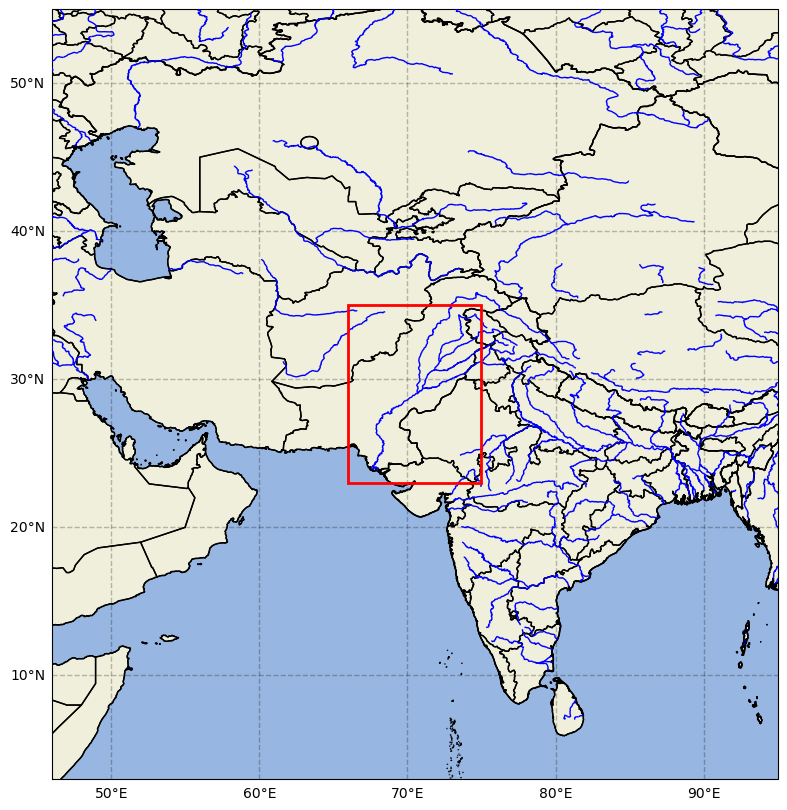

In [14]:
plotting.map_box(bb_pakistan_flood)

#### GPM Mean From 2022-08-01 to 2022-09-25

In [15]:
pakistan_timeseries = ideas_processing.spatial_timeseries(*pakistan_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=66&minLat=23&maxLon=75&maxLat=35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.431567208026536 seconds


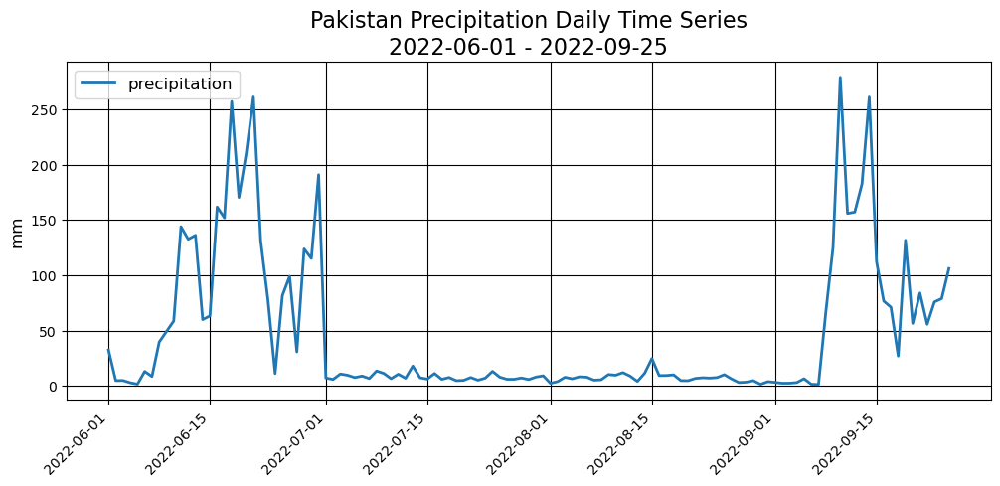

In [16]:
title = f'Pakistan Precipitation Daily Time Series\n{str(start_pakistan_flood)[:10]} - {str(end_pakistan_flood)[:10]}'
plotting.timeseries_plot([(pakistan_timeseries['maximum'], 'precipitation')], '', 'mm', title)

**For more context, in the 2021 water year (October 1st 2020 to Sept 30th 2021), the state of California received about 300 mm of precipitation. This is only slightly more than the precipitation Pakistan was receiving some days during the floods.**

#### Data Subsetting

Fetches point values for a given dataset and geographical area.

In [17]:
pakistan_date = datetime(2022, 9, 12)
pakistan_subset_data = ideas_processing.data_subsetting(NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, pakistan_date, pakistan_date)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=66,23,75,35&startTime=2022-09-12T00:00:00Z&endTime=2022-09-12T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.8061209589941427 seconds


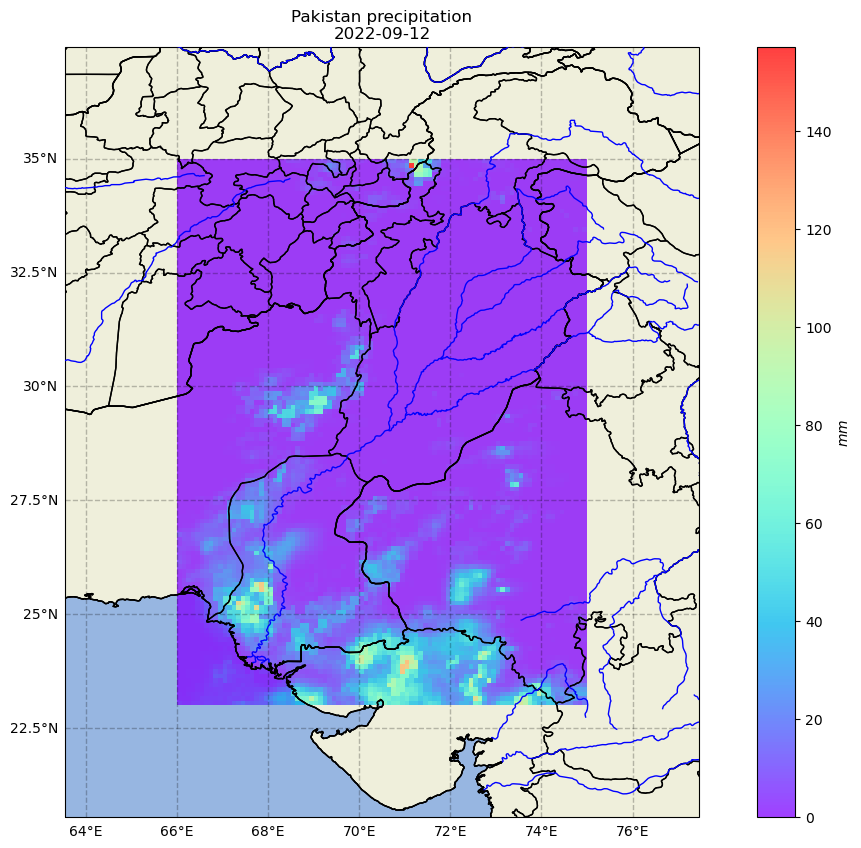

In [18]:
plotting.map_data(pakistan_subset_data[0], f'Pakistan precipitation\n{str(pakistan_date)[:10]}', cb_label="$mm$")

#### IDEAS WMS Visual GPM Precipitation 2022-09-12

In [19]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(66,23,75,35),  # Bounds
                 size=(500, 500),  # Image size
                 time='2022-09-12',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

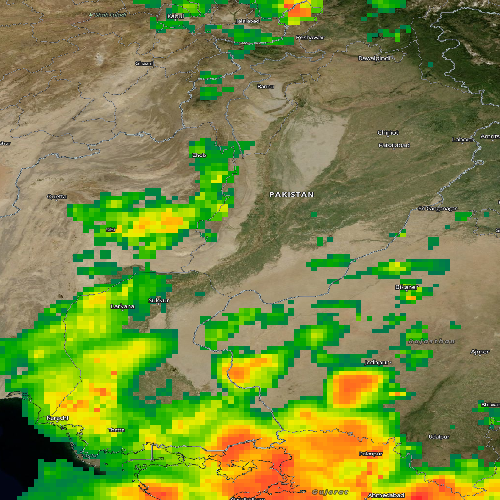

In [20]:
# View image
Image(img.read())

#### IDEAS WMS Animation 2022-08-01 to 2022-09-30

In [21]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 8, 1)
edate = datetime(2022, 9, 30)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(66,23,75,35),  # Bounds
                     size=(500,500),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

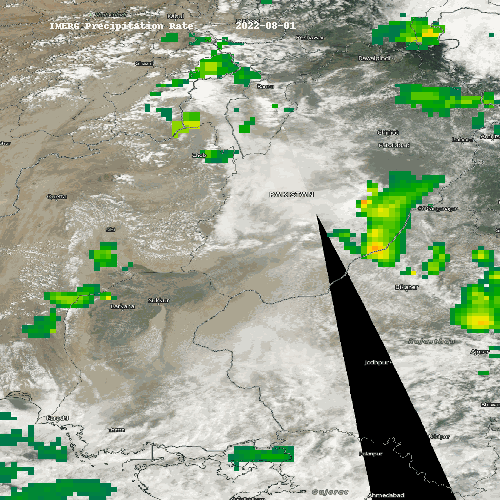

In [22]:
Image('IMERG_Precipitation_Rate.gif')

#### Temporal Mean

Computes a Latitude/Longitude Time Average plot given an arbitrary geographical area and time range

In [23]:
pakistan_timeavg_data = ideas_processing.temporal_mean(*pakistan_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=66,23,75,35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z

Waiting for response from IDEAS... took 26.695416374946944 seconds


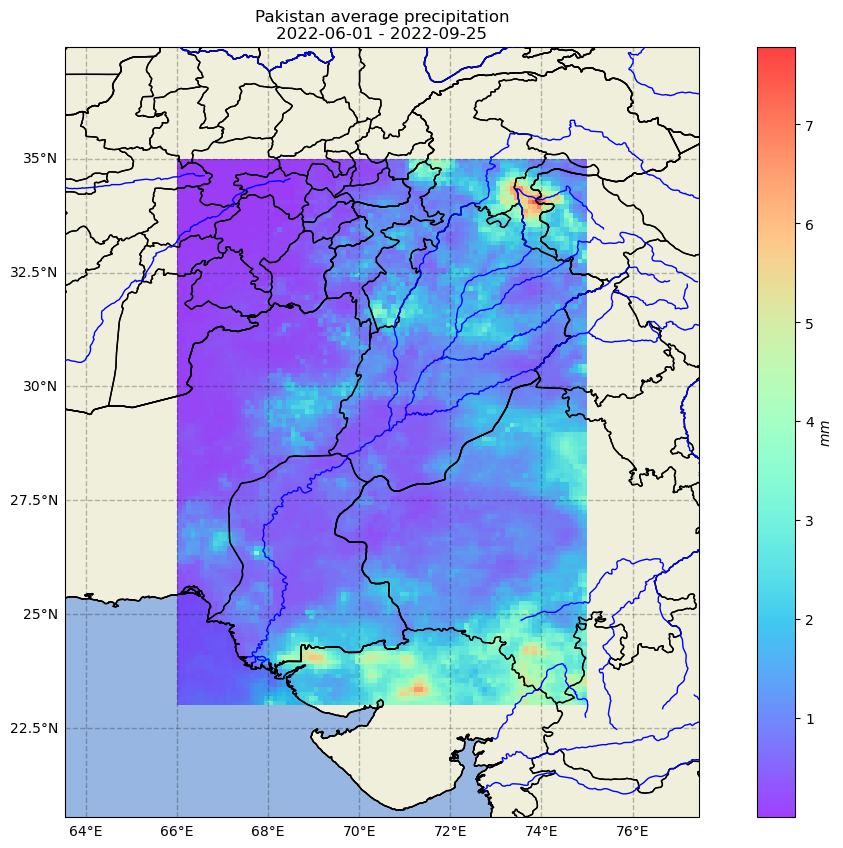

In [24]:
pakistan_timeavg_title = f'Pakistan average precipitation\n{str(start_pakistan_flood)[:10]} - {str(end_pakistan_flood)[:10]}'
plotting.map_data(pakistan_timeavg_data, pakistan_timeavg_title, cb_label='$mm$')

#### Maxima and Minima Map

Computes a map of maxmima and minima of a field given an arbitrary geographical area and time range.

In [25]:
pakistan_max_min_data = ideas_processing.max_min_map_spark(*pakistan_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/maxMinMapSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=66,23,75,35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z

Waiting for response from IDEAS... took 79.99701650009956 seconds


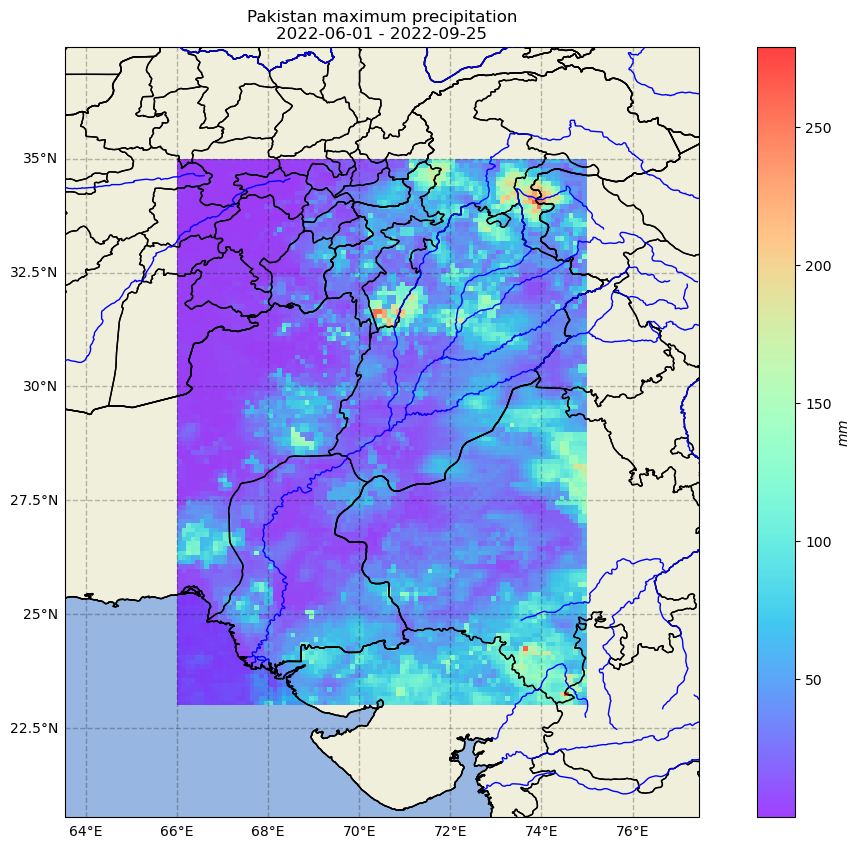

In [26]:
pakistan_max_title = f'Pakistan maximum precipitation\n{str(start_pakistan_flood)[:10]} - {str(end_pakistan_flood)[:10]}'
plotting.map_data(pakistan_max_min_data.maxima, pakistan_max_title, cb_label='$mm$')

#### Temporal Variance

Computes a map of the temporal variance of a field given an arbitrary geographical area and time range.

In [27]:
pakistan_variance_data = ideas_processing.temporal_variance(*pakistan_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/varianceSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=66&minLat=23&maxLon=75&maxLat=35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z

Waiting for response from IDEAS... took 9.164180583087727 seconds


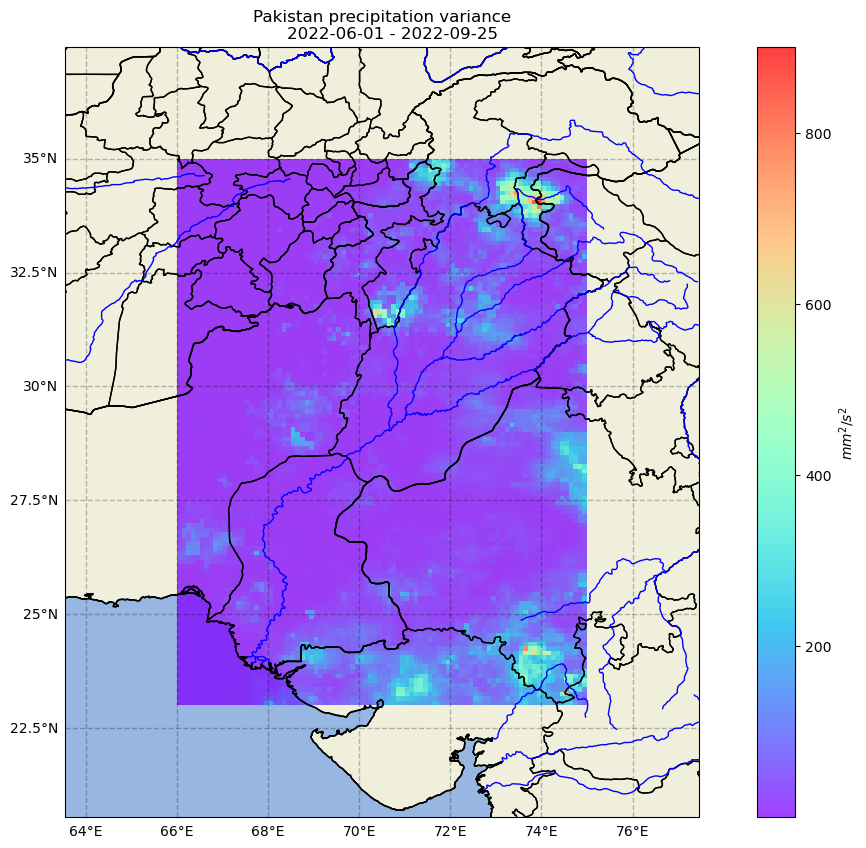

In [28]:
pakistan_variance_title = f'Pakistan precipitation variance\n\
    {str(start_pakistan_flood)[:10]} - {str(end_pakistan_flood)[:10]}'
plotting.map_data(pakistan_variance_data, pakistan_variance_title, cb_label='$mm^2/s^2$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [29]:
global_precipitation_computed_climatology = 'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed_clim'
pakistan_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_pakistan_flood, start_pakistan_flood, end_pakistan_flood)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&climatology=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed_clim&b=66,23,75,35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z

Waiting for response from IDEAS... took 15.90873320796527 seconds


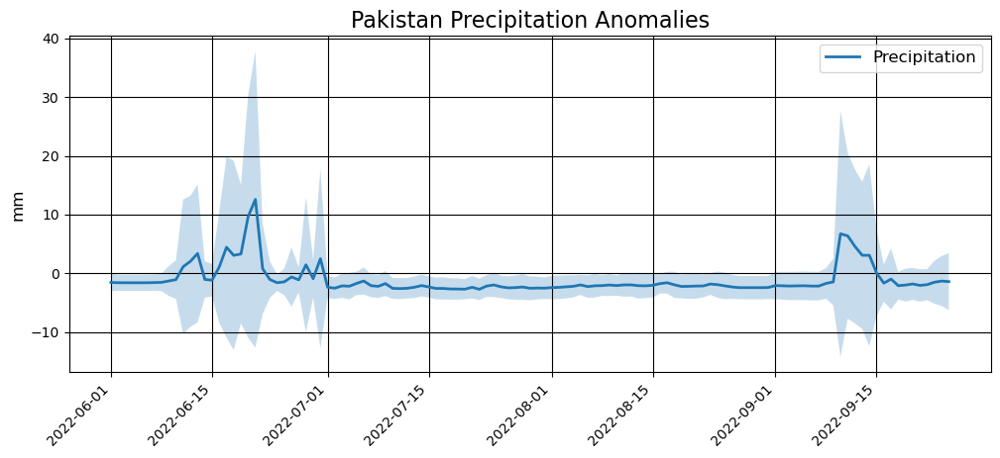

In [30]:
plotting.timeseries_bands_plot(pakistan_daily_diff_data, 'Precipitation', '', 'mm', 'Pakistan Precipitation Anomalies')

# Hurricane Ian Florida Landfall

In [31]:
bb_hurricane_ian      = {'min_lon': -87, 'max_lon': -72, 'min_lat': 18, 'max_lat': 35}
start_hurricane_ian   = datetime(2022, 9, 24)
end_hurricane_ian     = datetime(2022, 10, 2)
ian_parameters = (NEXUS_URL, global_precipitation_dataset, bb_hurricane_ian, start_hurricane_ian, end_hurricane_ian)

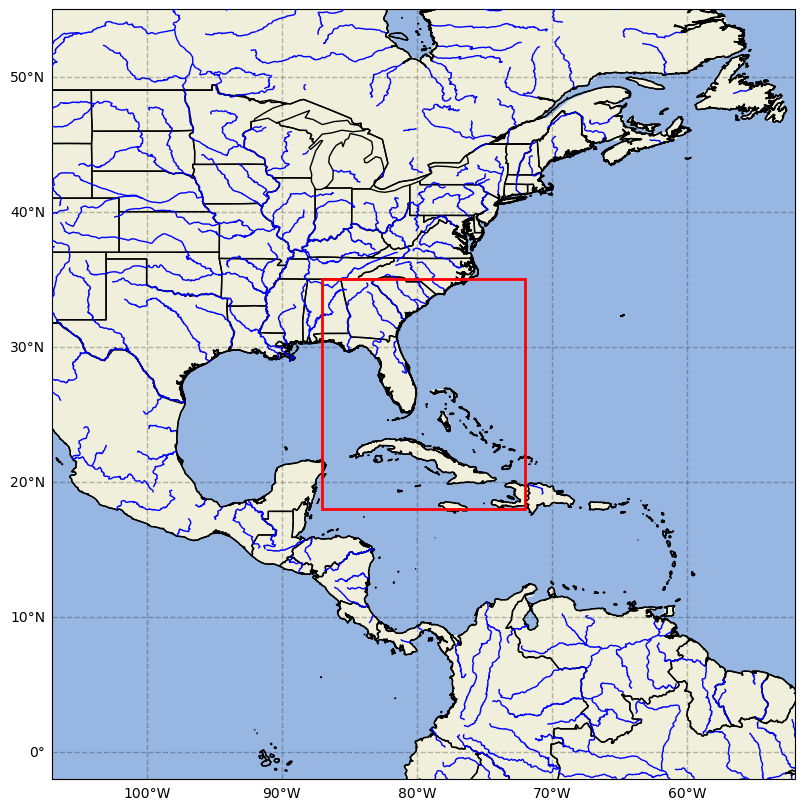

In [32]:
# Plot a box around our spatial bounds
plotting.map_box(bb_hurricane_ian)

In [33]:
ian_timeseries = ideas_processing.spatial_timeseries(*ian_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=-87&minLat=18&maxLon=-72&maxLat=35&startTime=2022-09-24T00:00:00Z&endTime=2022-10-02T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.9879464579280466 seconds


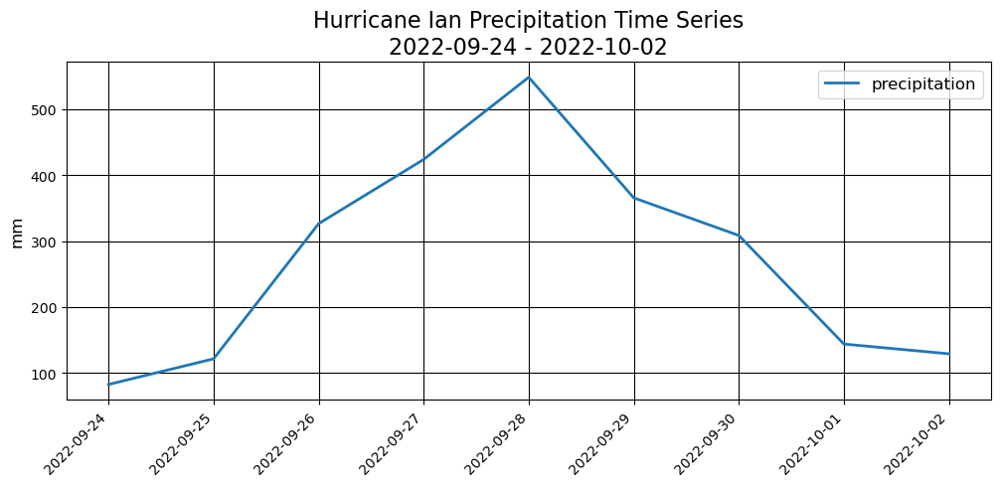

In [34]:
ian_title = f'Hurricane Ian Precipitation Time Series\n{str(start_hurricane_ian)[:10]} - {str(end_hurricane_ian)[:10]}'
plotting.timeseries_plot([(ian_timeseries.maximum, 'precipitation')], '', 'mm', ian_title)

In [35]:
ian_start = datetime(2022,9,25)
ian_end = datetime(2022,10,1)
ian_precipitation_data = ideas_processing.temporal_mean(NEXUS_URL, global_precipitation_dataset, bb_hurricane_ian, ian_start, ian_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=-87,18,-72,35&startTime=2022-09-25T00:00:00Z&endTime=2022-10-01T00:00:00Z

Waiting for response from IDEAS... took 4.2686192920664325 seconds


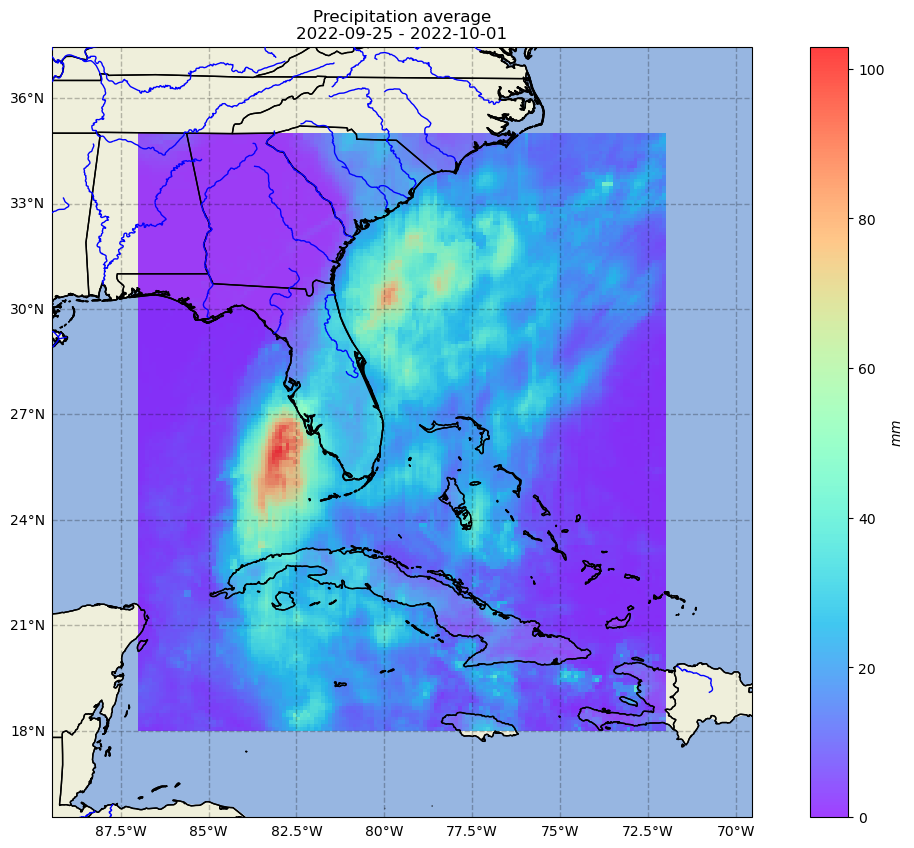

In [36]:
ian_title = f'Precipitation average\n{str(ian_start)[:10]} - {str(ian_end)[:10]}'
plotting.map_data(ian_precipitation_data, ian_title, cb_label='$mm$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [37]:
ian_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_hurricane_ian, start_hurricane_ian, end_hurricane_ian)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&climatology=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed_clim&b=-87,18,-72,35&startTime=2022-09-24T00:00:00Z&endTime=2022-10-02T00:00:00Z

Waiting for response from IDEAS... took 2.6261598750716075 seconds


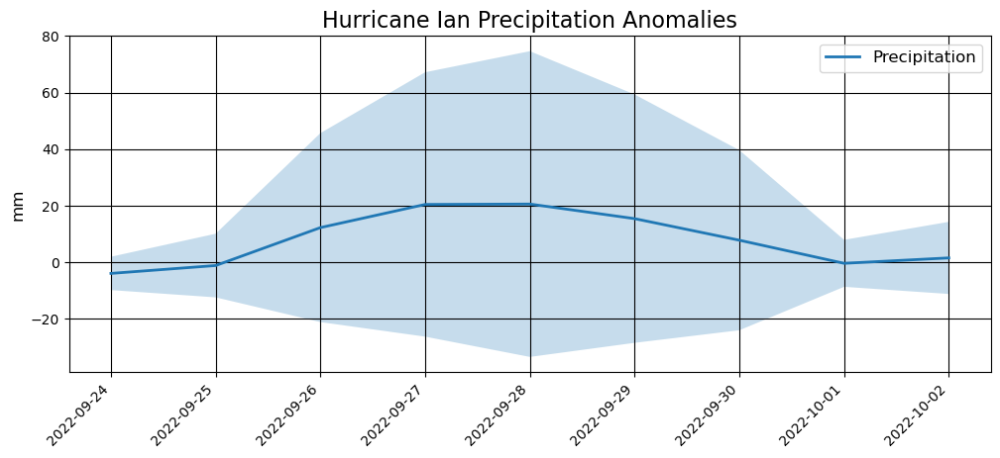

In [38]:
plotting.timeseries_bands_plot(ian_daily_diff_data, 'Precipitation', '', 'mm', 'Hurricane Ian Precipitation Anomalies')

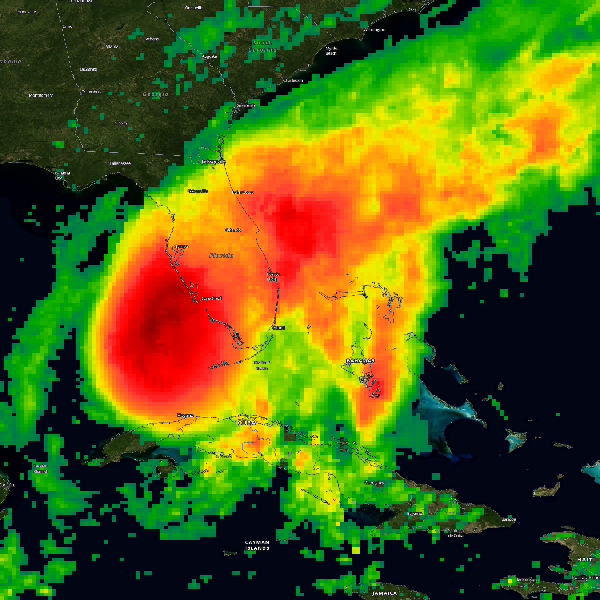

In [39]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(-87, 18, -72, 35),  # Bounds
                 size=(600, 600),  # Image size
                 time='2022-09-28',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('IMERG_Precipitation_Rate_2022-09-28.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('IMERG_Precipitation_Rate_2022-09-28.png')

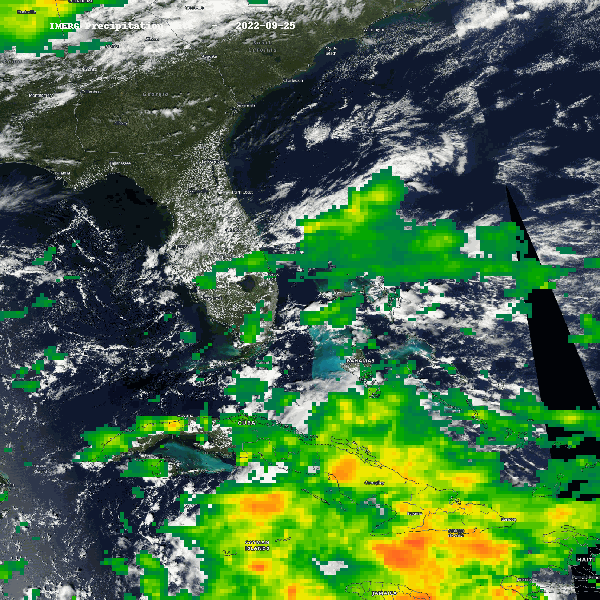

In [40]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 9, 25)
edate = datetime(2022, 10, 1)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(-87, 18, -72, 35),  # Bounds
                     size=(600,600),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate_Ian.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

Image('IMERG_Precipitation_Rate_Ian.gif')

# France storm 2021-12-31 - 2022-01-31

In [41]:
bb_france      = {'min_lon': -4.297, 'max_lon': 4.324, 'min_lat': 41.662, 'max_lat': 48.845}
start_france   = datetime(2021, 12, 31)
end_france     = datetime(2022, 1, 31)
france_parameters = (NEXUS_URL, global_precipitation_dataset, bb_france, start_france, end_france)

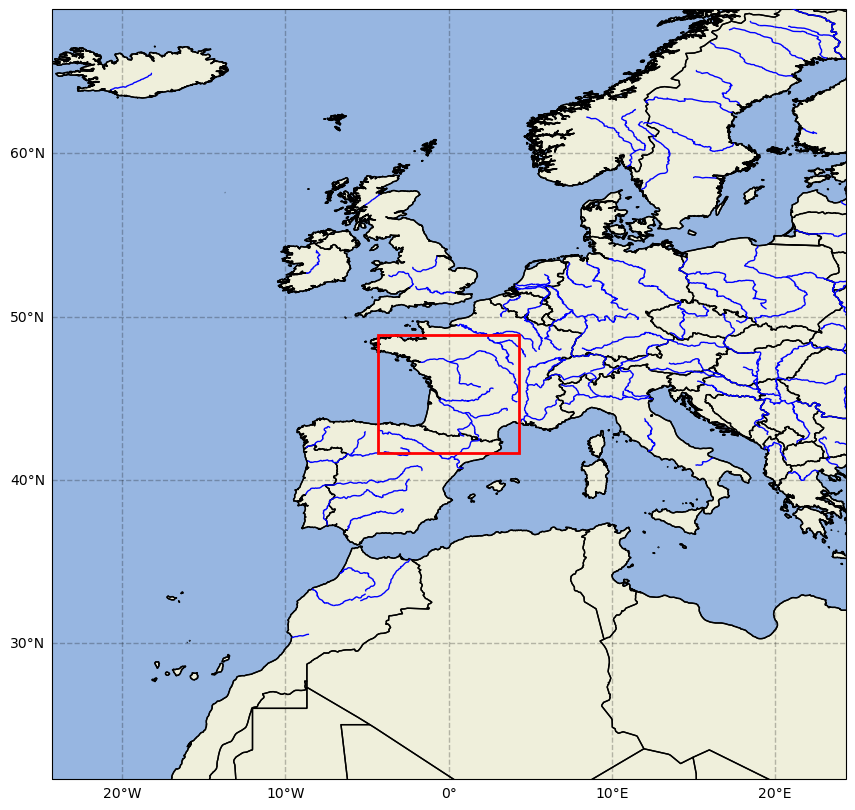

In [42]:
# Plot a box around our spatial bounds
plotting.map_box(bb_france)

In [43]:
france_timeseries = ideas_processing.spatial_timeseries(*france_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=-4.297&minLat=41.662&maxLon=4.324&maxLat=48.845&startTime=2021-12-31T00:00:00Z&endTime=2022-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.7897459160303697 seconds


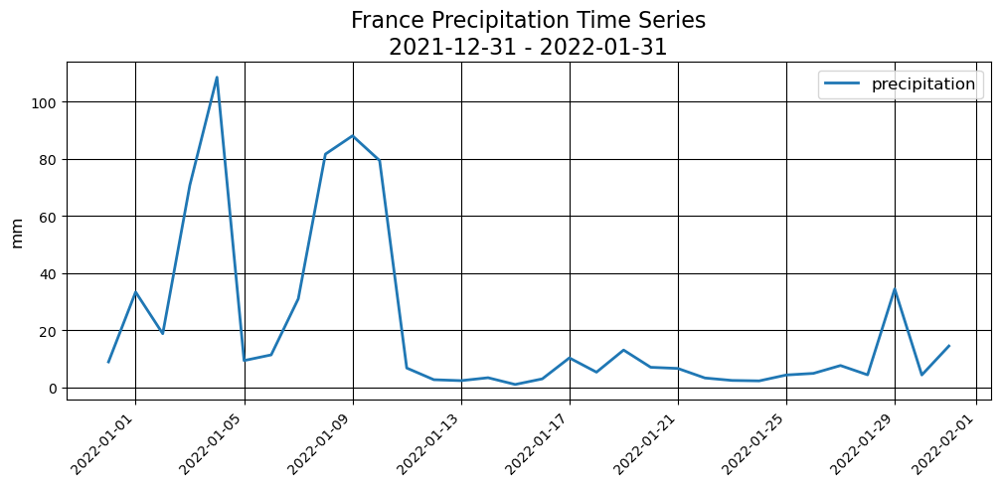

In [44]:
france_title = f'France Precipitation Time Series\n{str(start_france)[:10]} - {str(end_france)[:10]}'
plotting.timeseries_plot([(france_timeseries.maximum, 'precipitation')], '', 'mm', france_title)

In [45]:
france_start = datetime(2022,1,5)
france_end = datetime(2022,1,10)
france_precipitation_data = ideas_processing.temporal_mean(NEXUS_URL, global_precipitation_dataset, bb_france, france_start, france_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=-4.297,41.662,4.324,48.845&startTime=2022-01-05T00:00:00Z&endTime=2022-01-10T00:00:00Z

Waiting for response from IDEAS... took 2.827565166982822 seconds


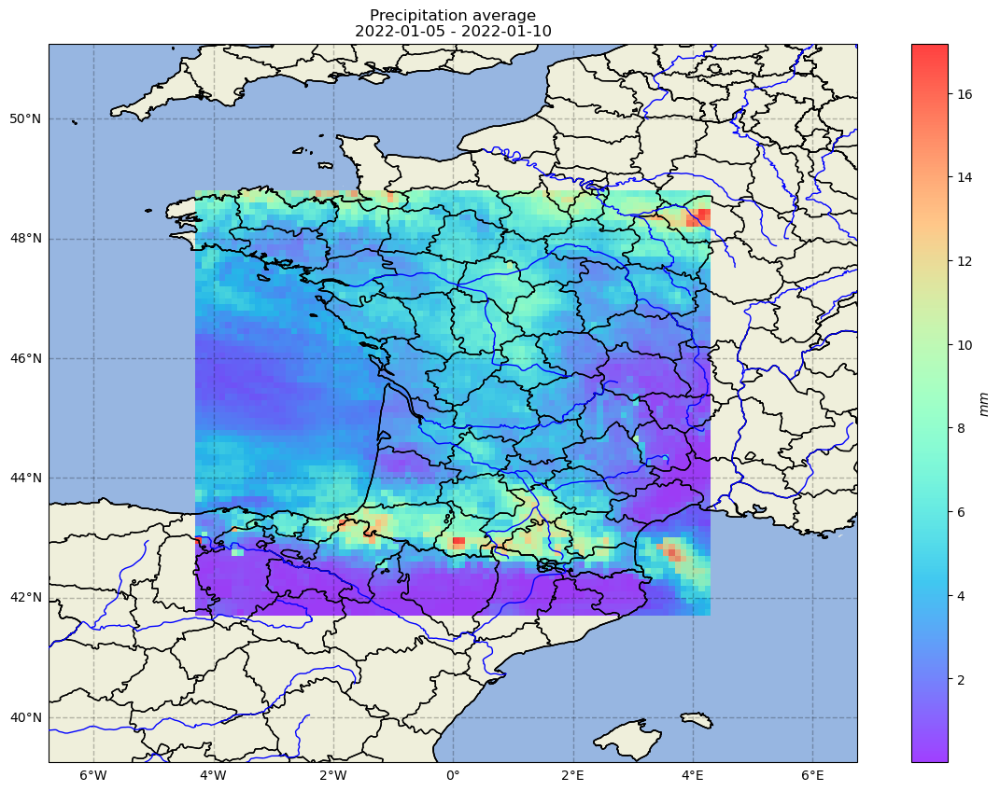

In [46]:
france_title = f'Precipitation average\n{str(france_start)[:10]} - {str(france_end)[:10]}'
plotting.map_data(france_precipitation_data, france_title, cb_label='$mm$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [47]:
france_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_france, start_france, end_france)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&climatology=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed_clim&b=-4.297,41.662,4.324,48.845&startTime=2021-12-31T00:00:00Z&endTime=2022-01-31T00:00:00Z

Waiting for response from IDEAS... took 3.632388708065264 seconds


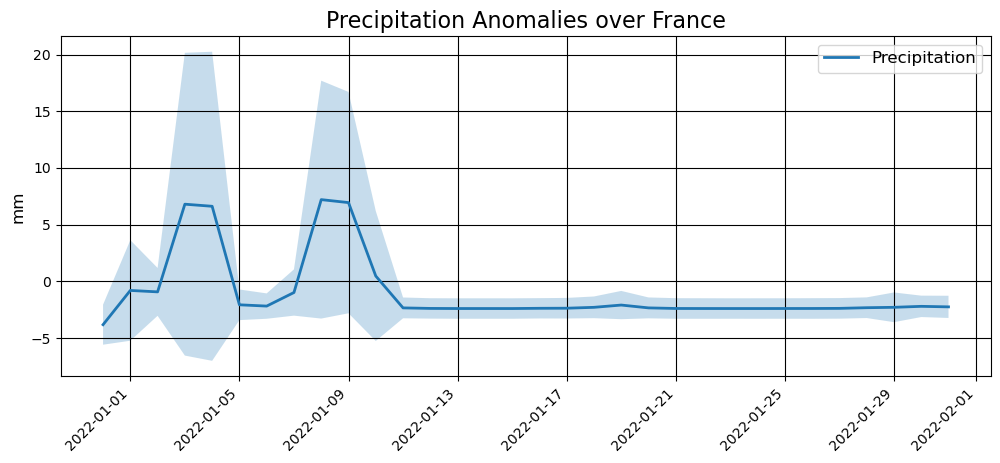

In [48]:
plotting.timeseries_bands_plot(france_daily_diff_data, 'Precipitation', '', 'mm', 'Precipitation Anomalies over France')

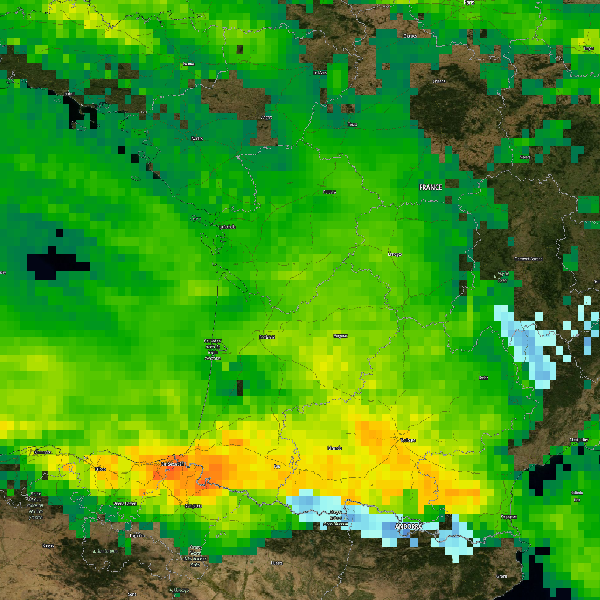

In [49]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=( -4.297, 41.662, 4.324, 48.845),  # Bounds
                 size=(600, 600),  # Image size
                 time='2022-01-09',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('IMERG_Precipitation_Rate_2022-01-09.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('IMERG_Precipitation_Rate_2022-01-09.png')

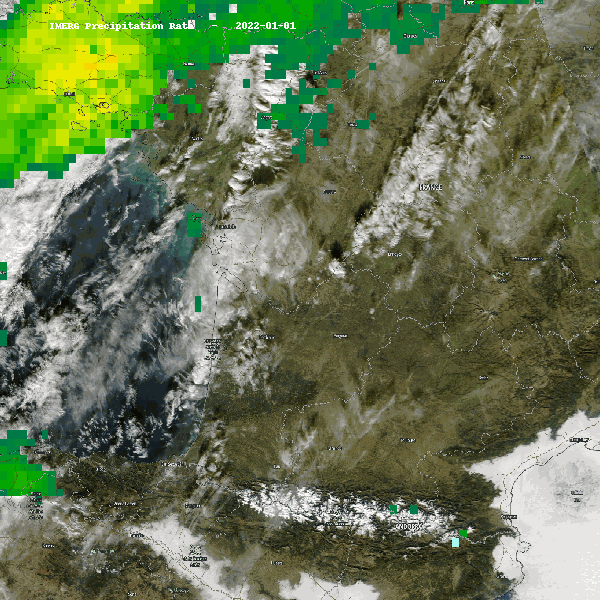

In [50]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 1, 1)
edate = datetime(2022, 1, 13)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=( -4.297, 41.662, 4.324, 48.845),  # Bounds
                     size=(600,600),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate_Garonne.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

Image('IMERG_Precipitation_Rate_Garonne.gif')

# Flooding in Mississippi River Basin

In [51]:
miss_bb       = {'min_lon': -94.5, 'max_lon': -87, 'min_lat': 28, 'max_lat': 37.5}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_noahmp_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]

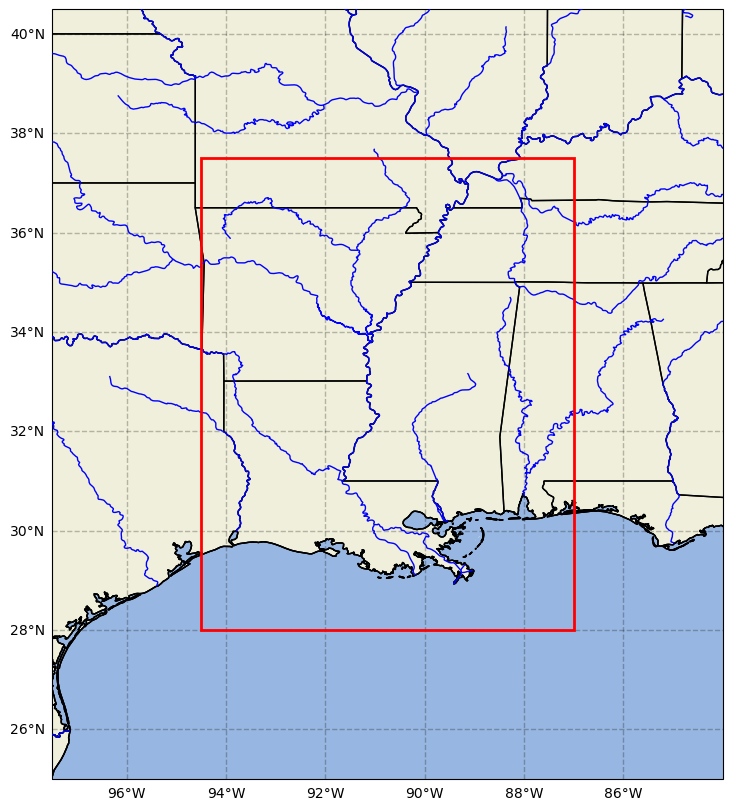

In [52]:
plotting.map_box(miss_bb, 3)

In [53]:
gpm_miss_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed', miss_bb, miss_start, miss_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 3.036357166012749 seconds


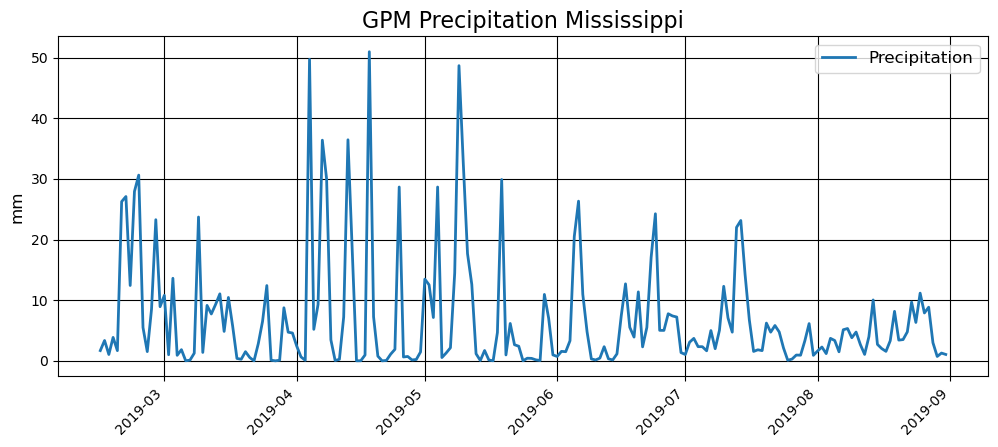

In [54]:
plotting.timeseries_plot([(gpm_miss_ts['mean'], 'Precipitation', 'tab:blue')], '', 'mm', 'GPM Precipitation Mississippi')

In [55]:
smap_miss_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'SPL3SMP_AM_soil_moisture', miss_bb, miss_start, miss_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=SPL3SMP_AM_soil_moisture&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1751962499693036 seconds


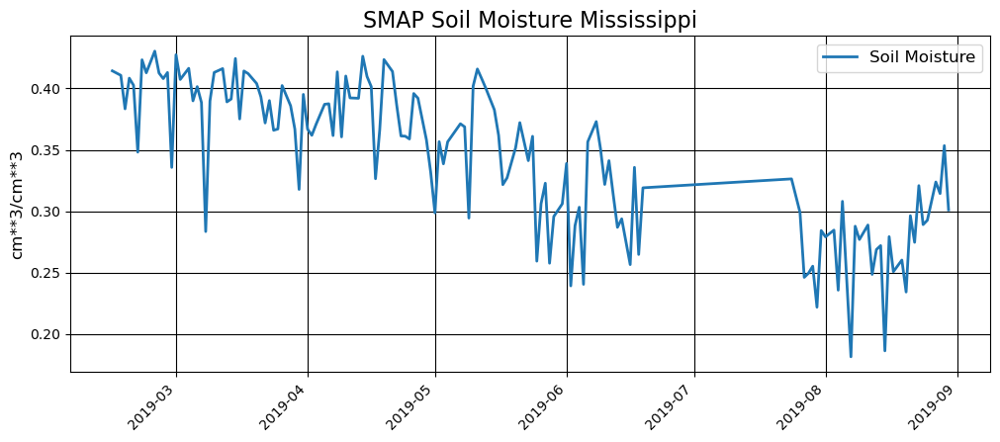

In [56]:
plotting.timeseries_plot([(smap_miss_ts['mean'], 'Soil Moisture', 'tab:blue')], '', 'cm**3/cm**3', 'SMAP Soil Moisture Mississippi')

In [57]:
smap_miss_subset = ideas_processing.data_subsetting(NEXUS_URL, 'SPL3SMP_AM_soil_moisture', miss_bb, datetime(2019,6,11), datetime(2019,6,12))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=SPL3SMP_AM_soil_moisture&b=-94.5,28,-87,37.5&startTime=2019-06-11T00:00:00Z&endTime=2019-06-12T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.2676822500070557 seconds


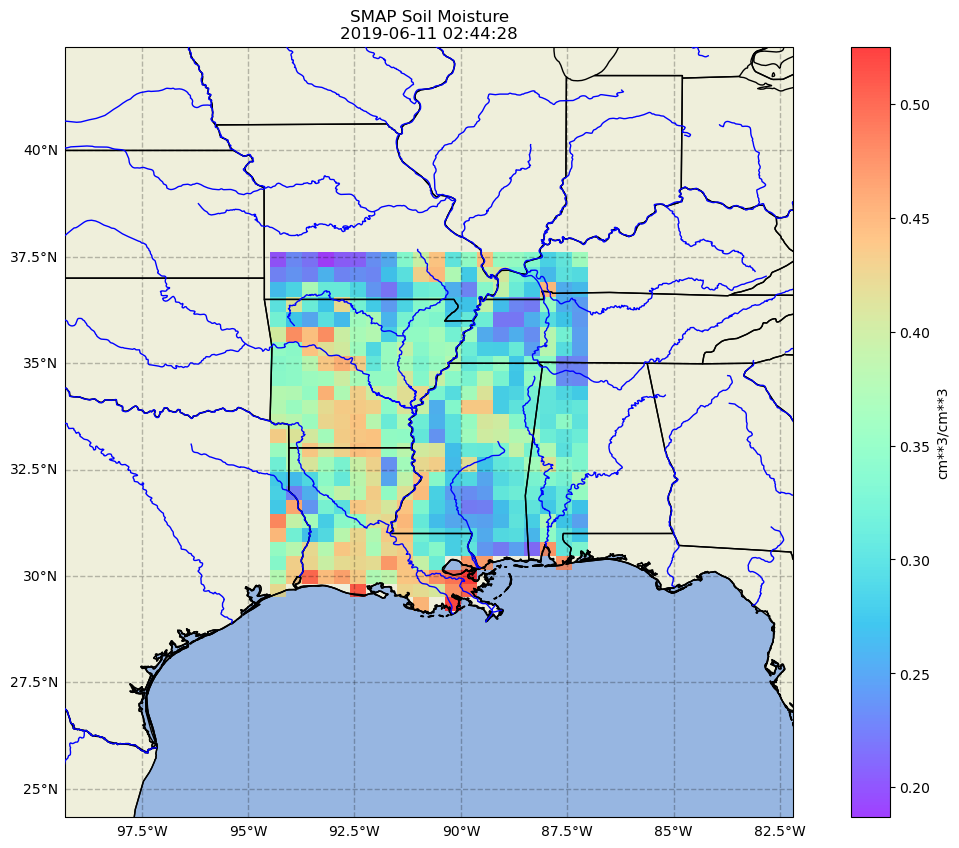

In [58]:
plotting.map_data(smap_miss_subset[0], f'SMAP Soil Moisture\n{datetime.fromtimestamp(smap_miss_subset[0].time.values)}', cb_label='cm**3/cm**3', padding=5)

## LIS NoahMP Runoff and GPM Precipitation

In [59]:
lis_noahmp_miss_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_noahmp_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.358762540970929 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.802097500069067 seconds


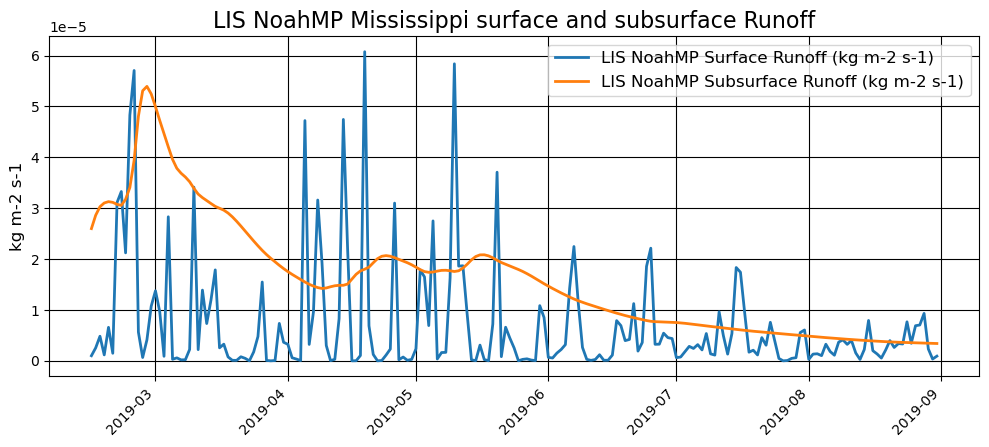

In [60]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:orange')], '', 'kg m-2 s-1', 'LIS NoahMP Mississippi surface and subsurface Runoff')

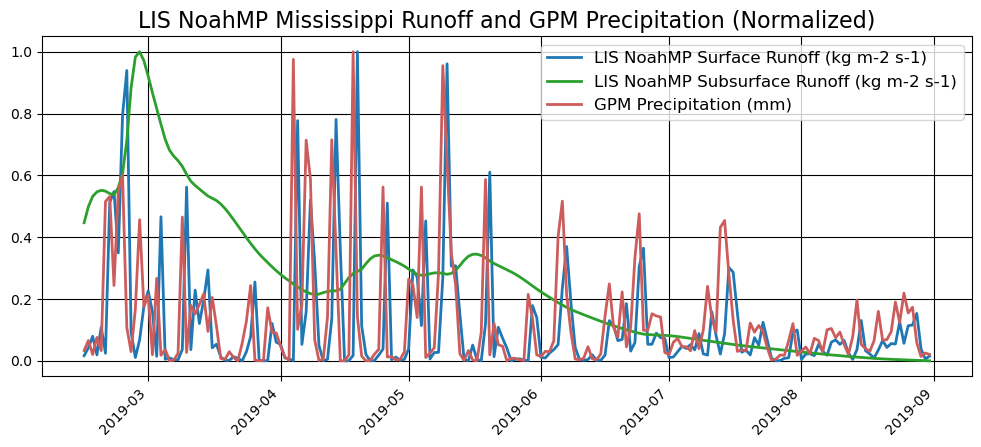

In [61]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_miss_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Mississippi Runoff and GPM Precipitation (Normalized)', norm=True)

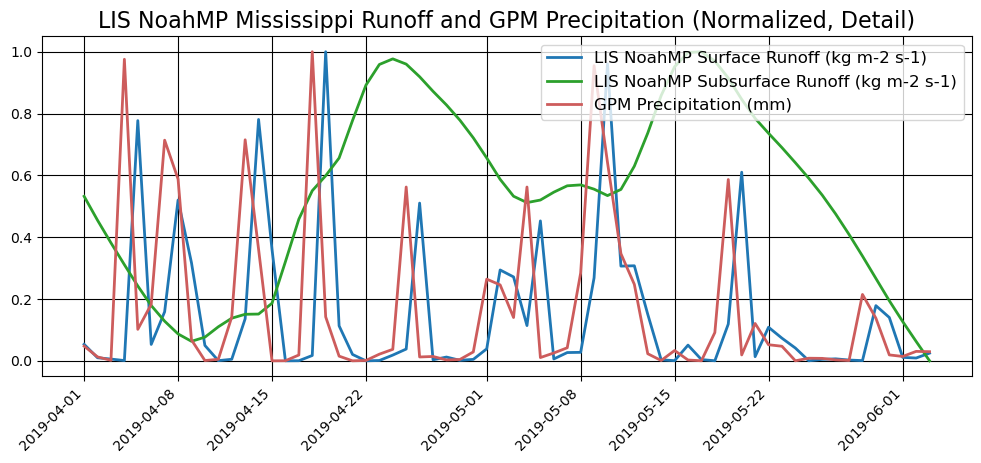

In [62]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'][46:110], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'][46:110], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_miss_ts['mean'][46:110], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Mississippi Runoff and GPM Precipitation (Normalized, Detail)', norm=True)

## LIS NoahMP Full Basin

In [63]:
miss_basin_bb       = {'min_lon': -105, 'max_lon': -85, 'min_lat': 27.5, 'max_lat': 54}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_noahmp_basin_params = [(NEXUS_URL, ds, miss_basin_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]

In [64]:
lis_noahmp_miss_tavg = [ideas_processing.temporal_mean(*miss_param) for miss_param in miss_lis_noahmp_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_miss_1x_Qs_tavg&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 34.88316987501457 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_miss_1x_Qsb_tavg&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 24.266673999954946 seconds


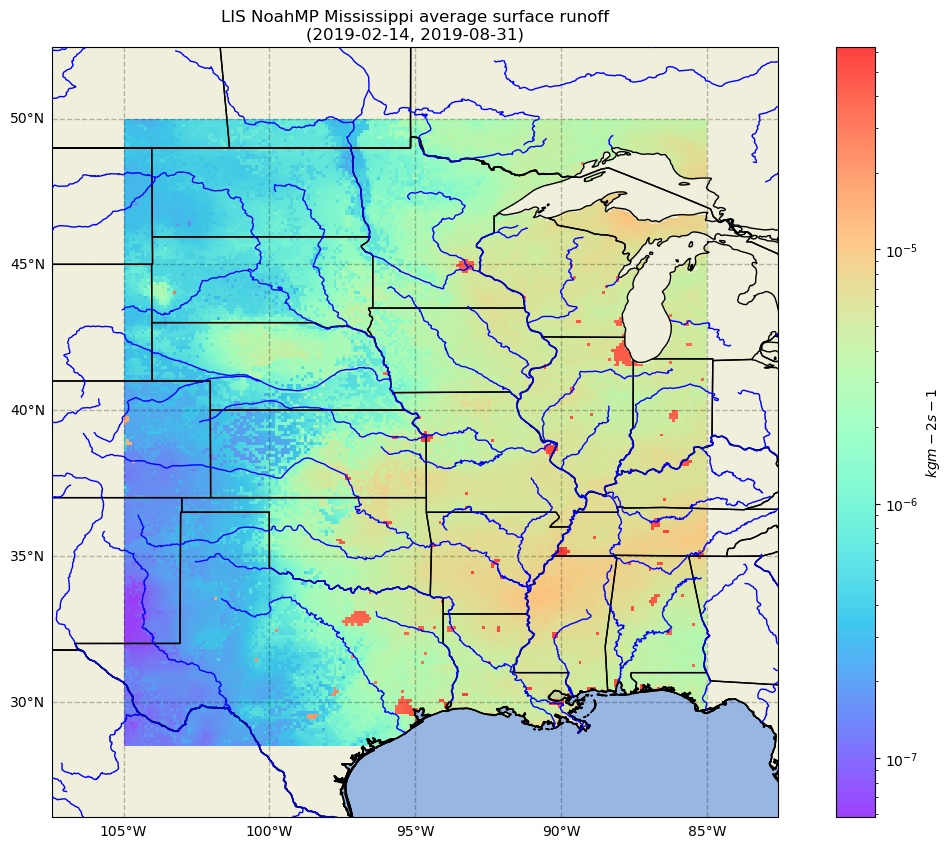

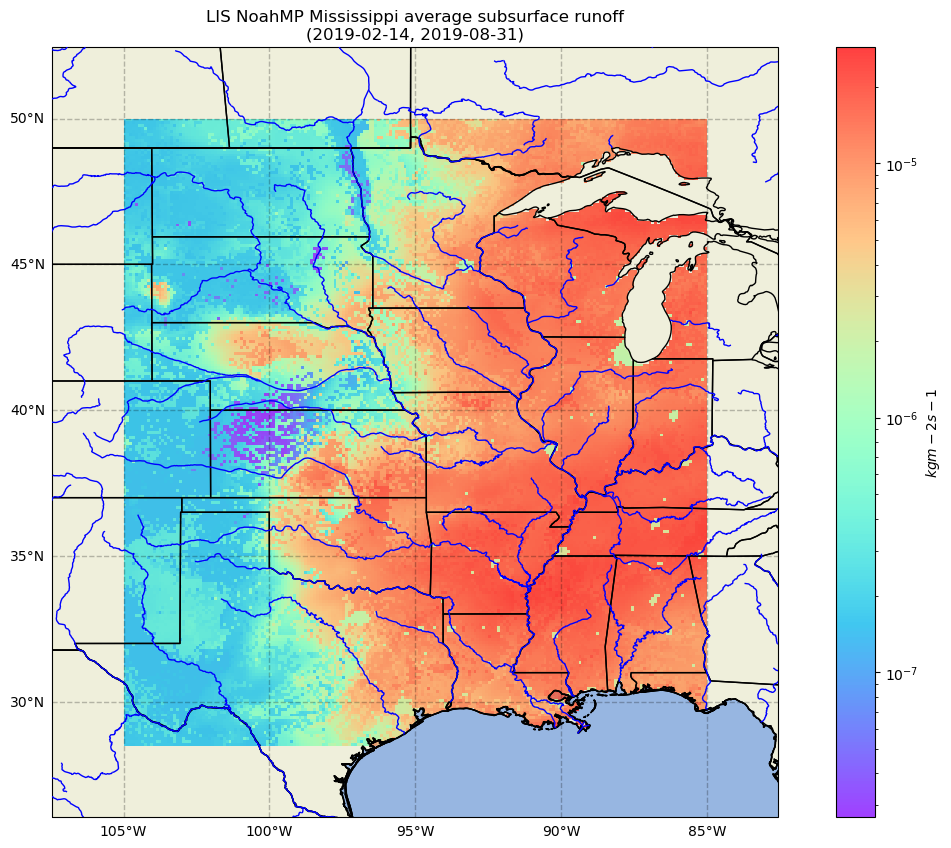

In [65]:
plotting.map_data(lis_noahmp_miss_tavg[0], 'LIS NoahMP Mississippi average surface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2 s-1$', log_scale=True)
plotting.map_data(lis_noahmp_miss_tavg[1], 'LIS NoahMP Mississippi average subsurface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2 s-1$', log_scale=True)

## LIS VIC Runoff and GPM Precipitation

In [66]:
miss_lis_vic_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [67]:
lis_vic_miss_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_vic_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 7.348455082974397 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 5.953852375037968 seconds


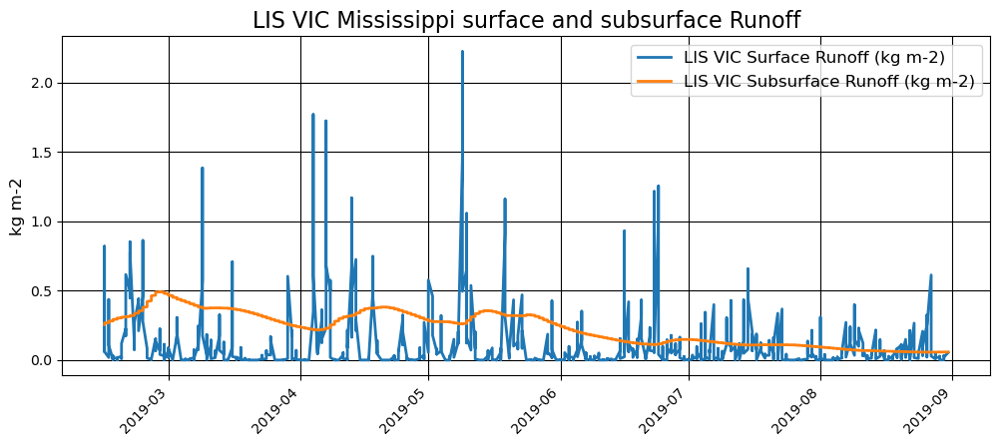

In [68]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:orange')], '', 'kg m-2', 'LIS VIC Mississippi surface and subsurface Runoff')

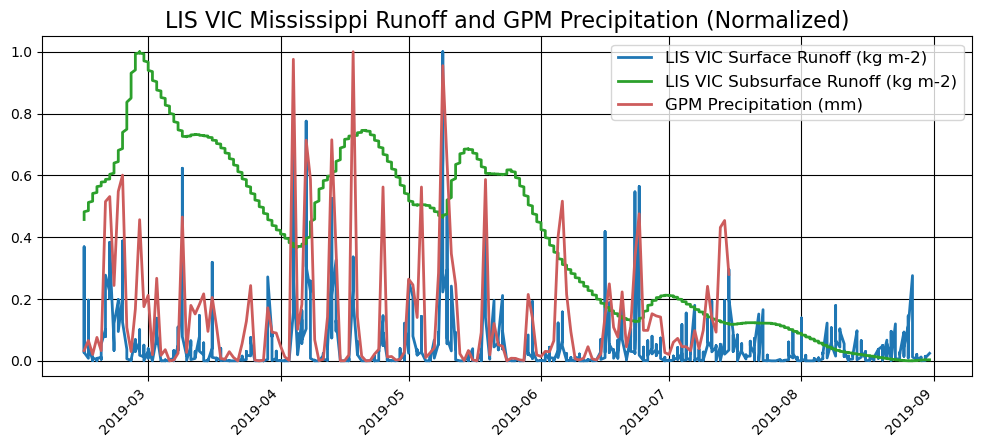

In [69]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:green'), (gpm_miss_ts['mean'][:152], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Mississippi Runoff and GPM Precipitation (Normalized)', norm=True)

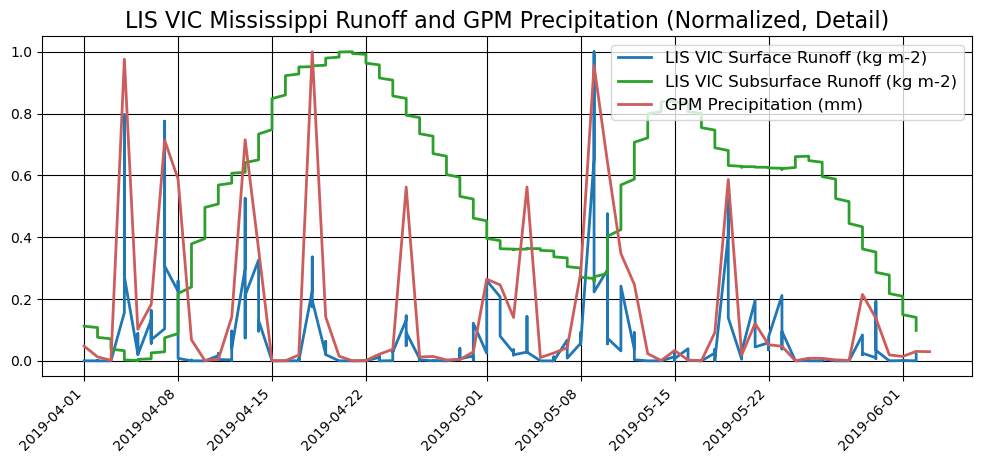

In [70]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'][375:870], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'][375:870], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:green'), (gpm_miss_ts['mean'][46:110], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Mississippi Runoff and GPM Precipitation (Normalized, Detail)', norm=True)

### LIS VIC Full Basin

In [71]:
miss_basin_bb       = {'min_lon': -105, 'max_lon': -85, 'min_lat': 27.5, 'max_lat': 54}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_vic_basin_params = [(NEXUS_URL, ds, miss_basin_bb, miss_start, miss_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [72]:
lis_vic_miss_tavg = [ideas_processing.temporal_mean(*miss_param) for miss_param in miss_lis_vic_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 12.79325600003358 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 12.10491616697982 seconds


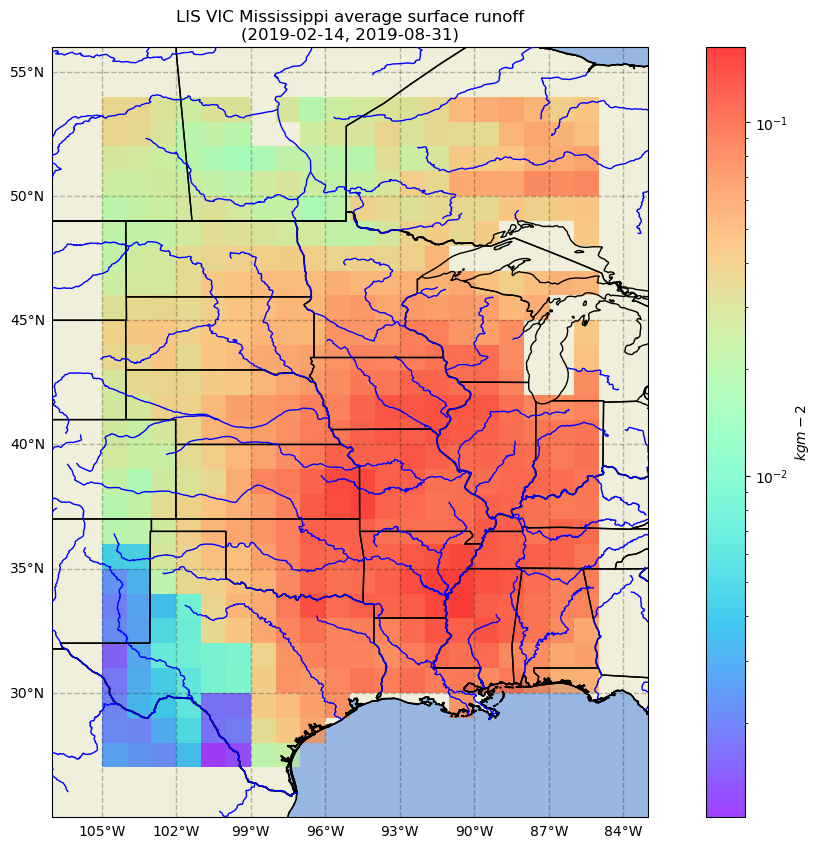

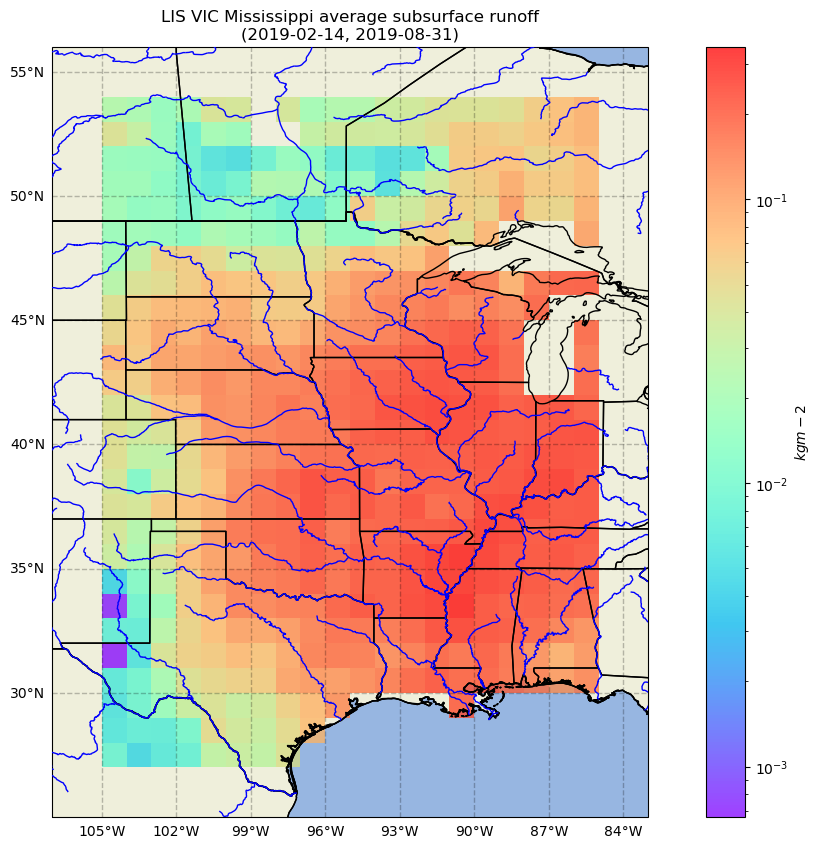

In [73]:
plotting.map_data(lis_vic_miss_tavg[0], 'LIS VIC Mississippi average surface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_vic_miss_tavg[1], 'LIS VIC Mississippi average subsurface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2$', log_scale=True)

## Mississippi RAPID
The Routing Application for Parallel computatIon of Discharge (RAPID) is a river routing model. Given surface and groundwater inflow to rivers, this model can compute the flow and volume of water everywhere in river networks made out of many thousands of reaches. 

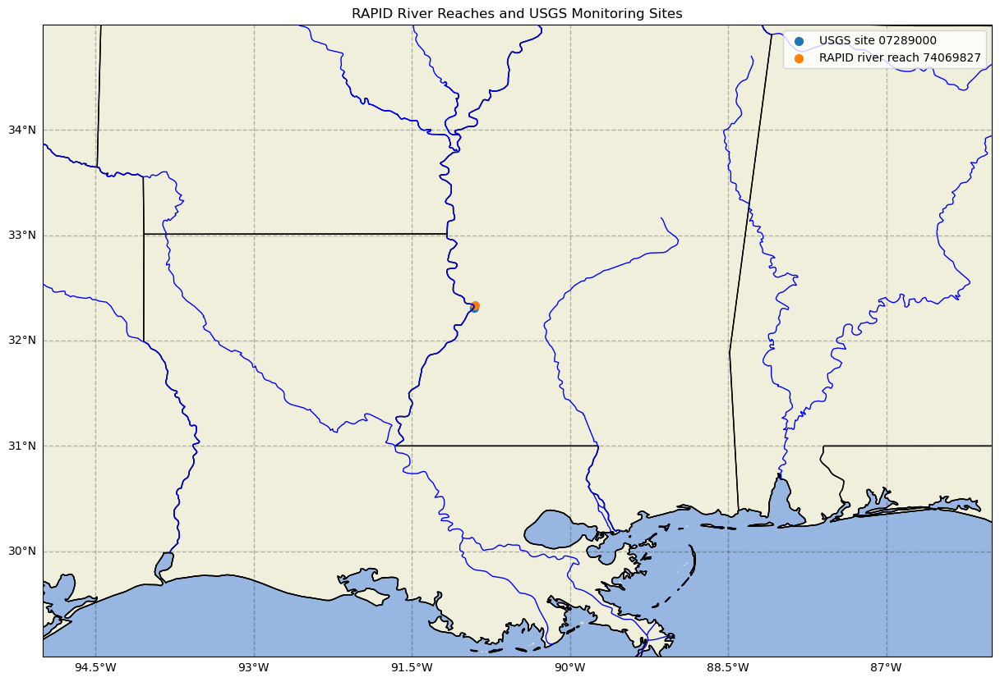

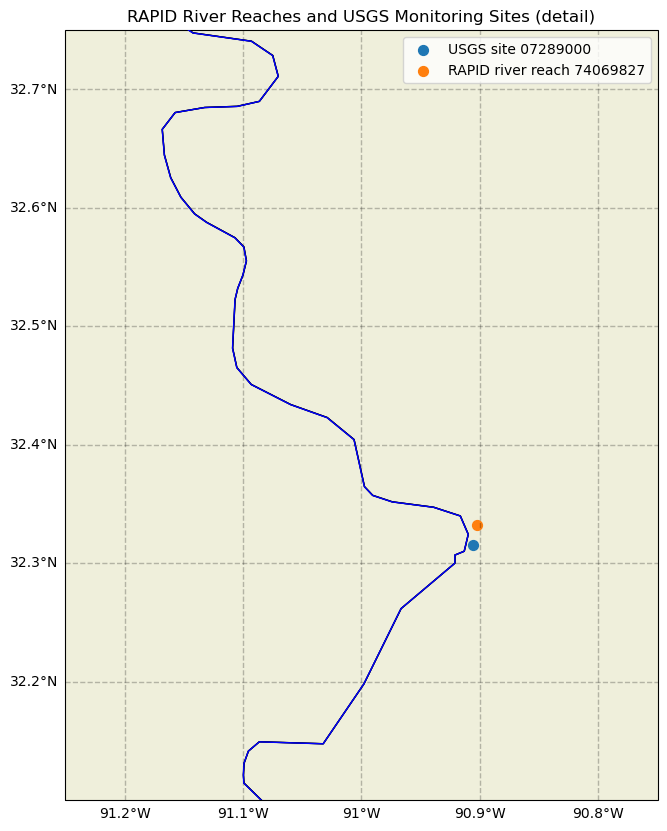

In [74]:
points = [
    (32.315, -90.905833, 'USGS site 07289000'),
    (32.3325, -90.9025, 'RAPID river reach 74069827')
]
plotting.map_points(points, 'miss', 'RAPID River Reaches and USGS Monitoring Sites')
plotting.map_points(points, 'miss', 'RAPID River Reaches and USGS Monitoring Sites (detail)', True)

In [75]:
usgs_params = (NEXUS_URL, 'USGS', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))

In [76]:
miss_usgs_df = ideas_processing.insitu(*usgs_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=USGS&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=USGS&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-09-01T00:00:00Z&markerPlatform=55ae8ade499bc18f8e994f84d1787fc2856412668c78c47e409d3b9bd6fddc4a


In [77]:
miss_usgs_site_df = miss_usgs_df[miss_usgs_df['platform_id'] == '07289000']
try:
    miss_usgs_site_df['time'] = [datetime.strptime(t, '%Y-%m-%dT%H:%M:%SZ') for t in miss_usgs_site_df['time']]
except:
    pass

In [78]:
rapid_lis_noahmp_miss_params = (NEXUS_URL, 'RAPID_LIS_1x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_vic_miss_params = (NEXUS_URL, 'RAPID_VIC_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_noah_miss_params = (NEXUS_URL, 'RAPID_NOAH_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_clsm_miss_params = (NEXUS_URL, 'RAPID_CLSM_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))

In [79]:
rapid_lis_noahmp_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_miss_params)
rapid_vic_miss_df = ideas_processing.insitu(*rapid_vic_miss_params)
rapid_noah_miss_df = ideas_processing.insitu(*rapid_noah_miss_params)
rapid_clsm_miss_df = ideas_processing.insitu(*rapid_clsm_miss_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=421163fe38cd0837d8ebd0869986078f1c77a95aef86fd4b592609318cc61cd2
https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Mississi

In [80]:
rapid_lis_noahmp_miss_site_df = rapid_lis_noahmp_miss_df[rapid_lis_noahmp_miss_df['platform_id'] == '74069827']
rapid_vic_miss_site_df = rapid_vic_miss_df[rapid_vic_miss_df['platform_id'] == '74069827']
rapid_noah_miss_site_df = rapid_noah_miss_df[rapid_noah_miss_df['platform_id'] == '74069827']
rapid_clsm_miss_site_df = rapid_clsm_miss_df[rapid_clsm_miss_df['platform_id'] == '74069827']

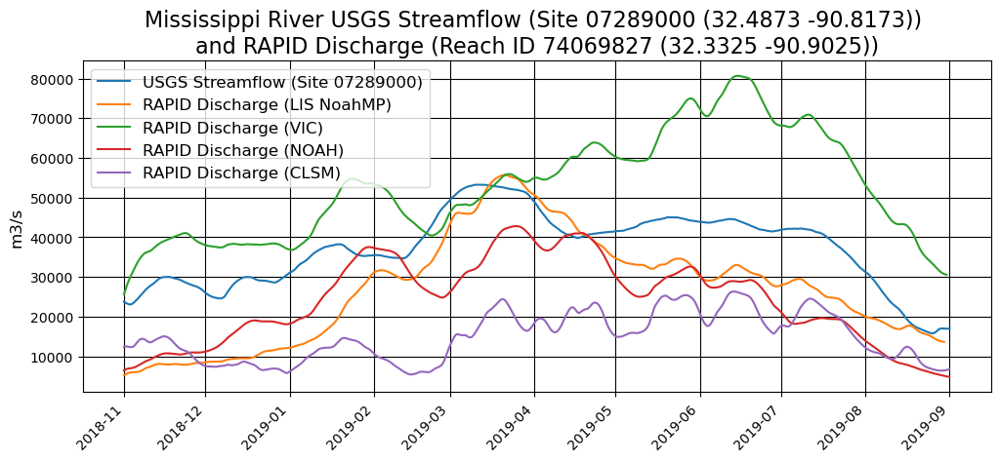

In [81]:
plotting.plot_insitu([(miss_usgs_site_df, 'Streamflow', 'USGS Streamflow (Site 07289000)'), 
                      (rapid_lis_noahmp_miss_site_df, 'Qout', 'RAPID Discharge (LIS NoahMP)'),
                      (rapid_vic_miss_site_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_miss_site_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_miss_site_df, 'Qout', 'RAPID Discharge (CLSM)')
                      ], 'Mississippi River USGS Streamflow (Site 07289000 (32.4873 -90.8173)) \nand RAPID Discharge (Reach ID 74069827 (32.3325 -90.9025))')

# LIS NoahMP Scenarios
Three scenarios with different amounts of MERRA2 precipitation as input to LIS NoahMP. For each scenario we can perform spatial and temporal analysis of the LIS NoahMP data, as well as the resulting RAPID discharge data.

In [82]:
miss_bb = {'min_lon': -94.5, 'max_lon': -87, 'min_lat': 28, 'max_lat': 37.5}
miss_start = datetime(2019, 2, 14)
miss_end = datetime(2019, 8, 31)

## Scenario 1, Nominal Precipitation

In [83]:
miss_lis_scenario_1_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]
miss_lis_scenario_1_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_1x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 4.168582582962699 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_1x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.9035163330845535 seconds


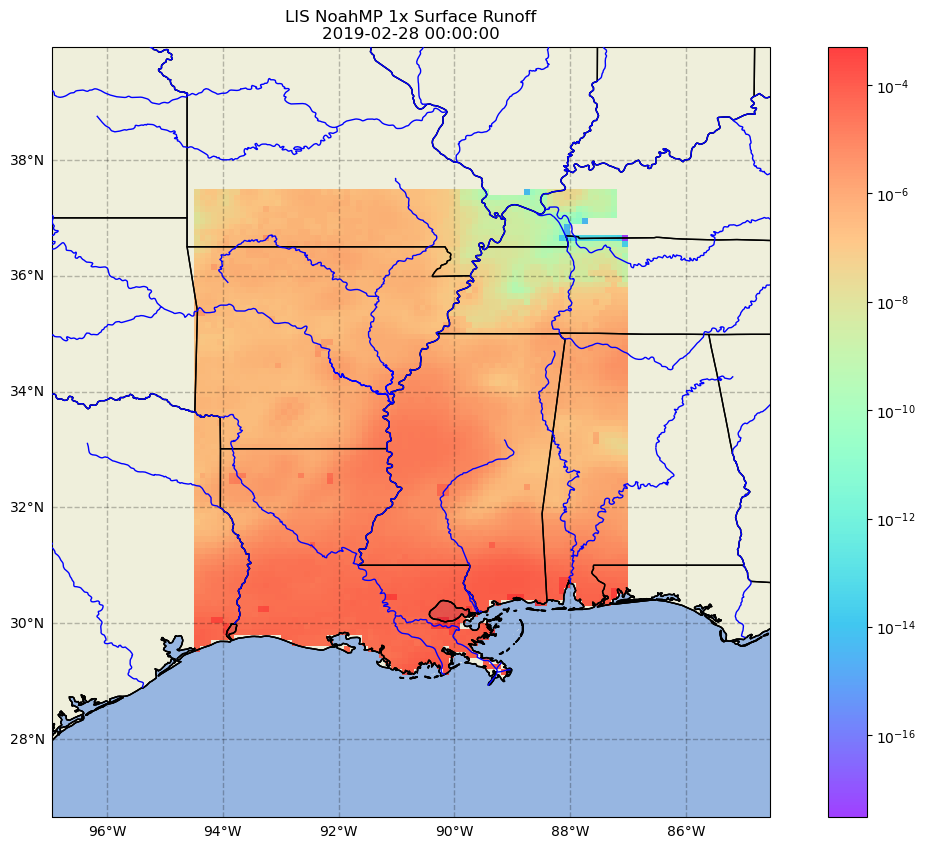

In [84]:
plotting.map_data(miss_lis_scenario_1_sub[0][3], f'LIS NoahMP 1x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_1_sub[0][3].time.values)}', log_scale=True)

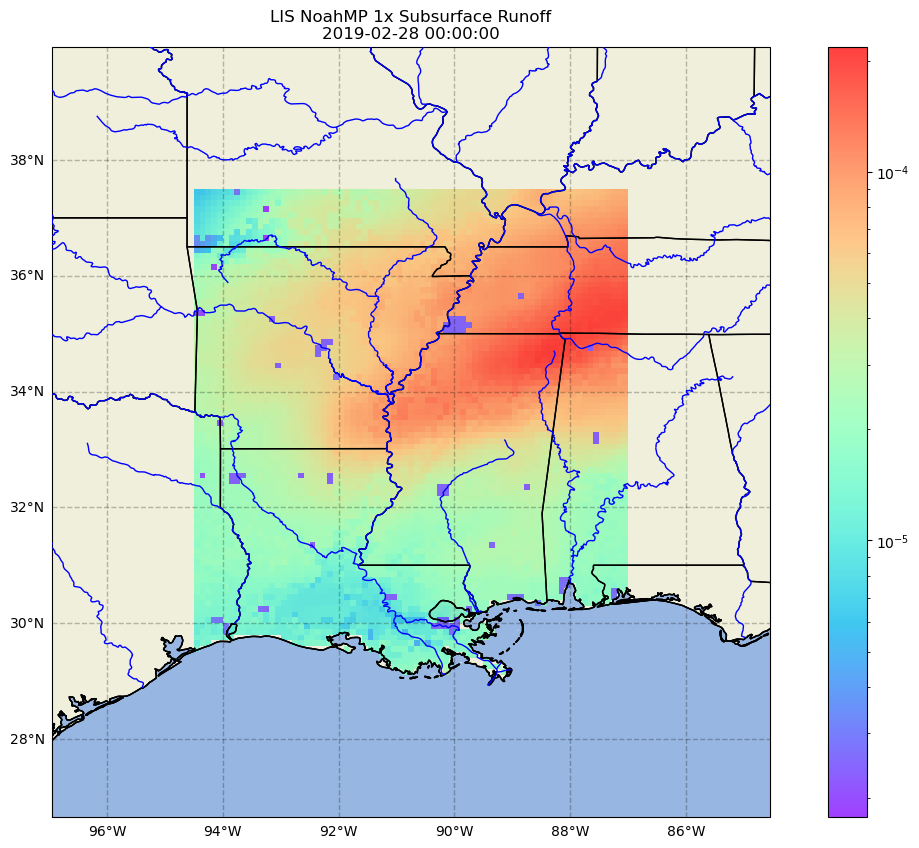

In [85]:
plotting.map_data(miss_lis_scenario_1_sub[1][3], f'LIS NoahMP 1x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_1_sub[1][3].time.values)}', log_scale=True)

In [86]:
miss_lis_scenario_1_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]
miss_lis_scenario_1_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.1334241250297055 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.5130272500682622 seconds


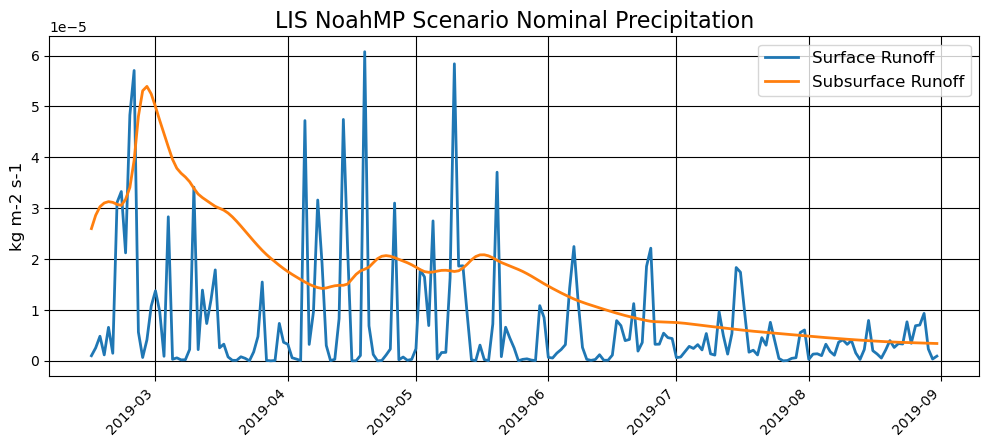

In [87]:
plotting.timeseries_plot([(miss_lis_scenario_1_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_1_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario Nominal Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=421163fe38cd0837d8ebd0869986078f1c77a95aef86fd4b592609318cc61cd2


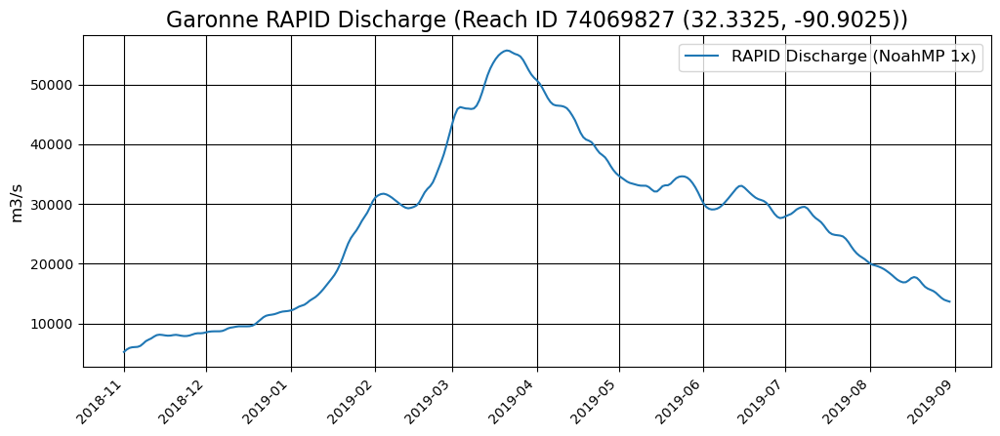

In [88]:
rapid_lis_noahmp_1x_miss_params = (NEXUS_URL, 'RAPID_LIS_1x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_1x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_1x_miss_params)
rapid_lis_noahmp_1x_miss_site_df = rapid_lis_noahmp_1x_miss_df[rapid_lis_noahmp_1x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_1x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 1x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

## Scenario 2, 2x Precipitation

In [89]:
miss_lis_scenario_2_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_merra2_2x_Qs_tavg', 'LIS_miss_merra2_2x_Qsb_tavg']]
miss_lis_scenario_2_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_2x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.6206291670678183 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_2x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.377317582955584 seconds


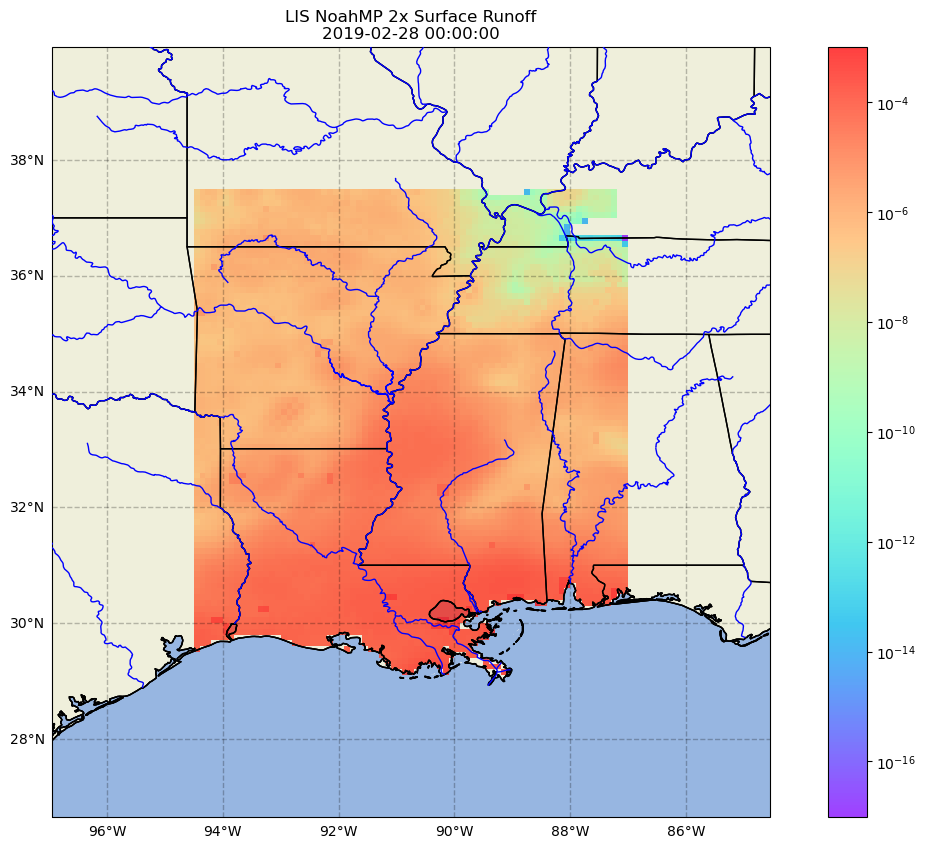

In [90]:
plotting.map_data(miss_lis_scenario_2_sub[0][3], f'LIS NoahMP 2x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_2_sub[0][3].time.values)}', log_scale=True)

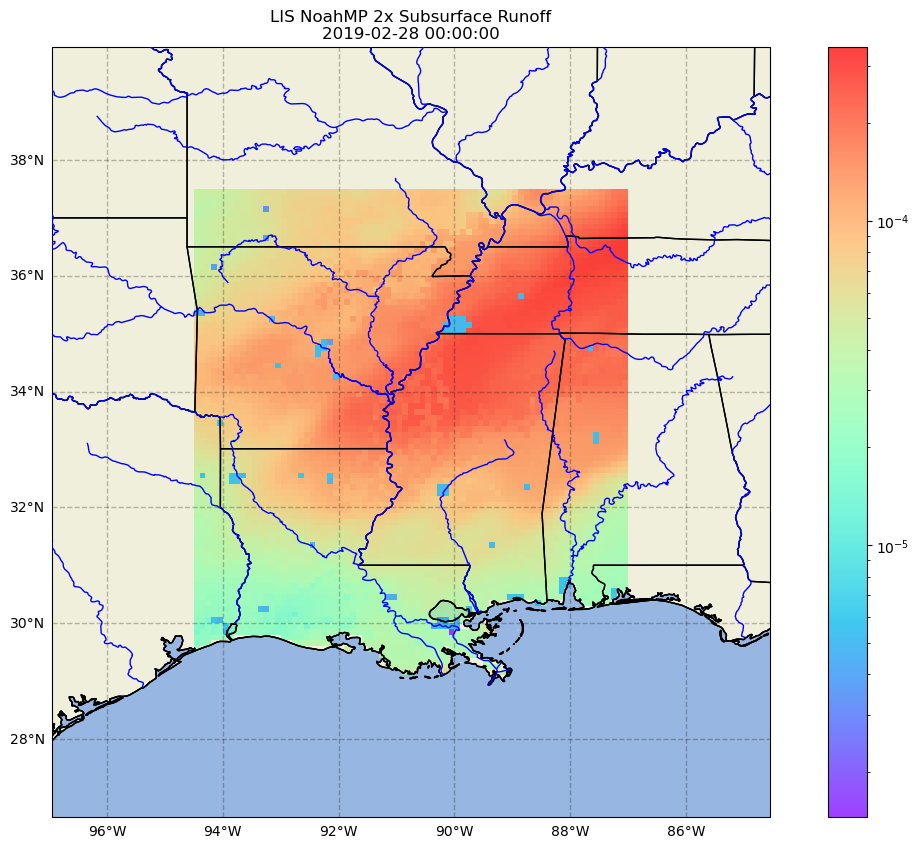

In [91]:
plotting.map_data(miss_lis_scenario_2_sub[1][3], f'LIS NoahMP 2x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_2_sub[1][3].time.values)}', log_scale=True)

In [92]:
miss_lis_scenario_2_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_merra2_2x_Qs_tavg', 'LIS_miss_merra2_2x_Qsb_tavg']]
miss_lis_scenario_2_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_2x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.4065218749456108 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_2x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.8687485000118613 seconds


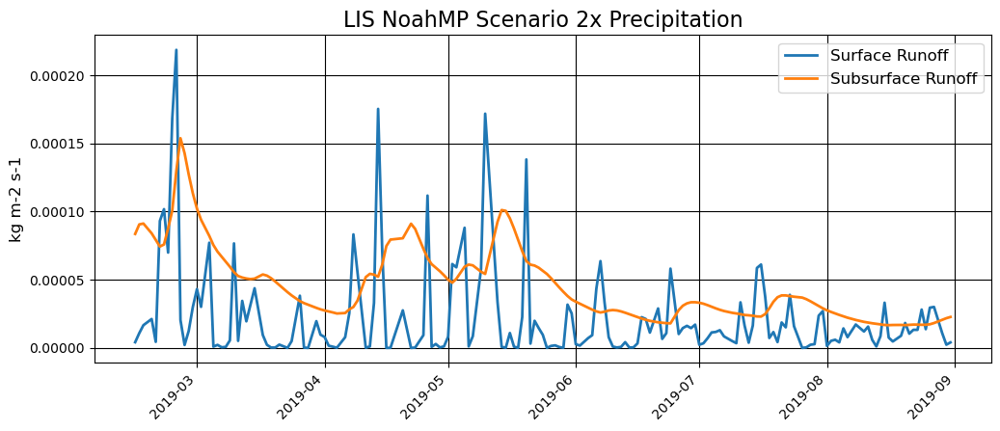

In [93]:
plotting.timeseries_plot([(miss_lis_scenario_2_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_2_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 2x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=eeb86a0cf54921a00ce4c29781b77a4884057baf1aef0fe2a931f8a3a8699c70


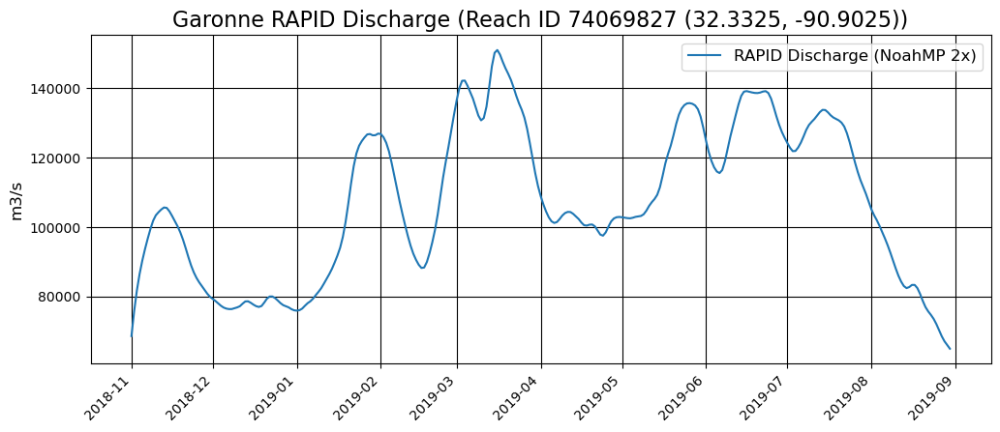

In [94]:
rapid_lis_noahmp_2x_miss_params = (NEXUS_URL, 'RAPID_LIS_2x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_2x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_2x_miss_params)
rapid_lis_noahmp_2x_miss_site_df = rapid_lis_noahmp_2x_miss_df[rapid_lis_noahmp_2x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_2x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 2x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

## Scenario 3, 3x Precipitation

In [95]:
miss_lis_scenario_3_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_merra2_3x_Qs_tavg', 'LIS_miss_merra2_3x_Qsb_tavg']]
miss_lis_scenario_3_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_3x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.3544952080119401 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_3x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.2498303750762716 seconds


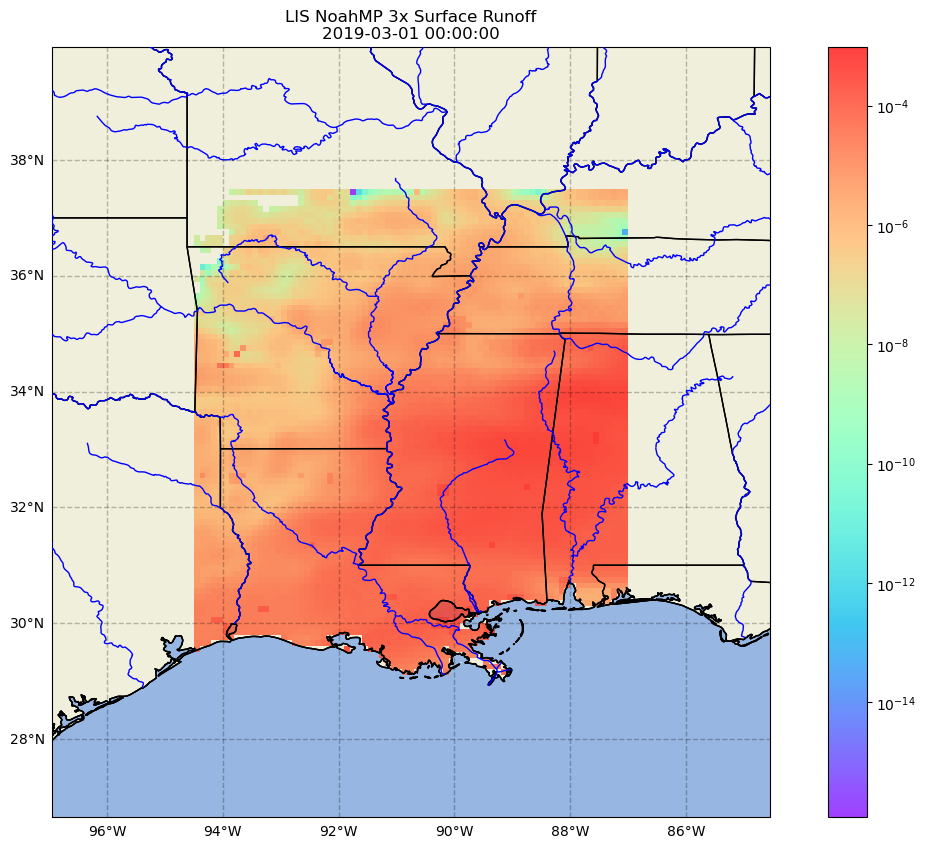

In [96]:
plotting.map_data(miss_lis_scenario_3_sub[0][3], f'LIS NoahMP 3x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_3_sub[0][3].time.values)}', log_scale=True)

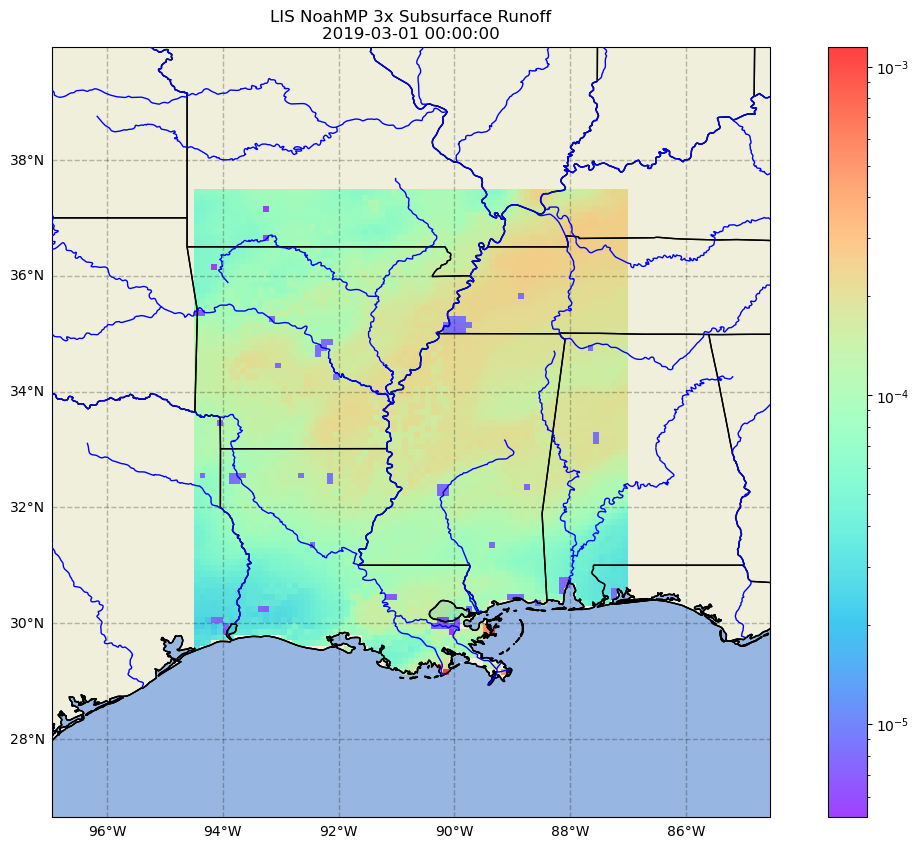

In [97]:
plotting.map_data(miss_lis_scenario_3_sub[1][3], f'LIS NoahMP 3x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_3_sub[1][3].time.values)}', log_scale=True)

In [98]:
miss_lis_scenario_3_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_merra2_3x_Qs_tavg', 'LIS_miss_merra2_3x_Qsb_tavg']]
miss_lis_scenario_3_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_3x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 6.327798458980396 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_3x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.5579461250454187 seconds


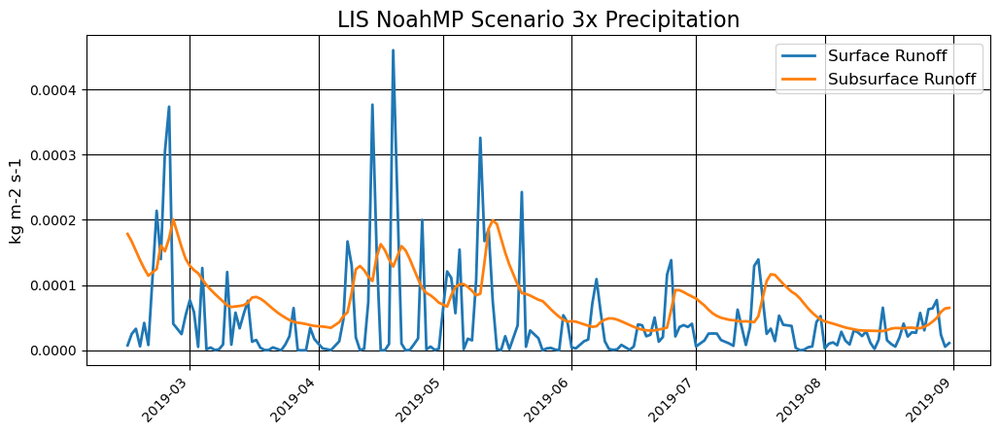

In [99]:
plotting.timeseries_plot([(miss_lis_scenario_3_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_3_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 3x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=a64ddc6593980cf78a91ffb85706800eda466c1bc77959cc6ebbd0c2df00c64d


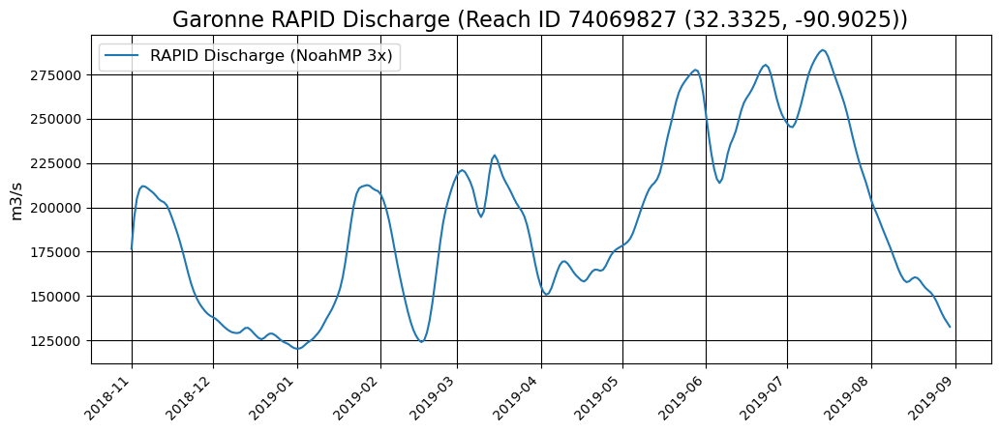

In [100]:
rapid_lis_noahmp_3x_miss_params = (NEXUS_URL, 'RAPID_LIS_3x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_3x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_3x_miss_params)
rapid_lis_noahmp_3x_miss_site_df = rapid_lis_noahmp_3x_miss_df[rapid_lis_noahmp_3x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_3x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 3x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

# Flooding in Garonne

In [101]:
gar_bb = {'min_lon': -0.5, 'max_lon': 0.5, 'min_lat': 44.25, 'max_lat': 44.75}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 3, 1)
gar_lis_noahmp_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]

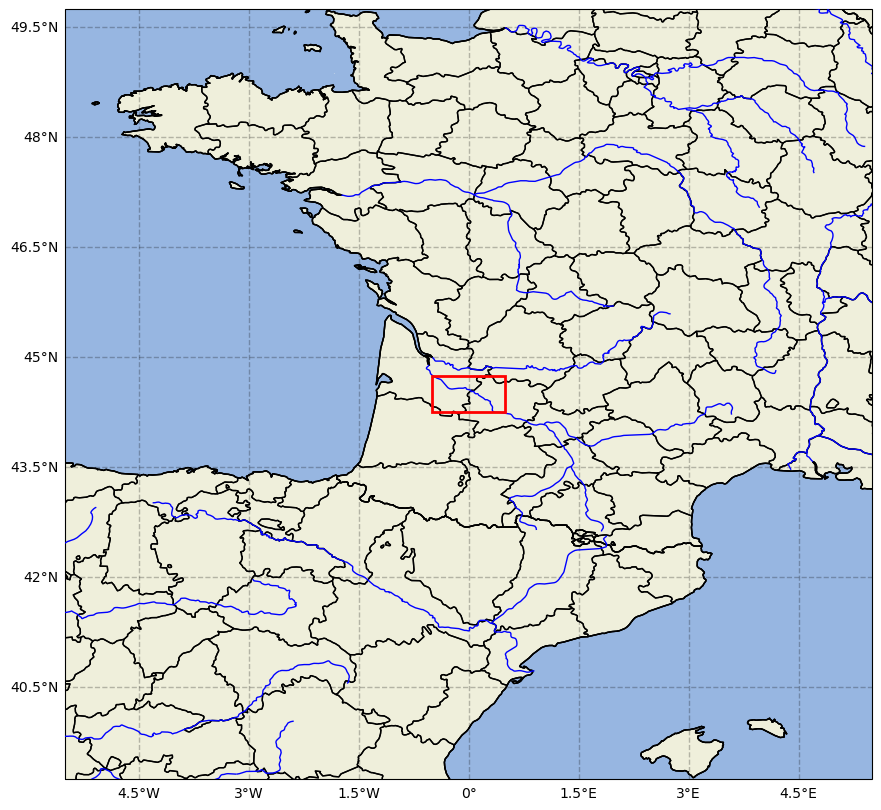

In [102]:
plotting.map_box(gar_bb, 5)

In [103]:
gpm_gar_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed', gar_bb, gar_start, gar_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.2781025409931317 seconds


## Telemac2D

In [104]:
telemac_date = datetime(2021,2,3,19)
telemac_params = (NEXUS_URL, 'cnes_topobathy', gar_bb, telemac_date, telemac_date)

In [105]:
telemac_subset_data = ideas_processing.data_subsetting(*telemac_params)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=cnes_topobathy&b=-0.5,44.25,0.5,44.75&startTime=2021-02-03T19:00:00Z&endTime=2021-02-03T19:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 59.1059860419482 seconds


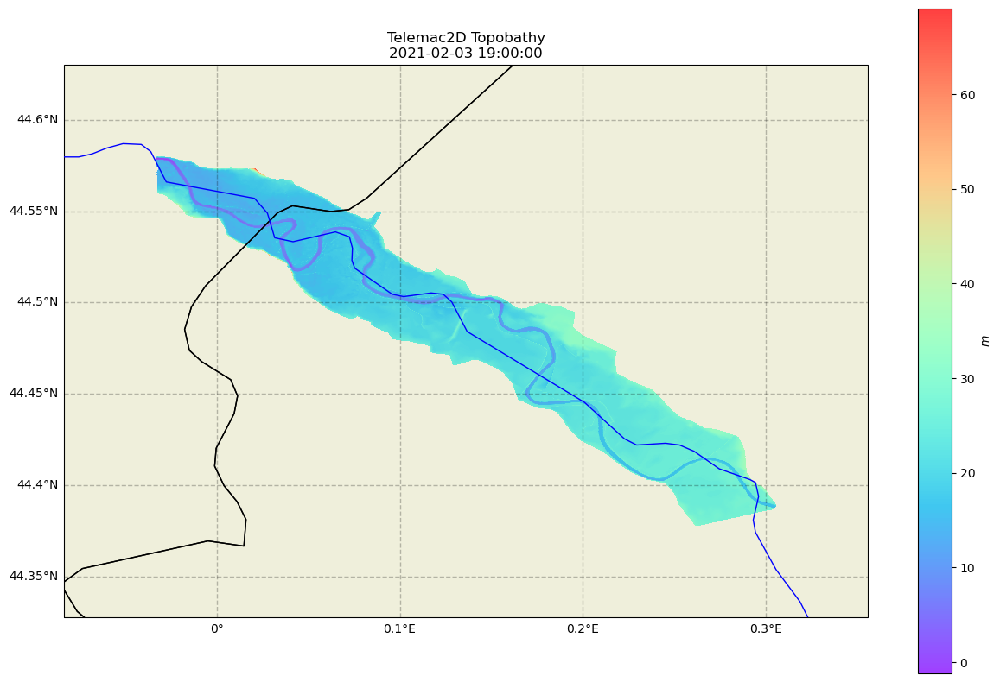

In [106]:
plotting.map_data(telemac_subset_data[0], f'Telemac2D Topobathy\n{str(telemac_date)}', cb_label="$m$", padding=.05)

## LIS NoahMP Runoff and GPM Precipitation

In [107]:
gar_lis_noahmp_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_noahmp_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qs_tavg&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1354157089954242 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qsb_tavg&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.259218042017892 seconds


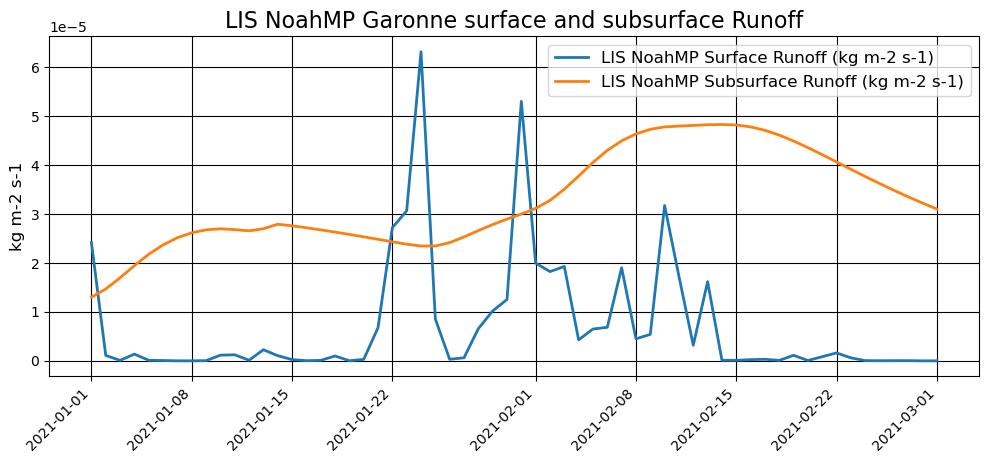

In [108]:
plotting.timeseries_plot([(gar_lis_noahmp_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noahmp_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:orange')], '', 'kg m-2 s-1', 'LIS NoahMP Garonne surface and subsurface Runoff')

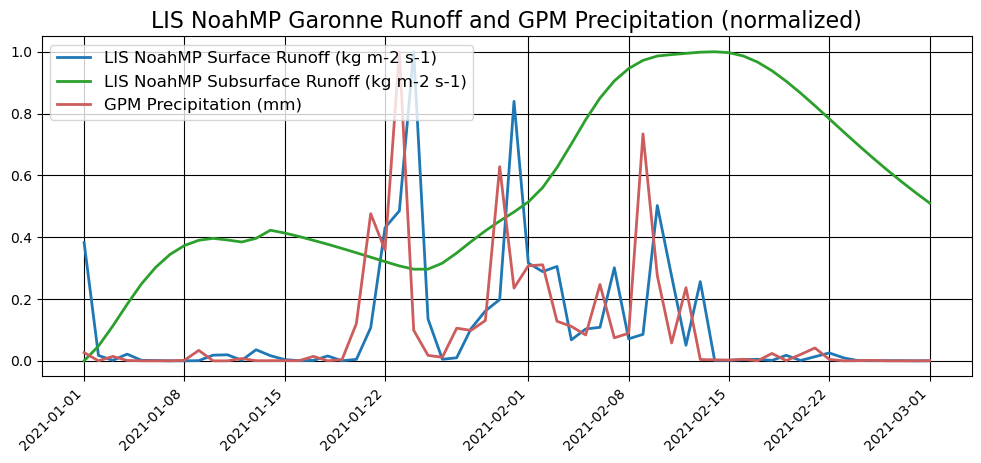

In [109]:
plotting.timeseries_plot([(gar_lis_noahmp_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noahmp_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS NoahMP Full Basin

In [110]:
gar_basin_bb = {'min_lon': -1, 'max_lon': 4.9, 'min_lat': 40, 'max_lat': 46}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 3, 1)
gar_lis_noahmp_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]

In [111]:
lis_noahmp_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_noahmp_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_gar_1x_Qs_tavg&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 3.334772750036791 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_gar_1x_Qsb_tavg&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.2529416249599308 seconds


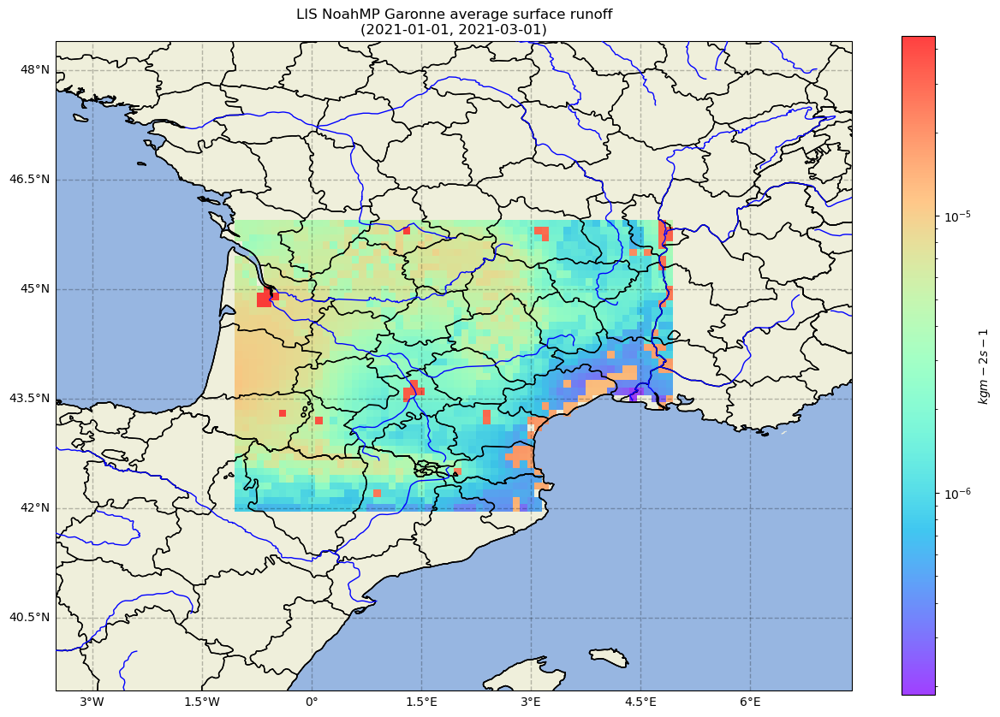

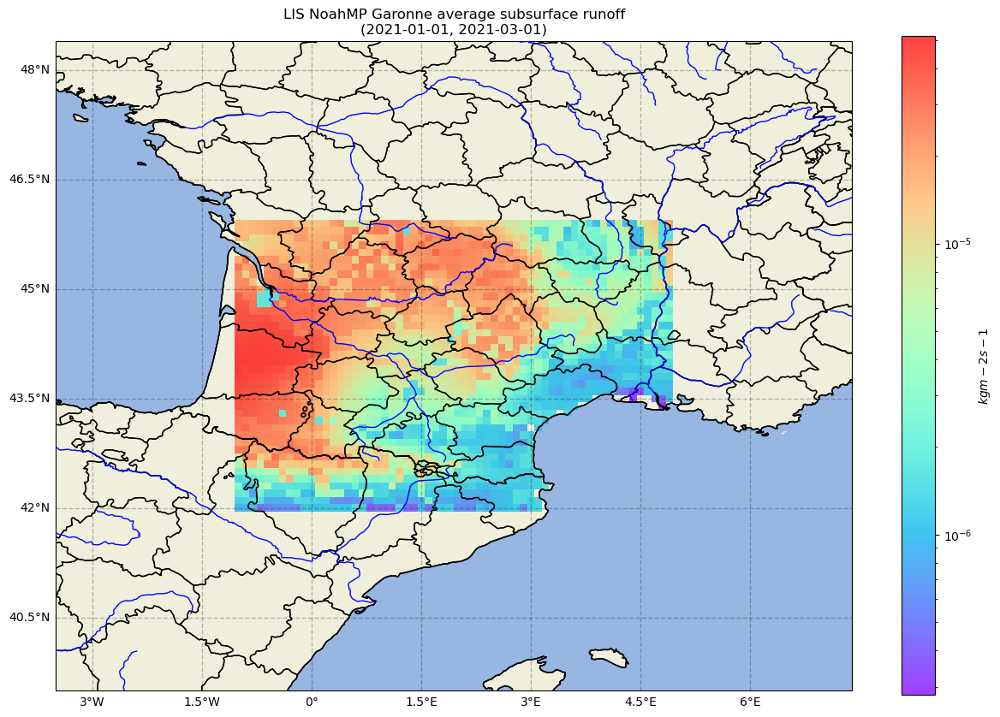

In [112]:
plotting.map_data(lis_noahmp_gar_tavg[0], 'LIS NoahMP Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2 s-1$', log_scale=True)
plotting.map_data(lis_noahmp_gar_tavg[1], 'LIS NoahMP Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2 s-1$', log_scale=True)

## LIS VIC Runoff and GPM Precipitation

In [113]:
gar_lis_vic_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [114]:
gar_lis_vic_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_vic_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.5702558750053868 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.242255917051807 seconds


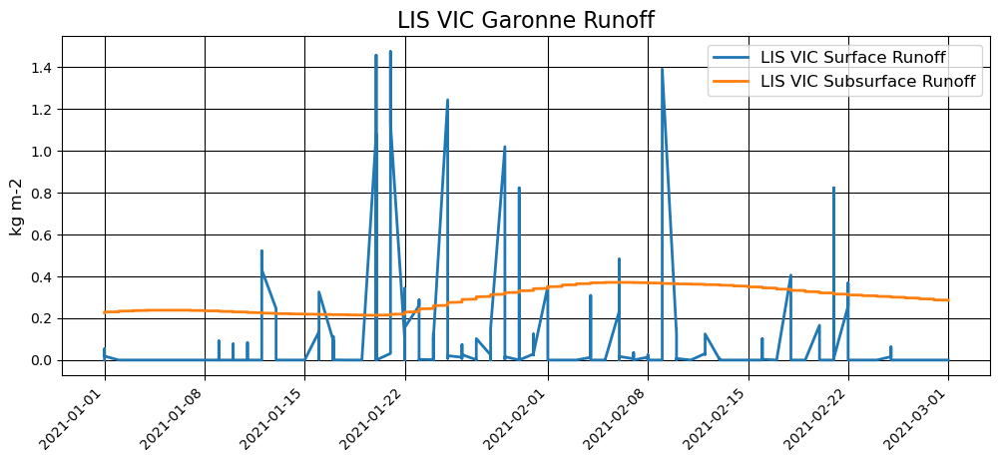

In [115]:
plotting.timeseries_plot([(gar_lis_vic_ts[0]['mean'], 'LIS VIC Surface Runoff', 'tab:blue'), (gar_lis_vic_ts[1]['mean'], 'LIS VIC Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS VIC Garonne Runoff')

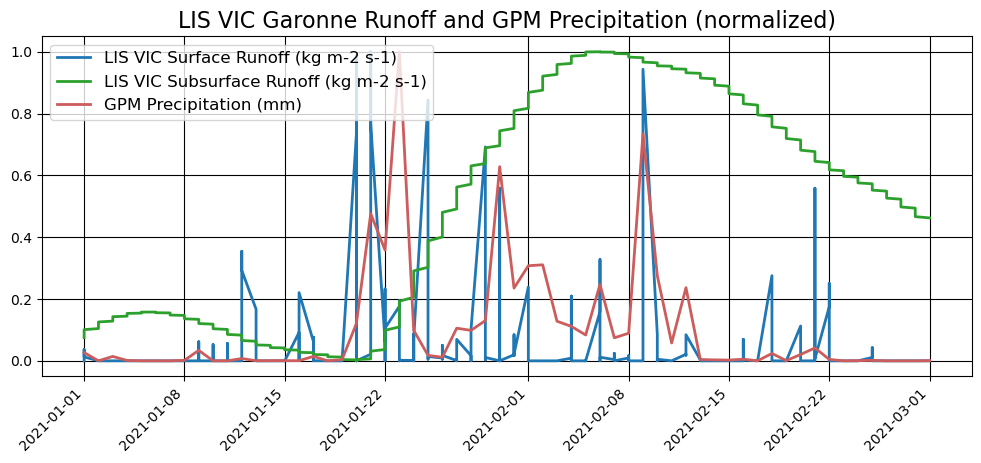

In [116]:
plotting.timeseries_plot([(gar_lis_vic_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_vic_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS VIC Full Basin

In [117]:
gar_lis_vic_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [118]:
lis_vic_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_vic_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 2.5899676250992343 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 8.885757916956209 seconds


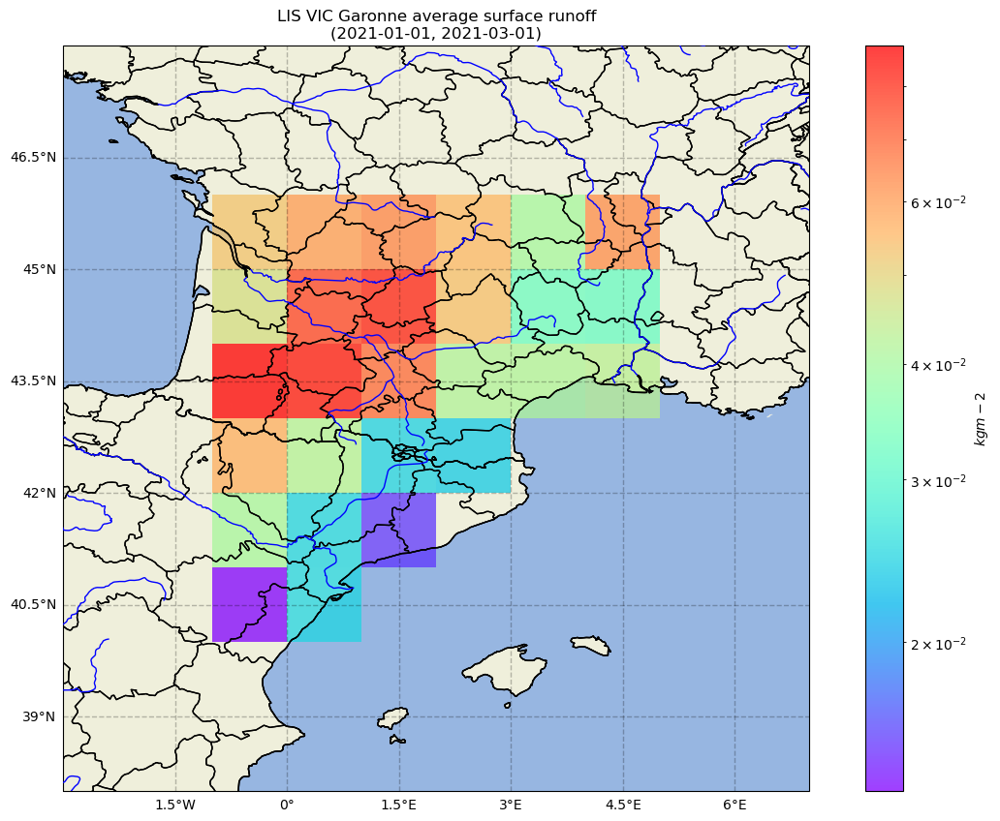

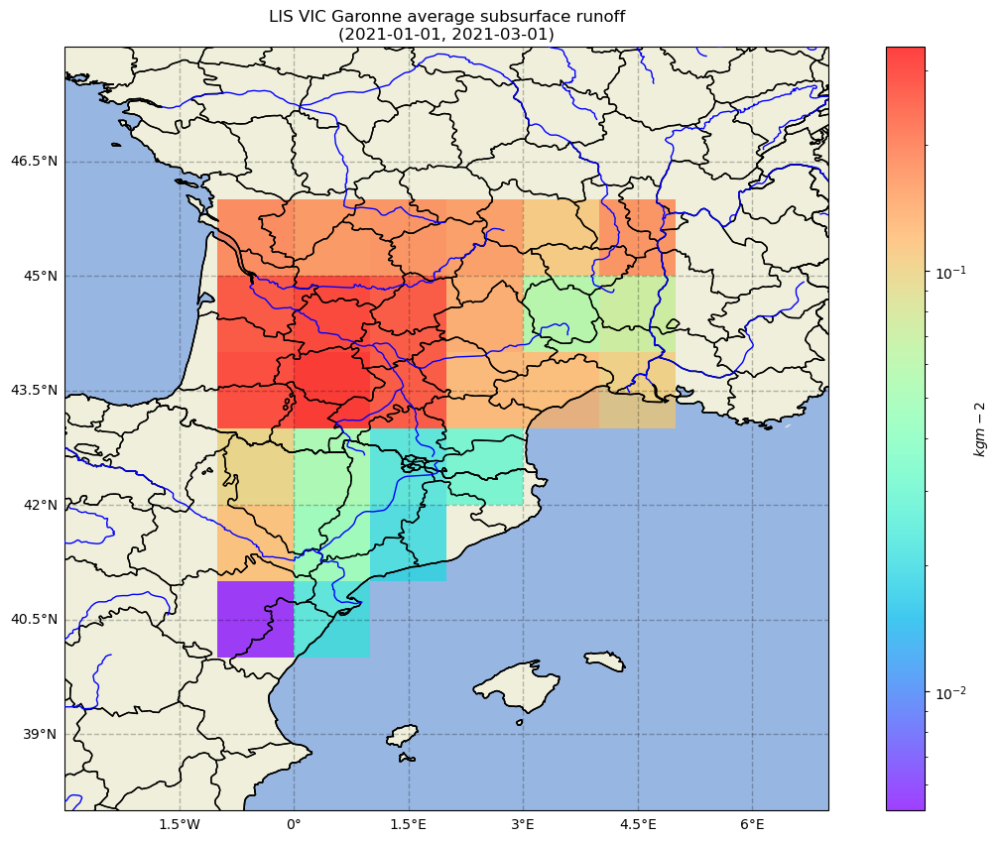

In [119]:
plotting.map_data(lis_vic_gar_tavg[0], 'LIS VIC Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_vic_gar_tavg[1], 'LIS VIC Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

## LIS NOAH Runoff and GPM Precipitation

In [120]:
gar_lis_noah_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_NOAH10_3H_2_1_global_Qs_acc', 'GLDAS_NOAH10_3H_2_1_global_Qsb_acc']]

In [121]:
gar_lis_noah_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_noah_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.5088849590392783 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.9896517921006307 seconds


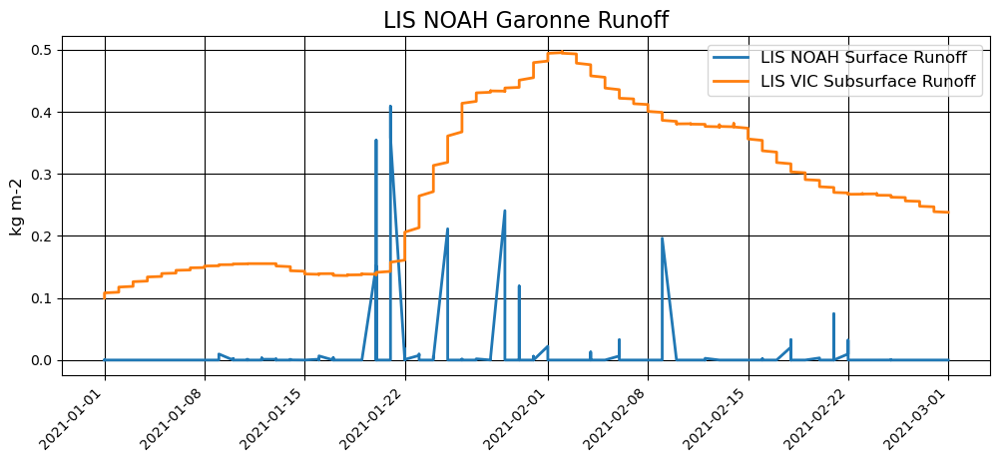

In [122]:
plotting.timeseries_plot([(gar_lis_noah_ts[0]['mean'], 'LIS NOAH Surface Runoff', 'tab:blue'), (gar_lis_noah_ts[1]['mean'], 'LIS VIC Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS NOAH Garonne Runoff')

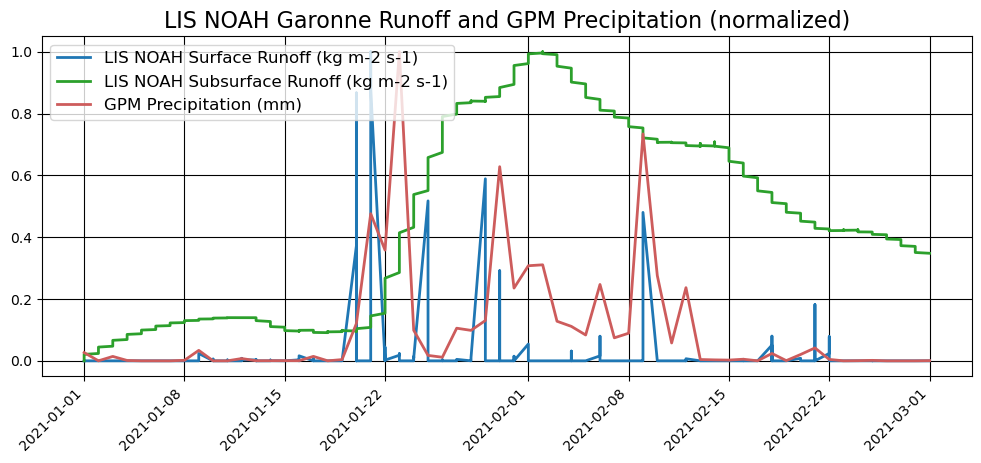

In [123]:
plotting.timeseries_plot([(gar_lis_noah_ts[0]['mean'], 'LIS NOAH Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noah_ts[1]['mean'], 'LIS NOAH Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NOAH Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS NOAH Full Basin

In [124]:
gar_lis_noah_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_NOAH10_3H_2_1_global_Qs_acc', 'GLDAS_NOAH10_3H_2_1_global_Qsb_acc']]

In [125]:
lis_noah_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_noah_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 3.2535289579536766 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.3126915419707075 seconds


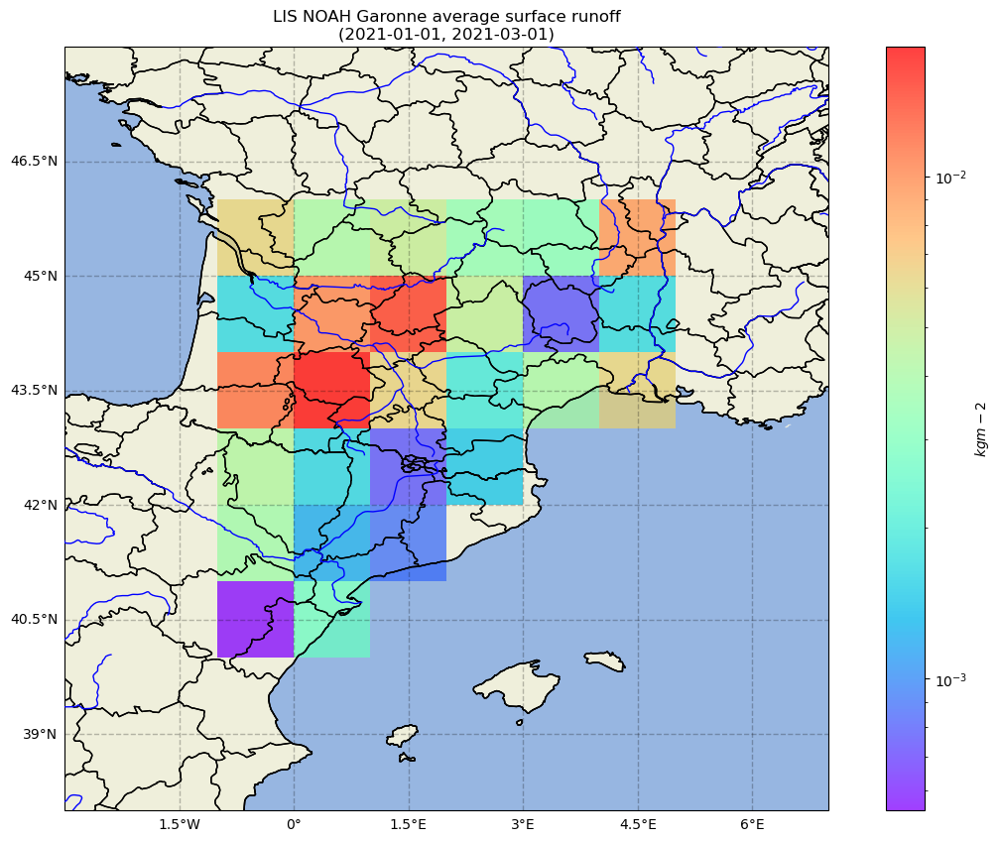

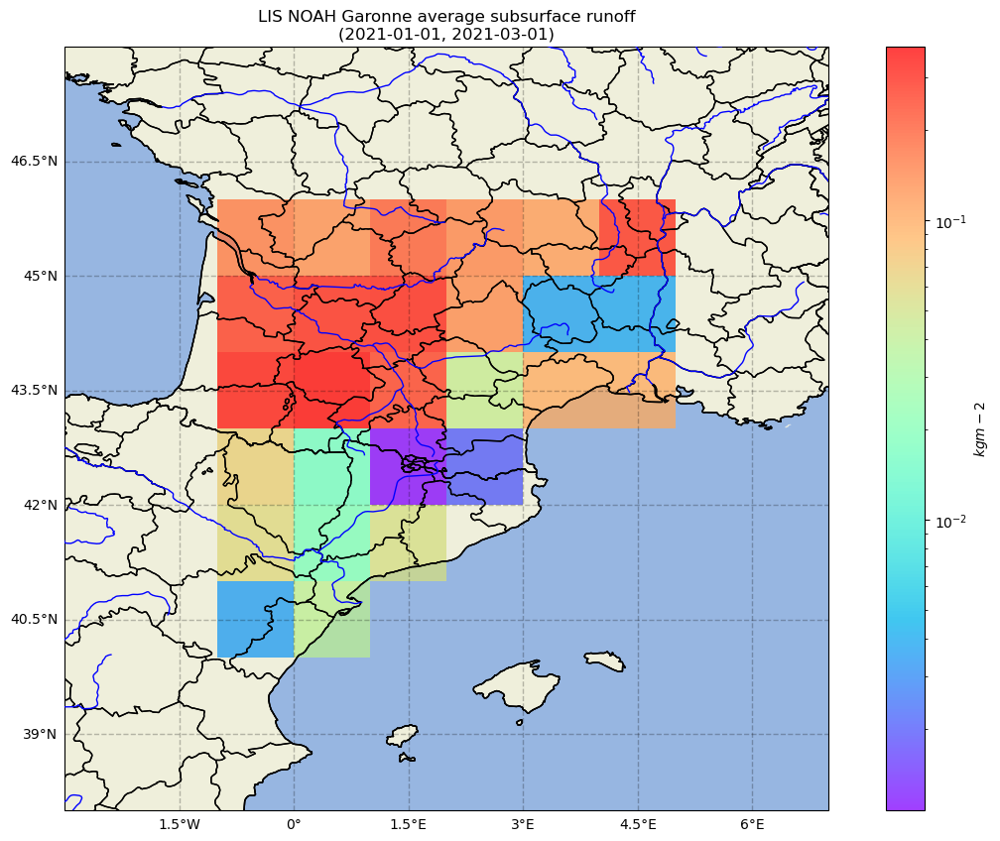

In [126]:
plotting.map_data(lis_noah_gar_tavg[0], 'LIS NOAH Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_noah_gar_tavg[1], 'LIS NOAH Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

## LIS CLSM Runoff and GPM Precipitation

In [127]:
gar_lis_clsm_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_CLSM10_3H_2_1_global_Qs_acc', 'GLDAS_CLSM10_3H_2_1_global_Qsb_acc']]

In [128]:
gar_lis_clsm_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_clsm_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.2097659590654075 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1467966249911115 seconds


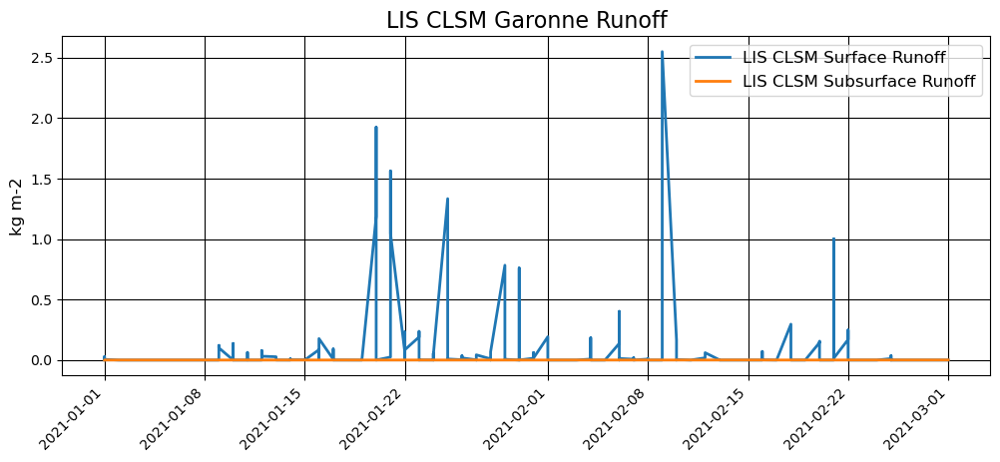

In [129]:
plotting.timeseries_plot([(gar_lis_clsm_ts[0]['mean'], 'LIS CLSM Surface Runoff', 'tab:blue'), (gar_lis_clsm_ts[1]['mean'], 'LIS CLSM Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS CLSM Garonne Runoff')

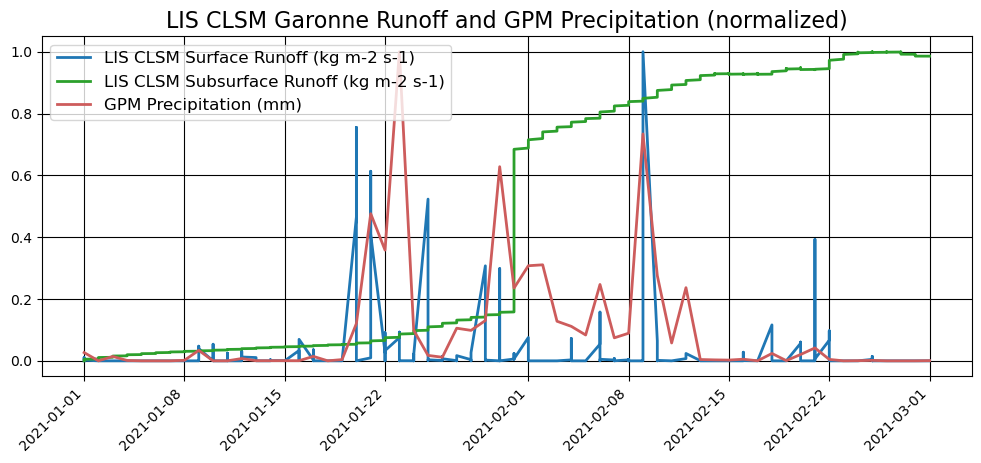

In [130]:
plotting.timeseries_plot([(gar_lis_clsm_ts[0]['mean'], 'LIS CLSM Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_clsm_ts[1]['mean'], 'LIS CLSM Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS CLSM Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS VIC Full Basin

In [131]:
gar_lis_clsm_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_CLSM10_3H_2_1_global_Qs_acc', 'GLDAS_CLSM10_3H_2_1_global_Qsb_acc']]

In [132]:
lis_clsm_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_clsm_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.2284946660511196 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.3656291250372306 seconds


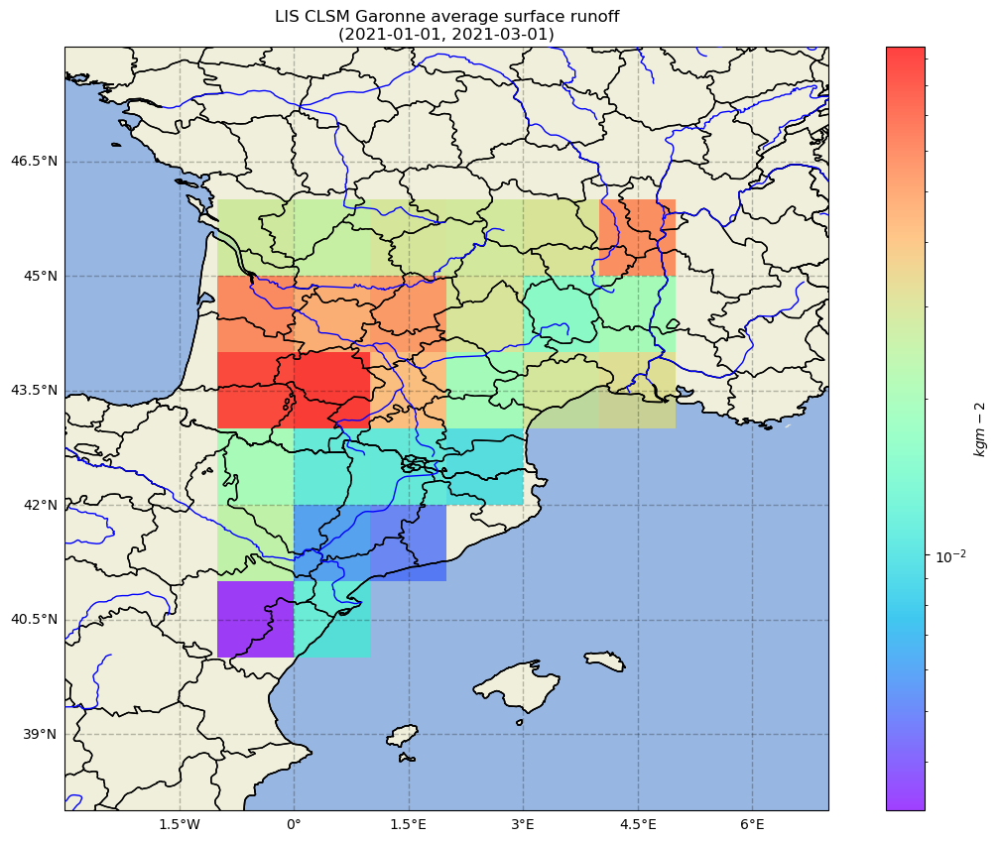

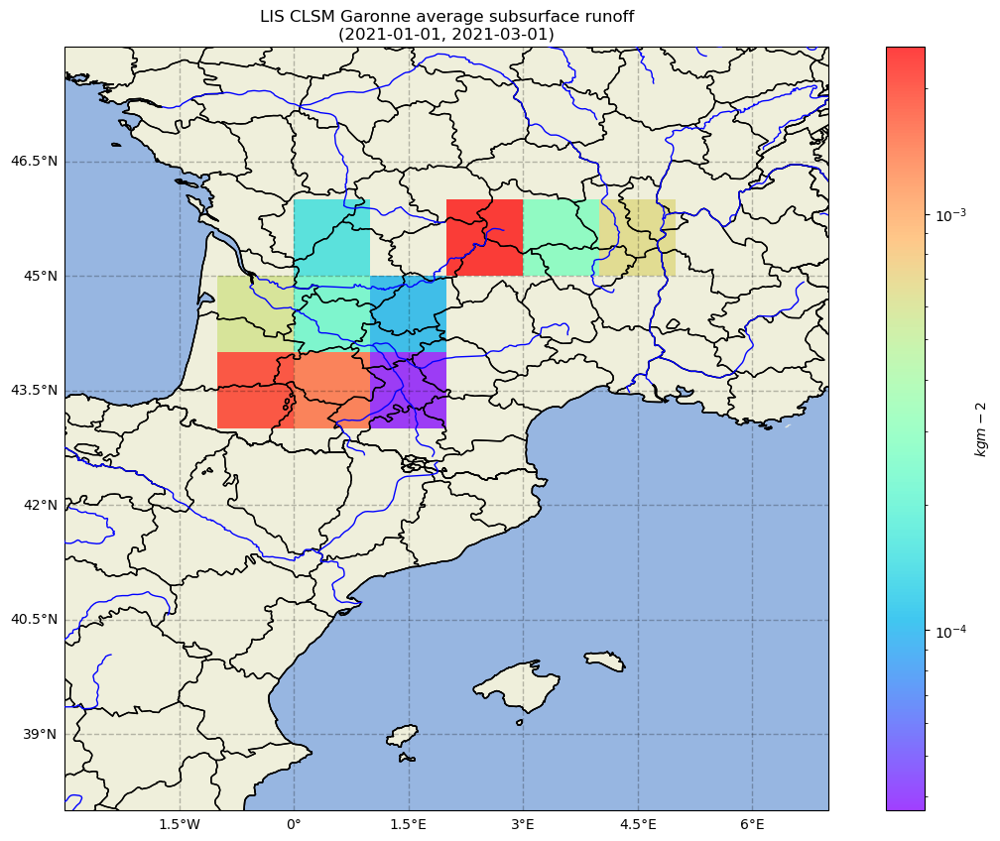

In [133]:
plotting.map_data(lis_clsm_gar_tavg[0], 'LIS CLSM Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_clsm_gar_tavg[1], 'LIS CLSM Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

# RAPID Discharge 2021-03 through 2021-12 in Garonne

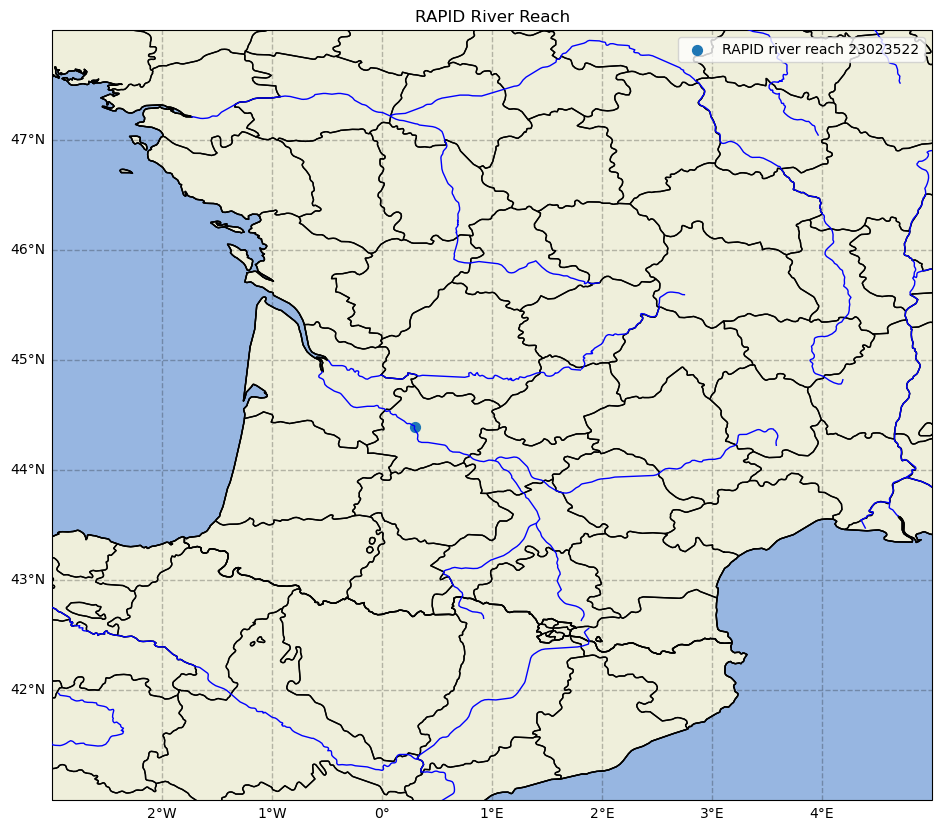

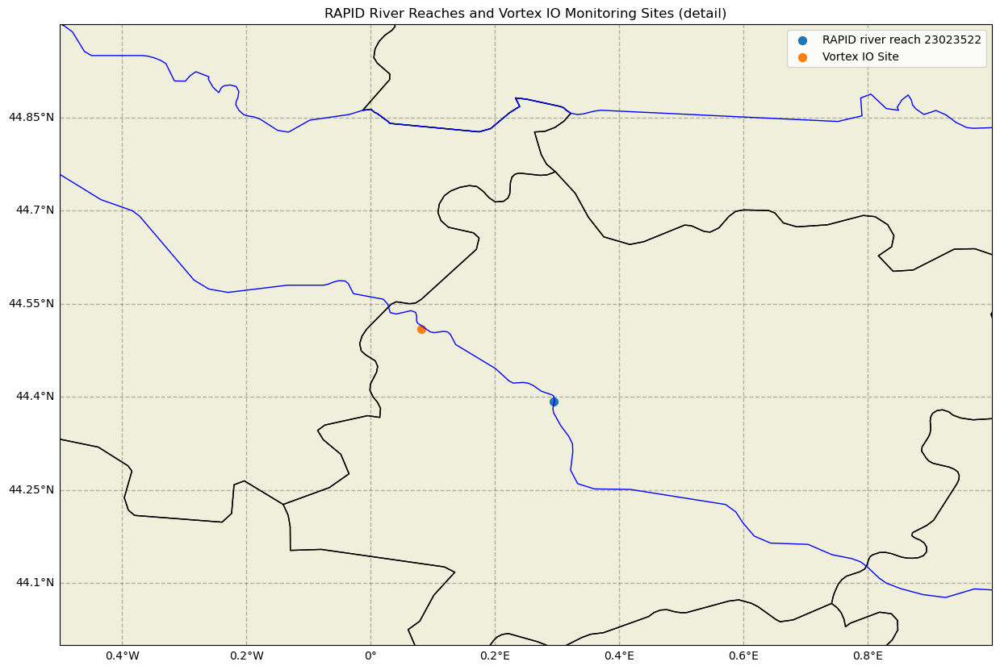

In [134]:
points = [
    (44.3917, 0.295, 'RAPID river reach 23023522')
]
plotting.map_points(points, 'gar', 'RAPID River Reach')
points.extend([(44.509687, 0.081479, 'Vortex IO Site')])
plotting.map_points(points, 'gar', 'RAPID River Reaches and Vortex IO Monitoring Sites (detail)', True)

In [135]:
rapid_lis_noahmp_gar_params = (NEXUS_URL, 'RAPID_LIS_1x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_vic_gar_params = (NEXUS_URL, 'RAPID_VIC_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_noah_gar_params = (NEXUS_URL, 'RAPID_NOAH_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_clsm_gar_params = (NEXUS_URL, 'RAPID_CLSM_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
vortex_params = (NEXUS_URL, 'vortex-io', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))

In [136]:
rapid_lis_noahmp_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_gar_params)
rapid_vic_gar_df = ideas_processing.insitu(*rapid_vic_gar_params)
rapid_noah_gar_df = ideas_processing.insitu(*rapid_noah_gar_params)
rapid_clsm_gar_df = ideas_processing.insitu(*rapid_clsm_gar_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-30T00:00:00Z&markerPlatform=e4ed9b2c37ac146f47f321b00c1cc21526ce602df2ca196f6d8f95bc55a0f7ea
https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Garonne&project=IDEAS&startTime=202

In [137]:
vortex_gar_df = ideas_processing.insitu(*vortex_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-06T23:30:14Z&markerPlatform=655779e0270fc9b6d62206aa1a556ce204ef490731a40c646d62d676aebd81f0
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-30T23:30:15Z&markerPlatform=a2c8020ca1b007d00e9a75e5221c7e2317485facebb0f694352707749bd50467


In [138]:
rapid_lis_noahmp_gar_site_df = rapid_lis_noahmp_gar_df[rapid_lis_noahmp_gar_df['platform_id'] == '23023522']
rapid_vic_gar_site_df = rapid_vic_gar_df[rapid_vic_gar_df['platform_id'] == '23023522']
rapid_noah_gar_site_df = rapid_noah_gar_df[rapid_noah_gar_df['platform_id'] == '23023522']
rapid_clsm_gar_site_df = rapid_clsm_gar_df[rapid_clsm_gar_df['platform_id'] == '23023522']
vortex_gar_site_df = vortex_gar_df[vortex_gar_df['platform_id'] == 'couthures-sur-garonne_1']

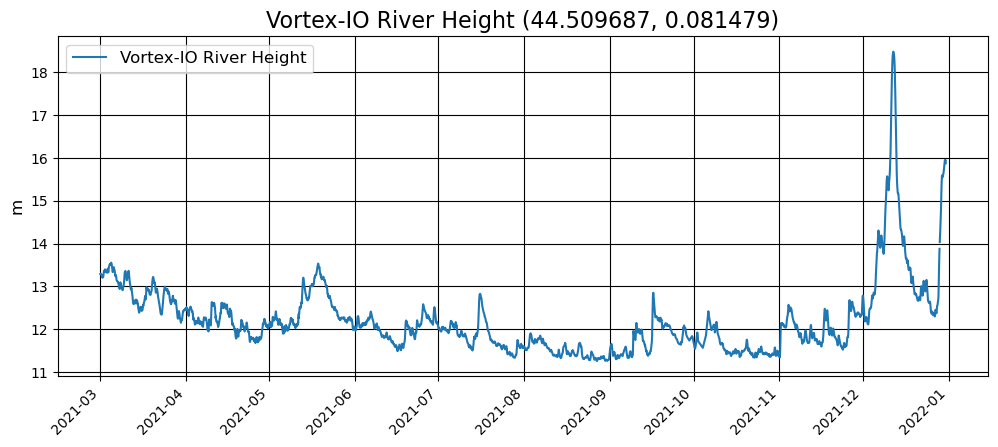

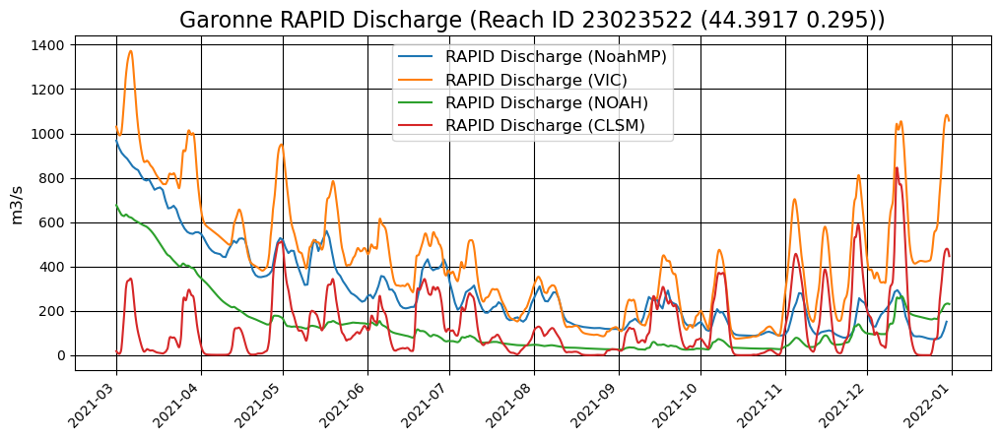

In [139]:
plotting.plot_insitu([(vortex_gar_site_df.where(vortex_gar_site_df['vortex_height']!= 0, np.nan), 'vortex_height', 'Vortex-IO River Height')], 'Vortex-IO River Height (44.509687, 0.081479)', 'm')
plotting.plot_insitu([
                      (rapid_lis_noahmp_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP)'),
                      (rapid_vic_gar_site_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_gar_site_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_gar_site_df, 'Qout', 'RAPID Discharge (CLSM)')
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917 0.295))')

### Normalized Comparison

In [140]:
rapid_lis_noahmp_gar_site_subset_df = rapid_lis_noahmp_gar_site_df[rapid_lis_noahmp_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_vic_gar_site_subset_df = rapid_vic_gar_site_df[rapid_vic_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_noah_gar_site_subset_df = rapid_noah_gar_site_df[rapid_noah_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_clsm_gar_site_subset_df = rapid_clsm_gar_site_df[rapid_clsm_gar_site_df['time'] >= np.datetime64('2021-11-10')]
vortex_gar_site_subset_df = vortex_gar_site_df[vortex_gar_site_df['time'] >= np.datetime64('2021-11-10')]

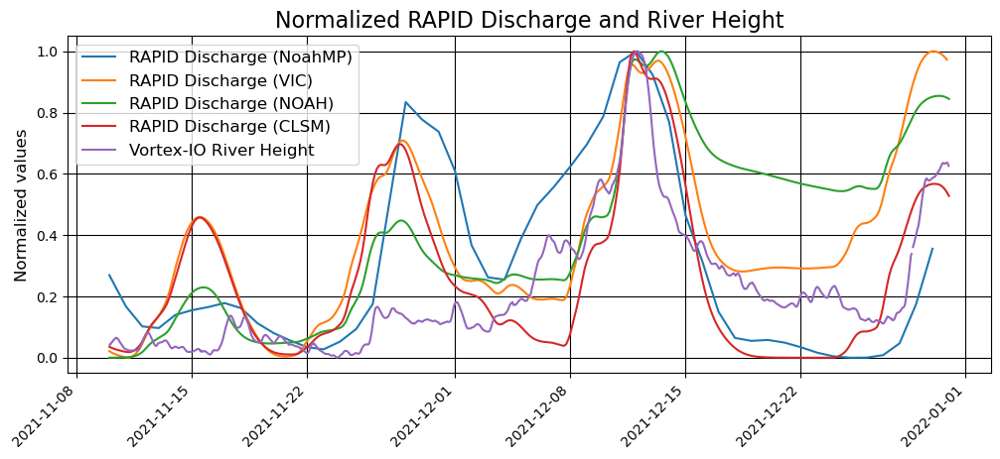

In [141]:
plotting.plot_insitu([
                      (rapid_lis_noahmp_gar_site_subset_df, 'Qout', 'RAPID Discharge (NoahMP)'),
                      (rapid_vic_gar_site_subset_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_gar_site_subset_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_gar_site_subset_df, 'Qout', 'RAPID Discharge (CLSM)'),
                      (vortex_gar_site_subset_df.where(vortex_gar_site_df['vortex_height']!= 0, np.nan), 'vortex_height', 'Vortex-IO River Height')
                      ], 'Normalized RAPID Discharge and River Height', norm=True)

# LIS NoahMP Scenarios

Three scenarios with different amounts of GDAS precipitation as input to LIS NoahMP. For each scenario we can perform spatial and temporal analysis of the LIS NoahMP data, as well as the resulting RAPID discharge data.

In [142]:
gar_bb = {'min_lon': -2, 'max_lon': 2, 'min_lat': 42, 'max_lat': 46}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 10, 1)

## Scenario 1, Nominal Precipitation

In [143]:
gar_lis_scenario_1_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]
gar_lis_scenario_1_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_1x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 7.182702583028004 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_1x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.2909114999929443 seconds


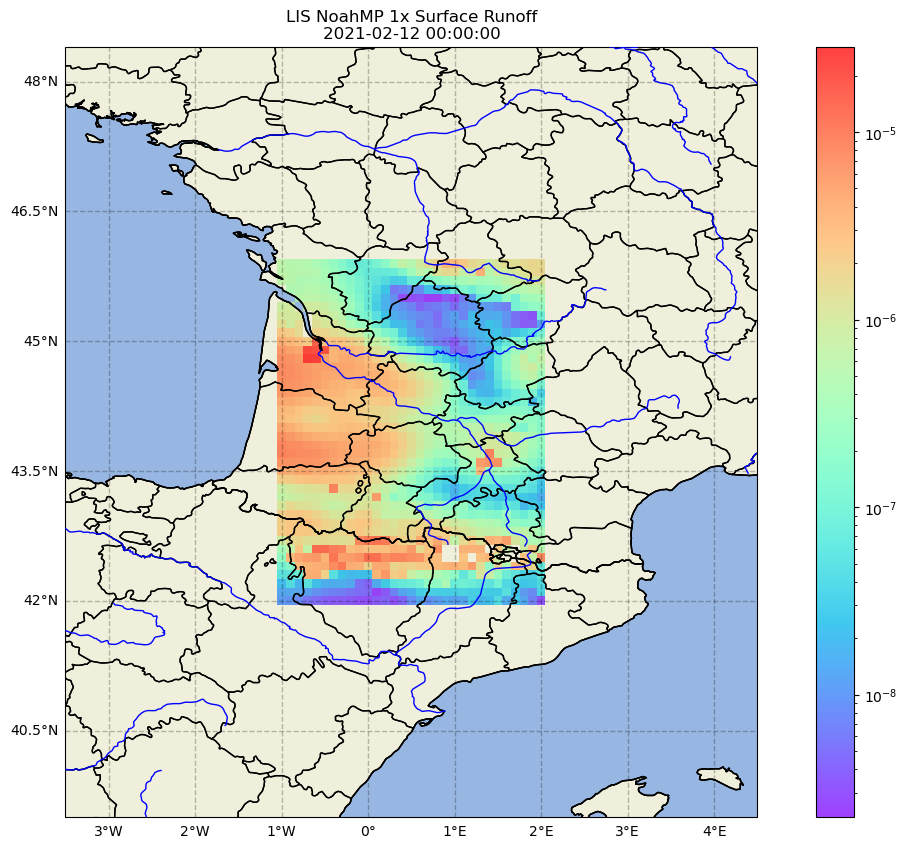

In [144]:
plotting.map_data(gar_lis_scenario_1_sub[0][11], f'LIS NoahMP 1x Surface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_1_sub[0][11].time.values)}', log_scale=True)

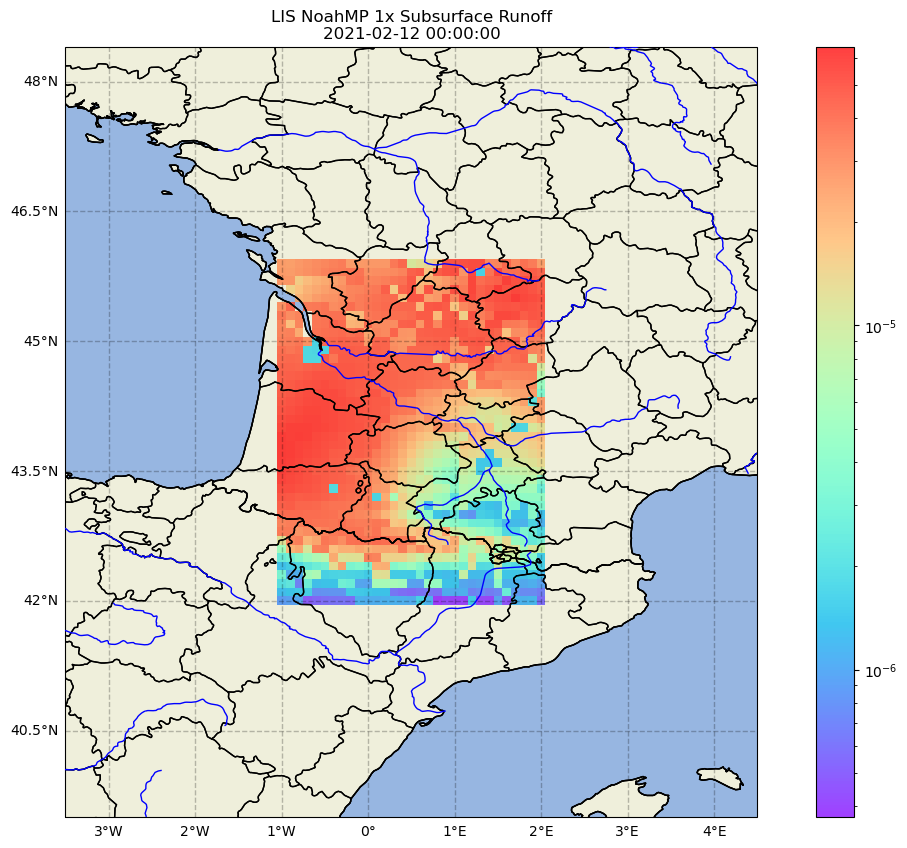

In [145]:
plotting.map_data(gar_lis_scenario_1_sub[1][11], f'LIS NoahMP 1x Subsurface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_1_sub[0][11].time.values)}', log_scale=True)

In [146]:
gar_lis_scenario_1_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]
gar_lis_scenario_1_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-01T00:00:00Z&endTime=2021-10-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.2355025419965386 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-01T00:00:00Z&endTime=2021-10-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.5111000000033528 seconds


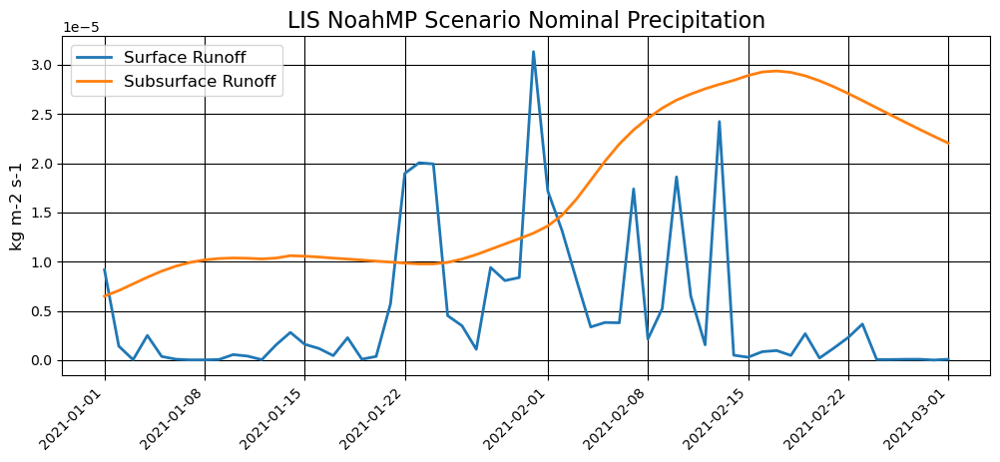

In [147]:
plotting.timeseries_plot([(gar_lis_scenario_1_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_1_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario Nominal Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=65801b8dd13c2dcd569f7d3c35734018b96bccac55e13c5dd1da4f199f1daa90


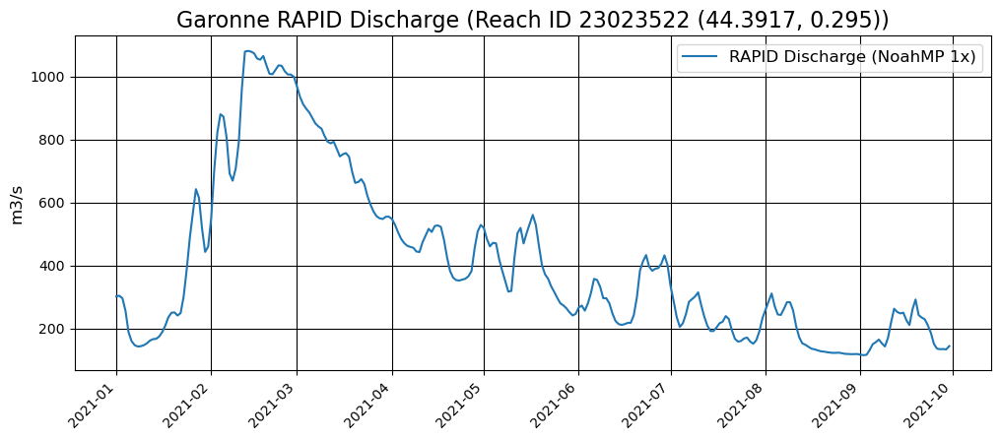

In [148]:
rapid_lis_noahmp_1x_gar_params = (NEXUS_URL, 'RAPID_LIS_1x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_1x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_1x_gar_params)
rapid_lis_noahmp_1x_gar_site_df = rapid_lis_noahmp_1x_gar_df[rapid_lis_noahmp_1x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_1x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 1x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

## Scenario 2, 2x Precipitation

In [149]:
gar_lis_scenario_2_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_gdas_2x_Qs_tavg', 'LIS_gar_gdas_2x_Qsb_tavg']]
gar_lis_scenario_2_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_2x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.9840663750655949 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_2x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.0232097919797525 seconds


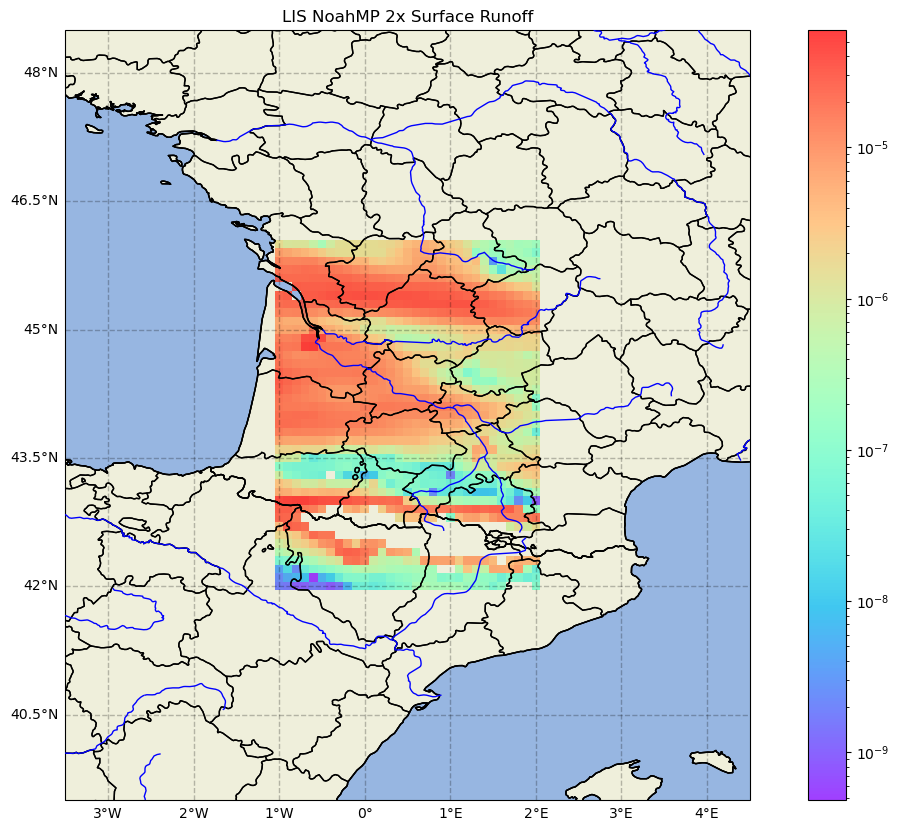

In [150]:
plotting.map_data(gar_lis_scenario_2_sub[0][11], 'LIS NoahMP 2x Surface Runoff', log_scale=True)

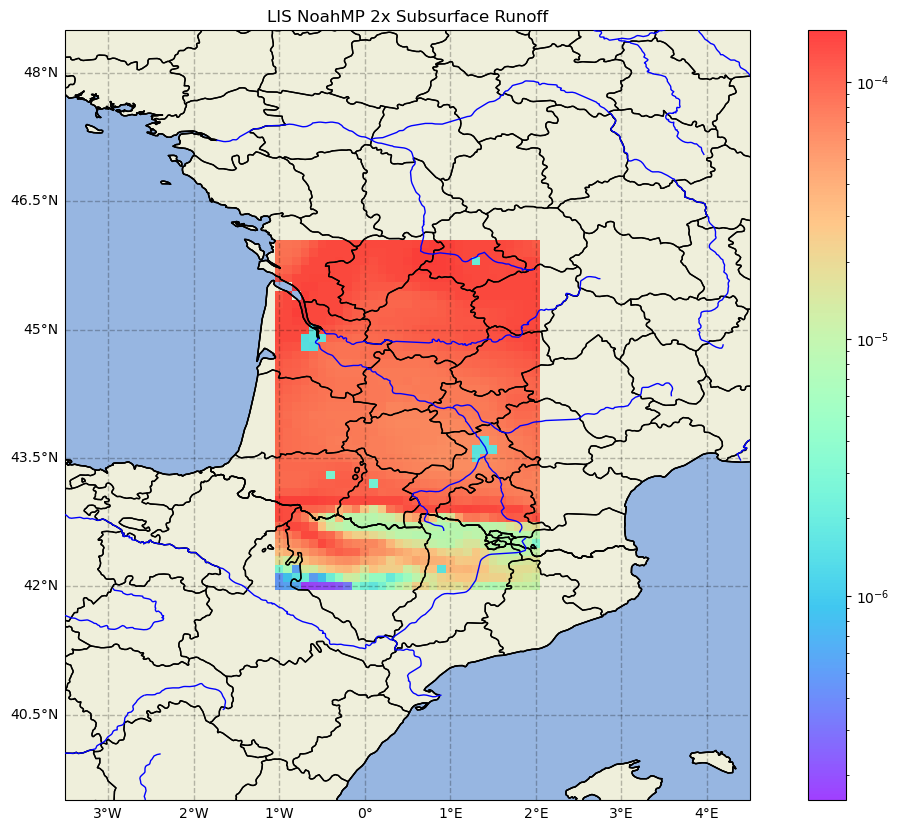

In [151]:
plotting.map_data(gar_lis_scenario_2_sub[1][11], 'LIS NoahMP 2x Subsurface Runoff', log_scale=True)

In [152]:
gar_lis_scenario_2_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_2x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.3469755419064313 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_2x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.28870299994014204 seconds


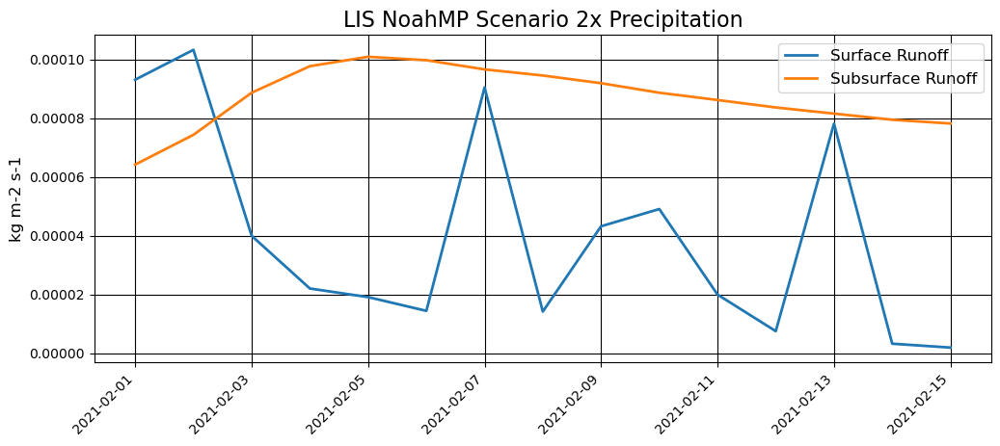

In [153]:
plotting.timeseries_plot([(gar_lis_scenario_2_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_2_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 2x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=3821925dac5a5d6dcb57e3ba55a95a6756d1f149b4a36c8c53c87495f969f59c


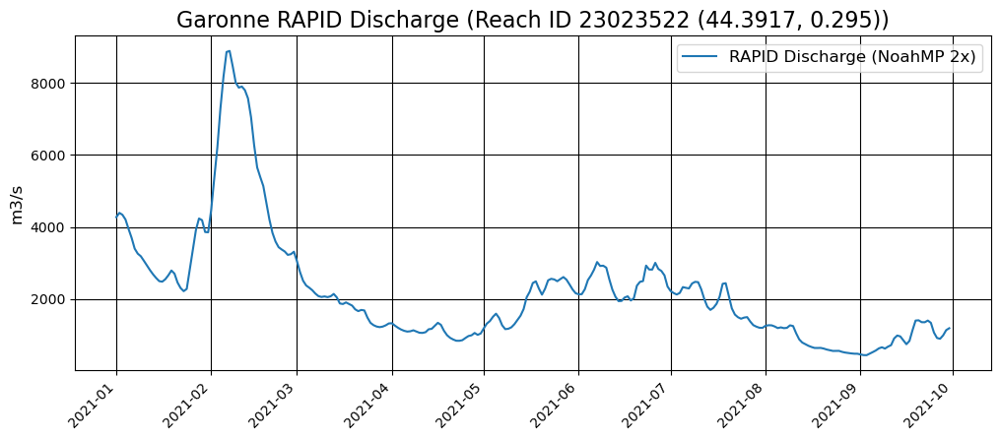

In [154]:
rapid_lis_noahmp_2x_gar_params = (NEXUS_URL, 'RAPID_LIS_2x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_2x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_2x_gar_params)
rapid_lis_noahmp_2x_gar_site_df = rapid_lis_noahmp_2x_gar_df[rapid_lis_noahmp_2x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_2x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 2x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

## Scenario 3, 3x Precipitation

In [155]:
gar_lis_scenario_3_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_gdas_3x_Qs_tavg', 'LIS_gar_gdas_3x_Qsb_tavg']]
gar_lis_scenario_3_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_3x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.116166791995056 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_3x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1313202499877661 seconds


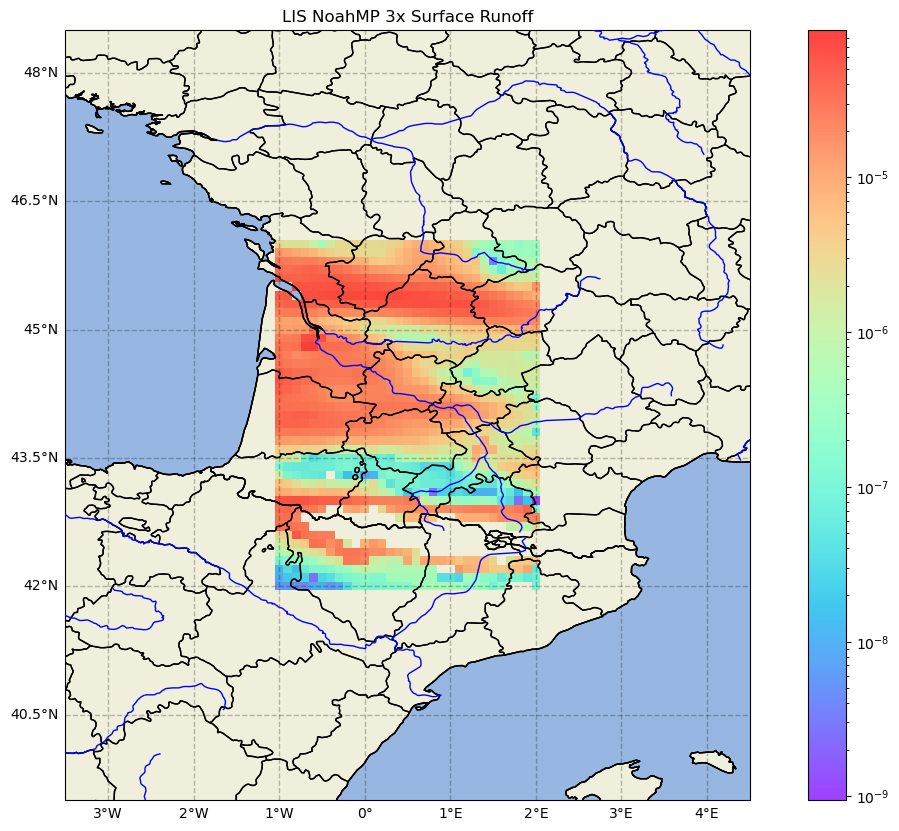

In [156]:
plotting.map_data(gar_lis_scenario_3_sub[0][11], 'LIS NoahMP 3x Surface Runoff', log_scale=True)

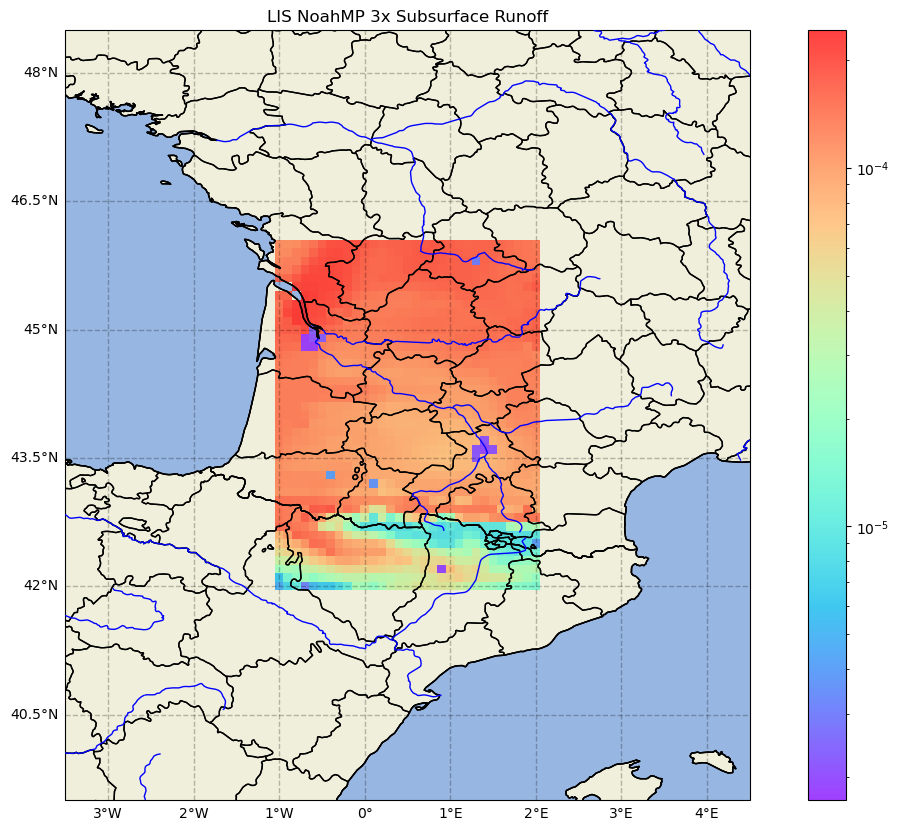

In [157]:
plotting.map_data(gar_lis_scenario_3_sub[1][11], 'LIS NoahMP 3x Subsurface Runoff', log_scale=True)

In [158]:
gar_lis_scenario_3_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_3x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.29402145906351507 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_3x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.20801762503106147 seconds


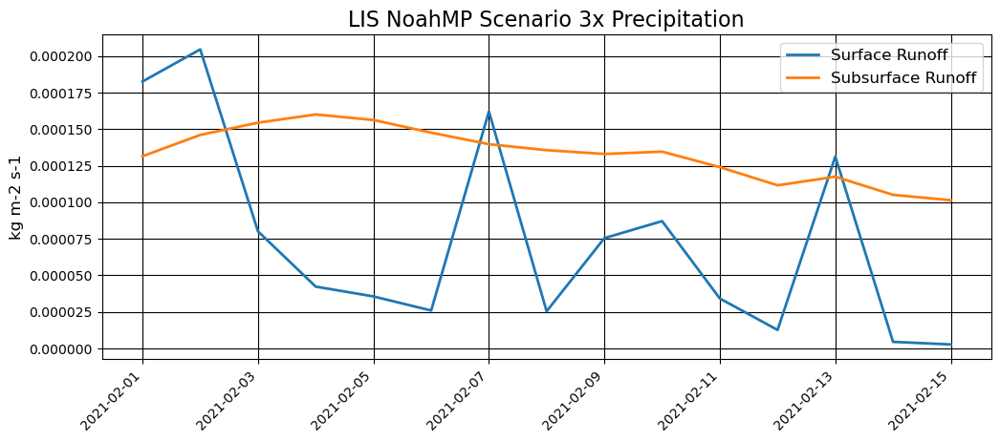

In [159]:
plotting.timeseries_plot([(gar_lis_scenario_3_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_3_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 3x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=19b2312e2c3ef035a2e6da31f013cdd2e3fc4ee04b84d9639a636538abe8d5a8


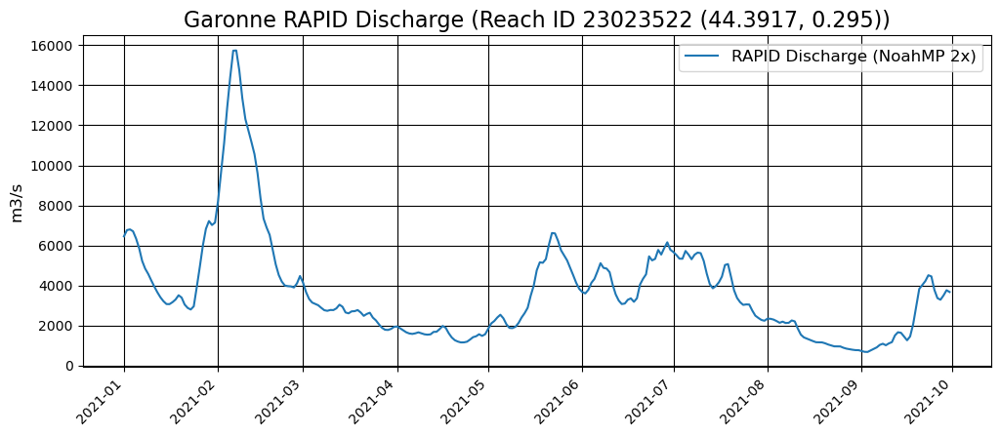

In [160]:
rapid_lis_noahmp_3x_gar_params = (NEXUS_URL, 'RAPID_LIS_3x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_3x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_3x_gar_params)
rapid_lis_noahmp_3x_gar_site_df = rapid_lis_noahmp_3x_gar_df[rapid_lis_noahmp_3x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_3x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 2x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

# LIS NoahMP Soil Evaporation

In [161]:
global_precipitation_dataset  = 'GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed'
soil_dataset = 'LIS-ESoil-tavg'
soil_bb      = {'min_lon': -94.5, 'max_lon': -88, 'min_lat': 29, 'max_lat': 38}
soil_start   = datetime(2020, 1, 1)
soil_end     = datetime(2020, 1, 31)
lis_noahmp_evap_parameters = (NEXUS_URL, soil_dataset, soil_bb, soil_start, soil_end)
lis_noahmp_rain_parameters = (NEXUS_URL, global_precipitation_dataset, soil_bb, soil_start, soil_end)

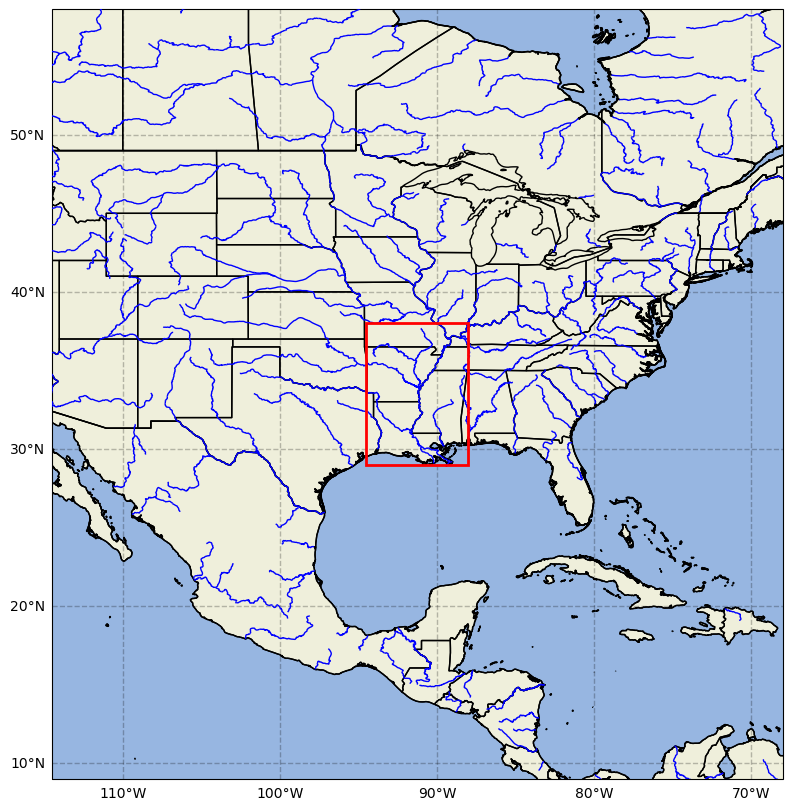

In [162]:
plotting.map_box(soil_bb)

#### Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

In [163]:
lis_noahmp_evap_timeseries = ideas_processing.spatial_timeseries(*lis_noahmp_evap_parameters)
lis_noahmp_rain_timeseries = ideas_processing.spatial_timeseries(*lis_noahmp_rain_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS-ESoil-tavg&minLon=-94.5&minLat=29&maxLon=-88&maxLat=38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 8.14263433299493 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&minLon=-94.5&minLat=29&maxLon=-88&maxLat=38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.516937250038609 seconds


#### Precipitation Time Series 2020-1-1 to 2020-01-31

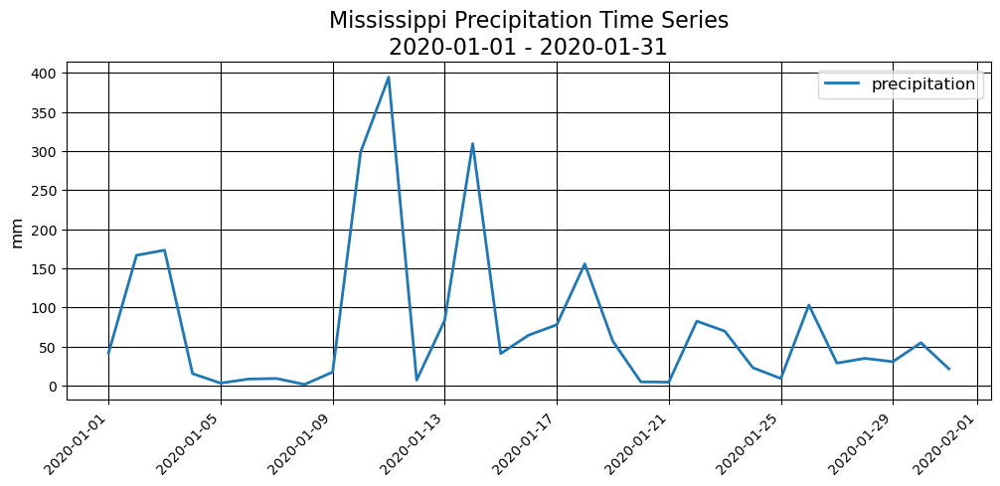

In [164]:
lis_noahmp_title = f'Mississippi Precipitation Time Series\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.timeseries_plot([(lis_noahmp_rain_timeseries['maximum'], 'precipitation')], '', 'mm', title=lis_noahmp_title, norm=False)

#### Normalized Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

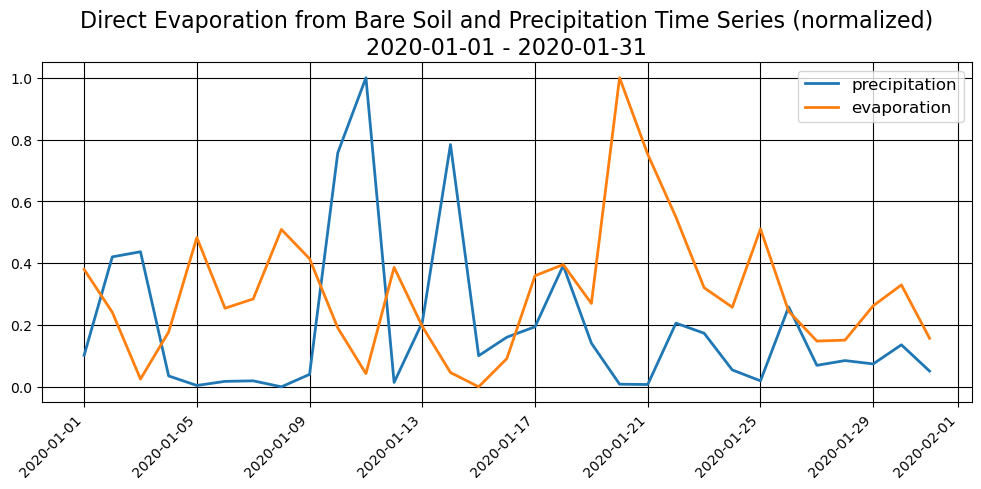

In [165]:
lis_noahmp_title = f'Direct Evaporation from Bare Soil and Precipitation Time Series (normalized)\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.timeseries_plot([(lis_noahmp_rain_timeseries['maximum'], 'precipitation'), (lis_noahmp_evap_timeseries['maximum'], 'evaporation')], '', '', title=lis_noahmp_title, norm=True)

#### Temporal Average of Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

In [166]:
miss_rain_timeavg = ideas_processing.temporal_mean(*lis_noahmp_rain_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 2.938448084052652 seconds


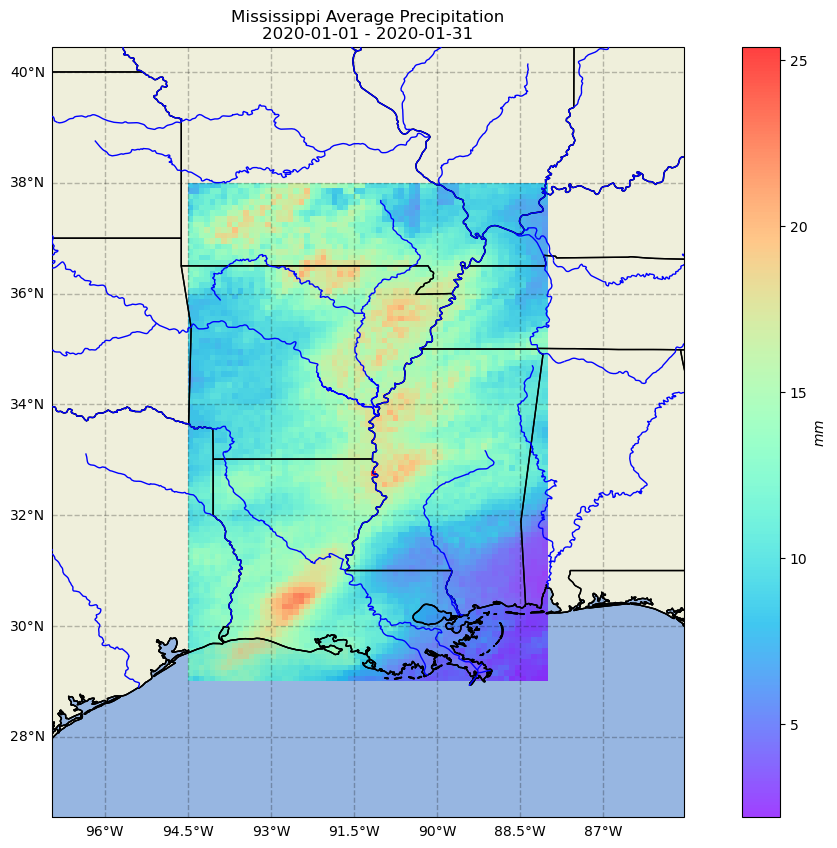

In [167]:
plotting.map_data(miss_rain_timeavg, f'Mississippi Average Precipitation\n{str(soil_start)[:10]} - {str(soil_end)[:10]}', cb_label='$mm$')

In [168]:
lis_noahmp_timeavg = ideas_processing.temporal_mean(*lis_noahmp_evap_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS-ESoil-tavg&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 1.4553777500987053 seconds


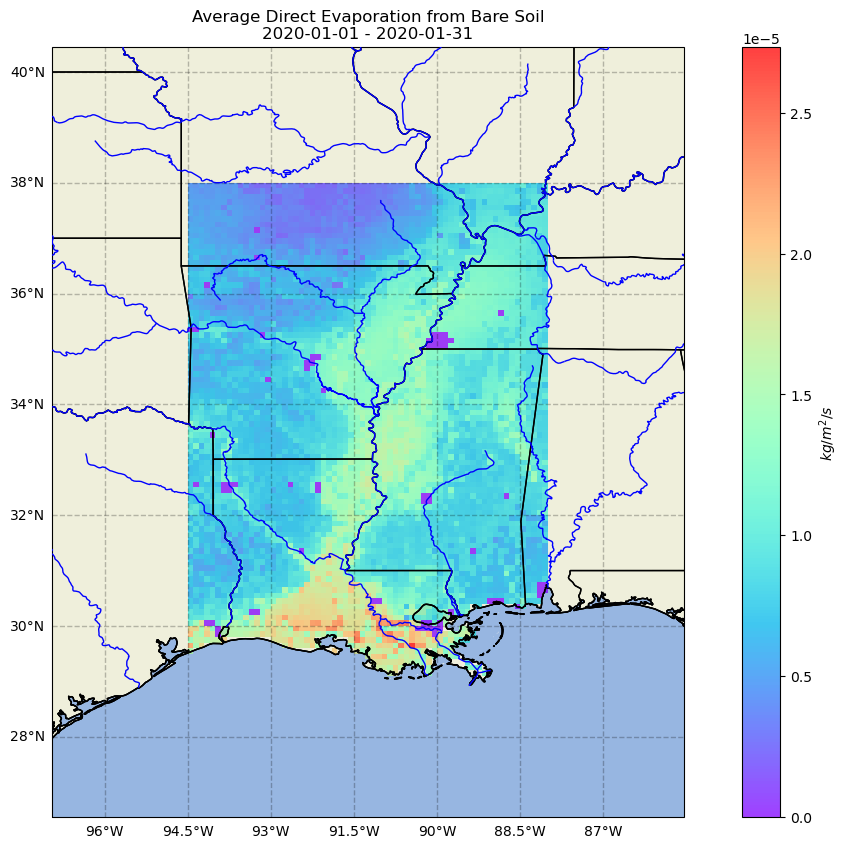

In [169]:
soil_title = f'Average Direct Evaporation from Bare Soil\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.map_data(lis_noahmp_timeavg, soil_title, cb_label='$kg/m^2/s$')

#### Latitude Time Hovmöller Analysis

In [170]:
mis_evap_lat_hof = ideas_processing.hofmoeller(*lis_noahmp_evap_parameters, dim='latitude')
mis_rain_lat_hof = ideas_processing.hofmoeller(*lis_noahmp_rain_parameters, dim='latitude')

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/latitudeTimeHofMoellerSpark?ds=LIS-ESoil-tavg&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 2.5712474579922855 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/latitudeTimeHofMoellerSpark?ds=GPM-3IMERGHHR-06-daily-global-precipitationCal_transposed&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 2.4542295000283048 seconds


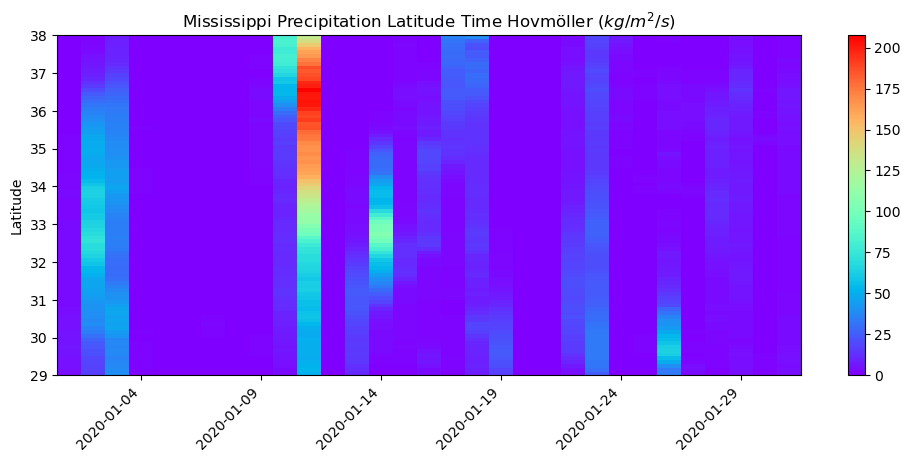

In [171]:
mis_rain_hof_title = 'Mississippi Precipitation Latitude Time Hovmöller ($kg/m^2/s$)'
plotting.heatmap(mis_rain_lat_hof['mean'].transpose(), '', 'Latitude', mis_rain_hof_title)

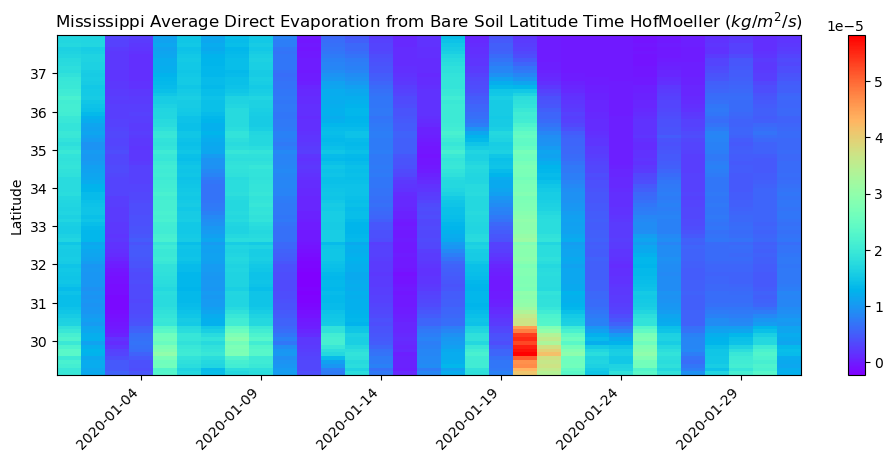

In [172]:
mis_evap_hof_title = 'Mississippi Average Direct Evaporation from Bare Soil Latitude Time HofMoeller ($kg/m^2/s$)'
plotting.heatmap(mis_evap_lat_hof['mean'].transpose(), '', 'Latitude', mis_evap_hof_title)

#### IDEAS WMS Visual 2020-01-20

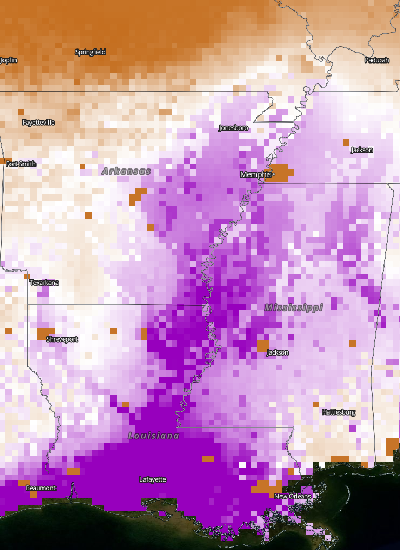

In [173]:
# Connect to IDEAS WMS Service
wms = WebMapService('https://ideas-digitaltwin.jpl.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'LIS_HIST_ESoil_tavg',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(-94.5,29,-88,38),  # Bounds
                 size=(400, 550),  # Image size
                 time='2020-01-20',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('LIS_HIST_ESoil_tavg_2020-01-20.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('LIS_HIST_ESoil_tavg_2020-01-20.png')

#### IDEAS WMS Animation 2020-01-01 to 2020-01-31

In [174]:
wms = WebMapService('https://ideas-digitaltwin.jpl.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['BlueMarble_NextGeneration',
          'LIS_HIST_ESoil_tavg',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2020, 1, 1)
edate = datetime(2020, 2, 1)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(-94.5,29,-88,38),  # Bounds
                     size=(400, 550),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'LIS NoahMP ESoil Avg   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('LIS_HIST_ESoil_tavg.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

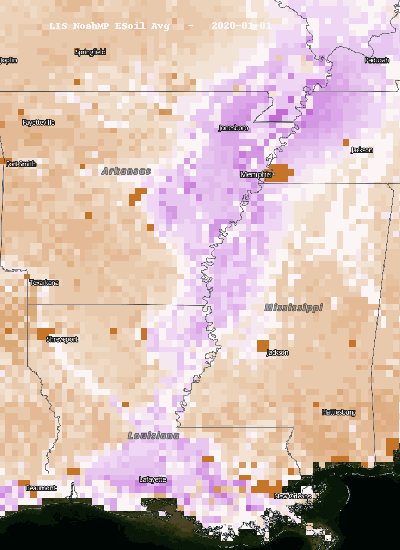

In [175]:
Image('LIS_HIST_ESoil_tavg.gif')